## importing and setup

In [ ]:
# This code has been built starting with the code found in this paper:: Anderson, S. and Radić, V.: Evaluation and interpretation of convolutional
# >> long short-term memory networks for regional hydrological modelling, Hydrol. Earth Syst. Sci., 26, 795–825, https://doi.org/10.5194/hess-26-795-2022, 2022.
# The code has been substantially changed to fit the purposes of our study, but some of the important functions and (clustering, finetuning, part of the visualization) have been adopted and modifed to fit the need of this study
# This note book present the complete work flow for my thesis and present the results
# My Drive/
# |__ Colab Notebooks/
#     |__ cnn_lstm_era/
#         |__ data/
#         |__ models/
#         |__ output/
#         |__ heat_maps/

dir_data = '/content/drive/My Drive/Colab Notebooks/cnn_lstm_era/data' #where to store data
dir_models = '/content/drive/My Drive/Colab Notebooks/cnn_lstm_era/models' #where to save trained models
dir_output = '/content/drive/My Drive/Colab Notebooks/cnn_lstm_era/output' #where to save trained model outputs
dir_heat = '/content/drive/My Drive/Colab Notebooks/cnn_lstm_era/heat_maps' #where to save heatmaps

In [ ]:

##download required libraries which are not in colab
#!pip install pandas==1.0.0
!pip install geopandas
!pip install netCDF4
!pip install guppy3
!pip install rasterio


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 323.6/323.6 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.9/23.9 MB 74.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.2/9.2 MB 92.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 74.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 51.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.4/645.4 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 86.1 MB/s eta 0:00:00


In [ ]:

#import required libraries
from keras.callbacks import ModelCheckpoint
from keras.layers import Reshape

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense

#%tensorflow_version 2.x
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import Model, Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, TimeDistributed, LSTM, Dense, Dropout, GlobalMaxPooling2D
from tensorflow.keras.callbacks import EarlyStopping

import seaborn as sns
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import cm
#from mpl_toolkits.axes_grid.inset_locator import inset_axes, InsetPosition

import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns

from scipy import interpolate
from scipy.stats import ks_2samp, pearsonr
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.linear_model import LinearRegression

import pickle
import os
from random import seed
from datetime import datetime, date
from netCDF4 import Dataset
from guppy import hpy
from google.colab import drive

#from shapely.geometry import Point, Polygon
#from descartes import PolygonPatch
from pyproj import Transformer
from pyproj import Proj, transform
import rasterio

In [ ]:
#mount google drive
drive.mount('/content/drive')

Mounted at /content/drive


## Define all the function that will be used  

In [ ]:
##########################
## plotting the stations with the HUC 17 unit
##########################
def plot_prov_ax(to_plot, ax):

  """
  function to plot HUC shape file after transofrming its projection

  INPUT: string name of HUC to plot '17'
  ax to plot in


  Examples:
  """

  #load shapefile of provincial boundaries

  shape_file_path ='/content/drive/MyDrive/Colab Notebooks/cnn_lstm_era/data/HUC_{}.shp'.format(to_plot)
  provshapes_filename = shape_file_path
  provshapes = gpd.read_file(provshapes_filename)




  #define initial and final projections
  transformer = Proj.from_crs('epsg:5069', 'epsg:4326') #manually reproject from Lambert Conformal Conic to WGS84 (latitude/longitude)

  prov_poly = provshapes['geometry']
  lonBorder_segment,latBorder_segment = list(prov_poly[0].geoms)[0].exterior.coords.xy
  latBorder_segment,lonBorder_segment = transformer.transform(lonBorder_segment, latBorder_segment)

  # fig, ax = plt.subplots(figsize = (12,12))
  ax.plot(lonBorder_segment,latBorder_segment,'k')


###################################
## loading and saving data using pickle
##########################

def save_pickle(data,dir):
    with open(dir_data + '/' + dir, 'wb') as f:
        pickle.dump(data, f)

def load_pickle(dir):
    with open(dir_data + '/' + dir, 'rb') as f:
        return pickle.load(f)
##################################33
## building the not-yet-trained CNN-LSTM model
######################################

def build_bulk_model_CNN_LSTM(learning_rate):

  """
  Returns the not-yet-trained bulk model
  CNN LSTM sequential
  learning_rate: learning rate for training the bulk model

  Architecture of this model:

    Convolutional layer: 32 1x1 filters
    Convolutional layer: 16 3x3 filters
    Convolutional layer: 32 3x3 filters
    Convolutional layer: 3 3x3 filters
    reshape
    Dropout
    LSTM layer: 80 units
    Dense layer: N_stations neurons

  """

  #CNN model

  model = Sequential()

  model.add(
        TimeDistributed(
          Conv2D(
              filters = 32,
              kernel_size = (1,1),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
            )
      )

  model.add(
      TimeDistributed(
          Conv2D(
              filters = 16,
              kernel_size = (3,3),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
              )
      )

  model.add(
    TimeDistributed(
        Conv2D(
            filters = 32,
            kernel_size = (3,3),
            activation='relu',
            data_format='channels_last',
            padding='same'
            ),
            input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
            )
    )


  model.add(
      TimeDistributed(
          Conv2D(
              filters = 3,
              kernel_size = (3,3),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              )
      )



  model.add(Reshape((365, -1), input_shape=(365,11,20,3)))
  model.add(
      Dropout(
          rate =0.1
          )
      )
  #LSTM
  model.add(
      LSTM(
          80,
           return_sequences=False
           )
      )

  #Dense
  model.add(
      Dense(
          np.shape(Fnorm)[1],
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate))

  return model

################################
#  Build CNN model without LSTM
#################################

def build_bulk_model_CNN(learning_rate):

  """
  Returns the not-yet-trained bulk model
  CNN LSTM sequential
  learning_rate: learning rate for training the bulk model

  Architecture of this model:

    Convolutional layer: 32 1x1 filters
    Convolutional layer: 16 3x3 filters
    Convolutional layer: 32 3x3 filters
    Convolutional layer: 3 3x3 filters
    reshape
    Dropout
    LSTM layer: 80 units
    Dense layer: N_stations neurons

  """

  #CNN model

  model = Sequential()

  model.add(
        TimeDistributed(
          Conv2D(
              filters = 32,
              kernel_size = (1,1),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
            )
      )

  model.add(
      TimeDistributed(
          Conv2D(
              filters = 16,
              kernel_size = (3,3),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
              )
      )

  model.add(
    TimeDistributed(
        Conv2D(
            filters = 32,
            kernel_size = (3,3),
            activation='relu',
            data_format='channels_last',
            padding='same'
            ),
            input_shape=(365,)+np.shape(Tmaxnorm[0])+(nchannels,)
            )
    )



  model.add(
      TimeDistributed(
          Conv2D(
              filters = 3,
              kernel_size = (3,3),
              activation='relu',
              data_format='channels_last',
              padding='same'
              ),
              )
      )




  model.add(Reshape((365, -1), input_shape=(365,11,20,3)))
  model.add(
      Dropout(
          rate =0.1
          )
      )

  model.add(

          Flatten()

      )

  #Dense
  model.add(
      Dense(
          np.shape(Fnorm)[1],
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model

###################################
# Build the model LSTM without CNN (with camel forcing (365,258))
###################################

def build_LSTM_Model(learning_rate):

  """
  Returns the not-yet-trained bulk model
   LSTM modle
  learning_rate: learning rate for training the bulk model

  Architecture of this model:


    LSTM layer: 80 units2

    Dense layer: N_stations neurons

  """



  model = Sequential()

  model.add(
      Dropout(
          rate =0.1
          )
    )
  #LSTM
  model.add(
      LSTM(
          80, input_shape=(365,258),
           return_sequences=False
           )
      )

  #Dense
  model.add(
      Dense(
          np.shape(Fnorm)[1],
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model

############################################################
# Build the model LSTM without CNN suitable for eara forcing
############################################################

def build_LSTM_Model_era(learning_rate):

  """
  Returns the not-yet-trained bulk model
   LSTM modle  (suitable for ERA5 gridded input, will flatten it and feed it into an lstm )
  learning_rate: learning rate for training the bulk model

  Architecture of this model:


    LSTM layer: 80 units2

    Dense layer: N_stations neurons

  """

  #CNN model

  model = Sequential()
  input_layer = Input(shape=(365,11,20,3))
  model.add(Reshape((365, -1), input_shape=(365,11,20,3)))
  model.add(
      Dropout(
          rate =0.4
          )
    )
  #LSTM
  model.add(
      LSTM(
          80, input_shape=(365,258),
           return_sequences=False
           )
      )

  #Dense
  model.add(
      Dense(
          np.shape(Fnorm)[1],
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model

###########################################
# LSTM model trained for individual station
##########################################

def build_LSTM_Model_INDV(learning_rate):

  """
  Returns the not-yet-trained bulk model
   LSTM modle
  learning_rate: learning rate for training the bulk model

  Architecture of this model:


    LSTM layer: 80 units2

    Dense layer: N_stations neurons

  """

  #CNN model

  model = Sequential()


  #LSTM
  model.add(
      LSTM(
          80, input_shape=(365,3),
           return_sequences=False
           )
      )

  #Dense
  model.add(
      Dense(
          1,
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model



#####################################3
# build the model ANN
##################################

def build_ANN_Model(learning_rate):

  """
  Returns the not-yet-trained bulk model
   LSTM modle
  learning_rate: learning rate for training the bulk model

  Architecture of this model:




    Dense layer: N_stations neurons

  """

  #CNN model

  model = Sequential()

  # Define the input shape of the model
  input_shape = (None,365,11,20,3)

  # Create an Input layer
  input_layer = Input(shape=input_shape)
  model.add(Flatten())
  #Dense


  model.add(
      Dropout(
          rate =0.1
          )
      )
  model.add(
      Dense(
          np.shape(Fnorm)[1],

          activation = 'linear',

          )
      )

  #compile
  model.build(input_shape)
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model


####################################
  ## visualize NSE in spatial fashion
###################################

def plot_nses_spatially(model_name, title, nses, saveIt, ex=''):
      #Visualize NSE and A in space for all stations




      fs = 16

      fig, ax_maps = plt.subplots(nrows = 1, ncols = 1, figsize = (11,5))

      ########## NSE in space

      ##### map of NSE

      # ax_map = fig.add_subplot(1,1,1)

      vmin = 0
      vmax = np.max(nses)
      plot_prov_ax('17',  ax_maps)

      s = ax_maps.scatter(stationLon, stationLat, c = nses, s = 75, zOrder = 3, edgecolor = 'k', cmap = 'RdBu', vmin = vmin, vmax = vmax)
      cb = plt.colorbar(s, ax = ax_maps)#, orientation = 'horizontal')
      cb.set_label('NSE', fontsize = 12)
      #ax_maps.set_ylim((48,57))
      ax_maps.tick_params(labelsize = 13)
      ax_maps.set_xlabel('Longitude', fontsize = fs)
      ax_maps.set_ylabel('Latitude', fontsize = fs)
      ax_maps.set_title(str(title) +' \n NSE: Median = {:.2f} Mean= {:.2f} Max= {:.2f} Min= {:.2f}'.format(np.median(nses),np.mean(nses),np.max(nses),np.min(nses)) , fontsize = fs,pad=15)

      ax_maps.set_xticks(np.arange(-137.0,-100.0,10.0))

      ##### histogram of NSE

      ax_hist_NSE = plt.axes([0,0,1,1], label = 'NSE_hist')
      ip = InsetPosition(ax_maps, [0.1,0.1,0.25,0.25])
      ax_hist_NSE.set_axes_locator(ip)

      mapname = 'RdBu'
      cmap = cm.get_cmap(mapname)
      norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
      scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

      n, bins, patches = ax_hist_NSE.hist(nses, edgecolor = 'k')
      colours = scalarMap.to_rgba(bins)
      kk = 0
      for patch in patches:
        patch.set_facecolor(colours[kk])
        kk+=1



      ax_hist_NSE.set_title('NSE', fontsize = fs-4)
      #ax_hist_NSE.set_ylabel('Frequency', fontsize = fs-4)
      ax_hist_NSE.set_frame_on = False
      ax_hist_NSE.tick_params(labelsize = fs-4)
      if saveIt:
          plt.savefig(dir_output+'/'+str(model_name)+'/NSE_spatial{}.png'.format(ex), bbox_inches = 'tight', dpi = 300)

#################################
## save and load mode  as .h5 files
###################################
def save_model(model,name):
  model.save("./drive/MyDrive/Colab Notebooks/cnn_lstm_era/models/{}.h5".format(name))
  print("Saved model to disk")
def load_model(name):
  from keras.models import load_model
  load = load_model('./drive/MyDrive/Colab Notebooks/cnn_lstm_era/models/{}.h5'.format(name))
  return load

####################################33
###### finding NSE between two time series
########################################

def nse(y_obs, y_model):

  """
  Calculates the Nash-Sutcliffe Efficiency (NSE), evaluated between simulated and observed streamflow.

  Use: NSE = nse(y_obs, y_model)

  y_obs, y_model --> these are arrays of the same length (1 x N or N x 1) where N is the number of observations in time
  """

  if not isinstance(y_obs, np.ndarray): #if tensor (or not array), convert to numpy array
    y_obs = np.array(y_obs)
  if not isinstance(y_model, np.ndarray):
    y_model = np.array(y_model)

  y_model = y_model.reshape((-1,1)) #make sure model and obs have same shape
  y_obs = y_obs.reshape((-1,1))

  nse = 1 - np.sum((y_model - y_obs)**2) / np.sum((y_obs - np.mean(y_obs))**2) #calculate NSE

  return nse

############################################
#  bulding a fine tuned model by change the last desnse layer with different # outputs
#######################################

def build_fine_model(model_bulk, N_stations, learning_rate):

  """
  Returns the not-yet-trained fine-tuned model

  model_bulk: trained bulk model to be fine-tuned
  N_stations: number of stations for fine-tuning
  learning_rate: learning rate for fine-tuning

  """

  #clone bulk model weights
  model_fine = tf.keras.models.clone_model(model_bulk)
  model_fine.set_weights(model_bulk.get_weights())

  #remove last dense layer and add new dense layer with N_stations neurons
  model_fine.pop()
  model_fine.add(Dense(N_stations, activation = 'linear'))

  #compile model
  model_fine.compile(
      loss=tf.keras.losses.MSE,
      optimizer=tf.keras.optimizers.Adam(lr=learning_rate)
      )

  return model_fine

###############################
# function to generate sensitivity heat maps
###############################

def make_heat(model, x_test, y_test, style_dict, days, iters_total, iters_one_pass, stationInds, verbose, tol):

  """
  model:
      .h5 keras model
  x_test:
      tf tensor; test set of ERA data, input to model (shape = Ntest x 365 x height x width x channels)
  y_test:
      tf tensor; test set of streamflow data, target output of model (shape = Ntest x Nstations)
  style_dict:
      dictionary: {'style' : 'RISE' or 'gauss',
                   'params' : [h,w,p_1] or sigma}
          where [h,w,p_1] are the height/width/probability of perturbation of low-res mask (for RISE algorithm); sigma is the gaussian RMS width
  days:
      range of days in test set to perturb (e.g. days = range(0,365) will perturb the first 365 days in the test set)
  iters_total:
      number of total iterations of perturbation to do for each day in days
  iters_one_pass:
      number of iterations to do at one time (typically less than iters_total for memory limits)
  stationInds:
      indices of stations corresponding to the output neurons of the keras model
  verbose:
      0: print nothing
      1: print every 50th day
  tol:
      relative error threshold (when to stop pertubing model)
  """

  #initialize heat map as 3D numpy array: lat x lon x station
  heat_mean = np.zeros((np.size(x_test[0,0,:,:,0]), len(stationInds)))

  n_channels = np.shape(x_test)[-1] #number of channels of input video
  H = np.shape(x_test)[2] #height of input video, in pixels (latitude)
  W = np.shape(x_test)[3] #width of input video, in pixels (longitude)

  heat_prev = np.zeros((H*W,len(stationInds))) #initially, the previous heat map is 0's (for first pass)
  heat_curr = np.zeros((H*W,len(stationInds))) #also initialize the current heat map as 0's (will fill once calculated at end of first pass)
  kk = 0
  err = tol+1 #just to enter while loop
  while err > tol:

    print(kk)
    #loop through specified days to generate mean sensitivity
    for day in days: #for each day that we will perturb

      #state progress
      if verbose:
        if np.mod(day,50)==0:
          print(' Day ' + str(day) + '/' + str(len(days)))

      #number of iterations of perturbations for one forward pass through model
      iters = iters_one_pass

      #define perturbation: rectangular as from RISE, or gaussian
      if style_dict['style'] == 'RISE':

        h = style_dict['params'][0]
        w = style_dict['params'][1]
        p_1 = style_dict['params'][2]

        x_int = np.linspace(0,W,w) #low-res x indices
        y_int = np.linspace(0,H,h) #low-res y indices

        xnew = np.arange(W)
        ynew = np.arange(H)

        perturb_small = np.random.choice([0,1],size = (iters,1,h,w), p = [1-p_1,p_1]) #binary perturbation on coarse grid
        perturb = np.half([interpolate.interp2d(x_int,y_int,perturb_small[iter][0])(xnew,ynew) for iter in range(iters)]) #perturbation is interpolated to finer grid

      elif style_dict['style'] == 'gauss':

        sigma = style_dict['params']

        x_int = np.arange(W)
        y_int = np.arange(H)
        x_mesh, y_mesh = np.meshgrid(x_int, y_int)

        #define gaussian perturbation for each iteration being passed
        perturb = np.half([np.exp( - ( (x_mesh - np.random.randint(0,W))**2 + (y_mesh - np.random.randint(0,H))**2 ) / (2*sigma**2) ) for iter in range(iters)])

      #copy/expand dimensions of the perturbation to be added to weather video
      perturb_2D = np.copy(perturb) #the 2D perturbation for each iteration of this pass
      perturb = tf.repeat(tf.expand_dims(tf.convert_to_tensor(perturb),3),nchannels, axis = 3) #expand along channels in one image
      perturb = tf.repeat(tf.expand_dims(tf.convert_to_tensor(perturb),1),365, axis = 1) #expand along images in one video

      xday = x_test[day] #current day in test set
      xday_iters = [xday for val in range(iters)] #repeat for each iteration (e.g. make copy for each perturbation)

      factor = np.random.choice([-1,1],p = [0.5,0.5]).astype('float16') #whether to add or subtract perturbation from input video, 50-50 chance of each
      perturb = factor*perturb

      x1 = perturb
      x2 = tf.convert_to_tensor(xday_iters)
      xday_iters_perturb = tf.math.add(x1,x2)

      x_all = tf.squeeze(tf.concat((tf.expand_dims(xday, axis = 0),xday_iters_perturb), axis = 0)) #'all' refers to original (xday) and perturbed (xday_iters_perturb)
      x_all_ds = tf.data.Dataset.from_tensor_slices(x_all).batch(batch_size = 64)
      y_all = model.predict(x_all_ds)

      yday = y_all[0] #first element is unperturbed model prediction
      yday_perturb = y_all[1:] #all others are perturbed model predictions for each iteration of perturbation

      for station in range(np.shape(y_all)[1]): #for each station, calculate heat map of sensitivity from sensitivty = |deltaQ| * perturbation

        yday_station = yday[station] #original unperturbed model prediction
        yday_station_perturb = yday_perturb[:,station]

        ydiffs = np.abs(np.reshape(yday_station - yday_station_perturb[:iters],(-1,1))) #magnitude difference between perturbed and unperturbed streamflow
        delta = np.ones((len(ydiffs),H,W)) * ydiffs[:,None] #get dimensions to match so delta can be multiplied by perturbation

        heat_iters = np.asarray(delta[:iters]) * np.asarray(perturb_2D)
        heat = np.mean(heat_iters[:iters], axis=0)

        heat_mean[:,station] += heat.flatten()

      del heat, heat_iters, delta, ydiffs, x_all, xday_iters #delete for memory

    n_iters = iters_one_pass*(kk+1)
    heat_curr = np.copy(heat_mean) / n_iters
    err = np.mean(np.abs(heat_curr - heat_prev)) / np.mean(heat_prev)

    heat_prev = np.copy(heat_curr)

    kk += 1

  heat_mean = heat_mean /(iters_total * len(days))

  return heat_mean

######################################
######    Area of the heat map
#######################################

def get_A(heat):

  """
  Returns the area (as a fraction of the total heatmap) which is above the half-maximum value

  heat --> sensitivity heat map (1D numpy array) of 1 station

  Example:
  A = get_A(heat = heat_mean)
  """

  halfMax = 0.5* (np.max(heat) - np.min(heat))
  n_hot_pixels = len(np.argwhere((heat - np.min(heat)) > halfMax))
  n_pixels = np.size(heat)
  A = n_hot_pixels / n_pixels

  return A



###############################################
# plot the test stream flow and the observed and correlation plot
############################3################

def plot_st_streamFlow(model_name,y_test, y_test_predict_fine,NSE,inds,saveIt=0):

    '''
     Input:
     modle name as string as per name in the drive
     ytest observed strreamflow
     ypredict

    '''
    snowy_cluster = cluster

    best_ind = inds


    stationIDs = flowDict['stationID']

    days = range(365*2, 365*3)
    days = range(Ntest)
    days = range(Ntest)




              #predictions


    x_days = np.arange(365)


    to_plot=dict(station=inds)

    first_days_of_year = np.array([0,365,365*2,365*3,365*4]) #day-of-year of the first day of each month
    years_str = [str(x) for x in range(testStartYear,testFinYear+2)]

    rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

    fs = 16 #fontsize

    fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (20,4), gridspec_kw={'width_ratios': [5, 1.5]})

    for i,p in enumerate(to_plot.keys()):

        y_mean_snowy=      y_test_predict_fine [:,to_plot[p]]


        ax[i].plot(days, y_test[:,to_plot[p]], label = 'Observation', color = 'black', linewidth = 3)
        ax[i].plot(days,y_mean_snowy, label = 'Modelled', color = 'r', linewidth =2,ls='--')
        ax[i].set_ylabel('Normalized Streamflow', fontsize = fs-2)
        ax[i].set_xlabel('Day', fontsize = fs-2)
        # ax[0].set_title('Snowmelt Station; NSE = ' + str(np.round(NSE_fine[snowy_ind], decimals = 2)), fontsize = fs)
        ax[i].set_title('Station {} '.format(inds)+'( St ID:'+str(stationIds[inds]) +' )'+'\nNSE = ' + str(np.round(NSE[inds], decimals = 2)), fontsize = fs-2)
        ax[i].set_xticks(first_days_of_year)
        ax[i].set_xlim((0,1461))
        ax[i].set_xticklabels(years_str)#, ha = 'right')
        ax[i].tick_params(labelsize = fs-2)
        if i==0 : ax[i].legend(fontsize = fs-4)
        #ax[i].text(x = -0.05, y = 1.1, s = p, transform = ax[0].transAxes, fontsize = fs-2)
        ax[i].grid(True, alpha = 0.25)

    ax[1].scatter(y_test[:,inds],y_mean_snowy,marker='x',lw=0.8,color='r')
    ax[1].set_xlim(0,6)
    ax[1].set_ylim(0,6)
    ax[1].set_xlabel('Observed', fontsize=15)
    ax[1].set_ylabel('Modelled', fontsize=15)
   # add the 45 line
    ax[1].plot([0, 10], [0, 10], 'k--',lw=2)
    ax[1].text(1,5, 'NSE test: '+str(np.round(NSE[to_plot[p]], decimals = 2)),fontsize=18)






    if saveIt:
       plt.savefig(dir_output+'/'+model_name+'/summary_plots/{}_{}.png'.format(inds,stationIds[inds]),dpi=300)
    if saveEPS:
      plt.savefig('streamflow_ensemble_examples.eps', format = 'eps', bbox_inches='tight')
    fig.tight_layout()

    plt.show()


##################################
# function to plot the best and worst performing stations in a cluster
####################################

def plot_best_worst(y_test, y_test_predict_fine,NSE,cluster):
    snowy_cluster = cluster


    snowy_cluster_inds = np.squeeze(np.argwhere(seasonal_clustering.labels_==snowy_cluster))


    sorted_snowy =  NSE[snowy_cluster_inds].argsort()

    first_days_of_year = np.array([0,365,365*2,365*3,365*4]) #day-of-year of the first day of each month
    years_str = [str(x) for x in range(testStartYear,testFinYear+2)]


    best_ind = snowy_cluster_inds[sorted_snowy[-1]] #take 1st 'best' station
    worst_ind = snowy_cluster_inds[sorted_snowy[0]]

    stationIDs = flowDict['stationID']

    days = range(365*2, 365*3)
    days = range(Ntest)
    days = range(Ntest)




              #predictions


    x_days = np.arange(365)


    to_plot=dict(Worst=worst_ind,Best=best_ind)



    rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

    fs = 16 #fontsize

    fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (20,4))

    for i,p in enumerate(to_plot.keys()):

        y_mean_snowy=      y_test_predict_fine [:,to_plot[p]]


        ax[i].plot(days, y_test[:,to_plot[p]], label = 'Observation', color = 'black', linewidth = 3)
        ax[i].plot(days,y_mean_snowy, label = 'Ensemble mean', color = 'r', linewidth = 2,ls='--')
        ax[i].set_ylabel('Normalized Streamflow', fontsize = fs-2)
        ax[i].set_xlabel('Day', fontsize = fs-2)
        # ax[0].set_title('Snowmelt Station; NSE = ' + str(np.round(NSE_fine[snowy_ind], decimals = 2)), fontsize = fs)
        ax[i].set_title('{} station in Cluster {} '.format(p,cluster)+'(st:'+str(stationLon.index[to_plot[p]]) +')'+'\nNSE = ' + str(np.round(NSE[to_plot[p]], decimals = 2)), fontsize = fs-2)
        ax[i].set_xticks(first_days_of_year)
        ax[i].set_xlim((0,1461))
        ax[i].set_xticklabels(years_str)#, ha = 'right')
        ax[i].tick_params(labelsize = fs-2)
        if i==0 : ax[i].legend(fontsize = fs-4)
        #ax[i].text(x = -0.05, y = 1.1, s = p, transform = ax[0].transAxes, fontsize = fs-2)
        ax[i].grid(True, alpha = 0.25)




    if saveIt:
      plt.savefig('streamflow_ensemble_examples.png', bbox_inches = 'tight', dpi = 300)
    if saveEPS:
      plt.savefig('streamflow_ensemble_examples.eps', format = 'eps', bbox_inches='tight')
    fig.tight_layout()
    plt.show()

###########################################
## blot nse in box plot between bulk and fine
###########################################

def plot_NSEs_box(model_name,title, NSE_bulk,NSE_fine, saveIt):

      ##### NSE, D, and A for bulk and fine-tune all at once


    fs = 16 #fontsize

    fig, axes = plt.subplots( figsize = (6,6))
    axes.set_axisbelow(True)

    #################### NSE

    #x: cluster labels; y: NSE; hue: bulk/fine
    boxx_bulk = seasonal_clustering.labels_
    boxx_fine = seasonal_clustering.labels_

    # boxy_bulk = np.mean(NSE_bulk_runs, axis = 0) #average NSE across model runs for each station
    # boxy_fine = np.mean(NSE_fine_runs, axis = 0)

    boxy_bulk = NSE_bulk
    boxy_fine = NSE_fine

    boxx = np.hstack((boxx_bulk, boxx_fine))
    boxy = np.hstack((boxy_bulk, boxy_fine))

    hue = np.hstack((['Bulk' for kk in range(len(NSE_bulk))], ['Fine tune' for kk in range(len(NSE_bulk))]))

    bp = sns.boxplot(x = boxx, y = boxy, hue = hue, ax = axes)
    for kk in range(n_clusters_seasonal):
      bp.artists[2*kk].set_facecolor(rgbs_array[kk]) #manually set colour of boxes to match our clusters
      bp.artists[2*kk+1].set_facecolor(rgbs_array[kk])
      bp.artists[2*kk+1].set_alpha(0.5) #fine-tuned boxes set partially transparent

    axes.set_ylabel('NSE', fontsize = fs)

    axes.set_title(title, fontsize = fs,pad=15)
    # axes.tick_params(labelsize = fs, labelbottom = False, direction = 'in')
    # axes.tick_params(axis = 'x', direction = 'inout')

    # #axes[0].set_ylim((-0.5,1))
    axes.set_ylim((0,1))

    # axes.tick_params(labelsize = fs)
    # axes.tick_params(axis = 'x', direction = 'inout')

    # axes.set_xticklabels(cluster_names, rotation = 30, ha = 'right')
    axes.tick_params(labelsize = fs)
    axes.tick_params(axis = 'x', direction = 'inout')
    #axes.text(x = -0.25, y = 0.95, s = '(c)', transform = axes.transAxes, fontsize = fs)
    axes.set_xticklabels(cluster_names, rotation = 30, ha = 'right')



    leg = axes.legend(loc = 'lower left', fontsize = fs-4)
    leg.legendHandles[0].set_color(rgbs_array[0])
    leg.legendHandles[0].set_edgecolor('k')
    leg.legendHandles[1].set_color(rgbs_array[0])
    leg.legendHandles[1].set_alpha(0.5)
    leg.legendHandles[1].set_edgecolor('k')


    axes.grid(ls='--', lw= 0.5)
    if saveIt:
      plt.savefig(dir_output+'/'+str(model_name)+'/NSE_box.png', bbox_inches = 'tight', dpi = 300)

    fig.show()

################################################
### plot the obseverved vs model stream flow for LSTM_indv
###################################################

def plot_st_streamFlow_lstm_indv(model_name,y_test, y_test_predict_fine,NSE,inds,saveIt=0):
    snowy_cluster = cluster

    best_ind = inds


    stationIDs = flowDict['stationID']

    days = range(365*2, 365*3)
    days = range(Ntest)
    days = range(Ntest)




              #predictions


    x_days = np.arange(365)


    to_plot=dict(station=inds)

    first_days_of_year = np.array([0,365,365*2,365*3,365*4]) #day-of-year of the first day of each month
    years_str = [str(x) for x in range(testStartYear,testFinYear+2)]

    rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

    fs = 16 #fontsize

    fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (20,4), gridspec_kw={'width_ratios': [5, 1.5]})

    for i,p in enumerate(to_plot.keys()):

        y_mean_snowy=      y_test_predict_fine [:]


        ax[i].plot(days, y_test[:], label = 'Observation', color = 'black', linewidth = 3)
        ax[i].plot(days,y_mean_snowy, label = 'Modelled', color = 'r', linewidth =2,ls='--')
        ax[i].set_ylabel('Normalized Streamflow', fontsize = fs-2)
        ax[i].set_xlabel('Day', fontsize = fs-2)
        # ax[0].set_title('Snowmelt Station; NSE = ' + str(np.round(NSE_fine[snowy_ind], decimals = 2)), fontsize = fs)
        ax[i].set_title('Station {} '.format(inds)+'( St ID:'+str(stationIds[inds]) +' )'+'\nNSE = ' + str(np.round(NSE[inds], decimals = 2)), fontsize = fs-2)
        ax[i].set_xticks(first_days_of_year)
        ax[i].set_xlim((0,1461))
        ax[i].set_xticklabels(years_str)#, ha = 'right')
        ax[i].tick_params(labelsize = fs-2)
        if i==0 : ax[i].legend(fontsize = fs-4)
        #ax[i].text(x = -0.05, y = 1.1, s = p, transform = ax[0].transAxes, fontsize = fs-2)
        ax[i].grid(True, alpha = 0.25)

    ax[1].scatter(y_test[:],y_mean_snowy,marker='x',lw=0.8,color='r')
    ax[1].set_xlim(0,6)
    ax[1].set_ylim(0,6)
    ax[1].set_xlabel('Observed', fontsize=15)
    ax[1].set_ylabel('Modelled', fontsize=15)
   # add the 45 line
    ax[1].plot([0, 10], [0, 10], 'k--',lw=2)
    ax[1].text(1,5, 'NSE test: '+str(np.round(NSE[to_plot[p]], decimals = 2)),fontsize=18)

    if saveIt:
       plt.savefig(dir_output+'/'+model_name+'/summary_plots/{}_{}.png'.format(inds,stationIds[inds]),dpi=300)
    if saveEPS:
      plt.savefig('streamflow_ensemble_examples.eps', format = 'eps', bbox_inches='tight')
    fig.tight_layout()

    plt.show()

#####################################33###########
#  plot_CDF for a given model  for bulk and fine tuned (valid only for model that fine tuned)
###############################33#################

def plot_CDF(model_name,title,savefig=0,start=0):


        file_nse_test_bulk = str(model_name)+'/NSE_test_bulk.csv' #ii is the model number
        file_nse_test_fine = str(model_name)+'/NSE_test_fine.csv'

        file_nse_train_bulk = str(model_name)+'/NSE_train_bulk.csv' #ii is the model number
        file_nse_train_fine = str(model_name)+'/NSE_train_fine.csv'



        nses_bulk_train= np.loadtxt(dir_output + '/' + file_nse_train_bulk)
        nses_bulk_test= np.loadtxt(dir_output + '/' + file_nse_test_bulk)


        nses_fine_train= np.loadtxt(dir_output + '/' + file_nse_train_fine)
        nses_fine_test= np.loadtxt(dir_output + '/' + file_nse_test_fine)
        # Assume that you have a list called 'data'

        # Plot the CDF using the ecdfplot function from seaborn
        sns.ecdfplot(nses_bulk_train, label='training bulk',color='b',ls='-.',linewidth=0.5)
        sns.ecdfplot(nses_bulk_test, label='testing bulk',color='b',ls='-',lw=1)
        sns.ecdfplot(nses_fine_train, label='training fine',color='r',ls='-.',linewidth=0.5)
        sns.ecdfplot(nses_fine_test, label='testing fine',color='r',ls='-',lw=1)
        # Add a title and label the axes
        plt.xticks(fontsize=10)
        plt.title(title)
        plt.xlim(start,1)
        plt.xlabel('NSE')
        plt.ylabel('CDF')
        plt.legend()
        plt.grid()


        if savefig:
          plt.savefig(dir_output + '/'+ str(model_name)+'/CDF.png', dpi=300)

        plt.show()

#########################################
# Plot the CDF using the ecdfplot function from seaborn (only test and train , no fine bulk stuff )
###################################
def plot_CDF_train_test(model_name,title,savefig=0):

    file_nse_test= str(model_name)+'/NSE_test.csv' #ii is the model number


    file_nse_train = str(model_name)+'/NSE_train.csv' #ii is the model number

    nses_train= np.loadtxt(dir_output + '/' + file_nse_train)
    nses_test= np.loadtxt(dir_output + '/' + file_nse_test)

    sns.ecdfplot(nses_train, label='training '+model_name,color='b',ls='-.',linewidth=0.5)
    sns.ecdfplot(nses_test, label='testing '+model_name,color='b',ls='-',linewidth=1)
    plt.xticks(fontsize=10)
    plt.title(title)
    plt.xlim(0,1)
    plt.xlabel('NSE')
    plt.ylabel('CDF')
    plt.legend()
    plt.grid()

    if savefig:
       plt.savefig(dir_output + '/'+ str(model_name)+'/CDF.png', dpi=300)



## Loading the data

In [ ]:

#load data (distributed data Tmin Tmax P) for CNN-LSTM model and for CNN_only modle


flowfile = 'HUC_17_flowvars_1980_2014_missing_40_40_5.pickle'
pickle_in = open(dir_data + '/' + flowfile,'rb')
flowDict = pd.read_pickle(pickle_in)

#load daily temperature data
pickle_in = open(dir_data + '/' + 'tempDict_ERA5_1979_2014_075grid_accurate_HU017.pickle','rb')
tempDict = pd.read_pickle(pickle_in)

#load daily precipitation data
pickle_in = open(dir_data + '/' + 'precDict_ERA5_1979_2014_075grid_accurate_HU017.pickle','rb')
precDict = pd.read_pickle(pickle_in)

#unpack data
#stationDrainageArea = np.array([np.double(area[1:]) for area in flowDict['stationDrainageArea']])
stationLat = flowDict['stationLat']
stationLon = flowDict['stationLon']
eraLat = tempDict['latERA']
eraLon = tempDict['lonERA']

flowDays = flowDict['windowDays']
flowMonths = flowDict['windowMonths']
flowYears = flowDict['windowYears']
eraDays = tempDict['daysERA']
eraMonths = tempDict['monthsERA']
eraYears = tempDict['yearsERA']

F = np.squeeze(flowDict['all_flow_NF'] )
Tmax = np.asarray(tempDict['Tmax'])
Tmin = np.asarray(tempDict['Tmin'])
P = np.asarray(precDict['P'])
Nstations= np.shape(F)[0]
Nlat= len(eraLat)
Nlon =len(eraLon)
Npx= Nlat*Nlon
#load basin data
#pickle_in = open(dir_data + '/' + basinspickle, 'rb')
#stationBasins = pickle.load(pickle_in)



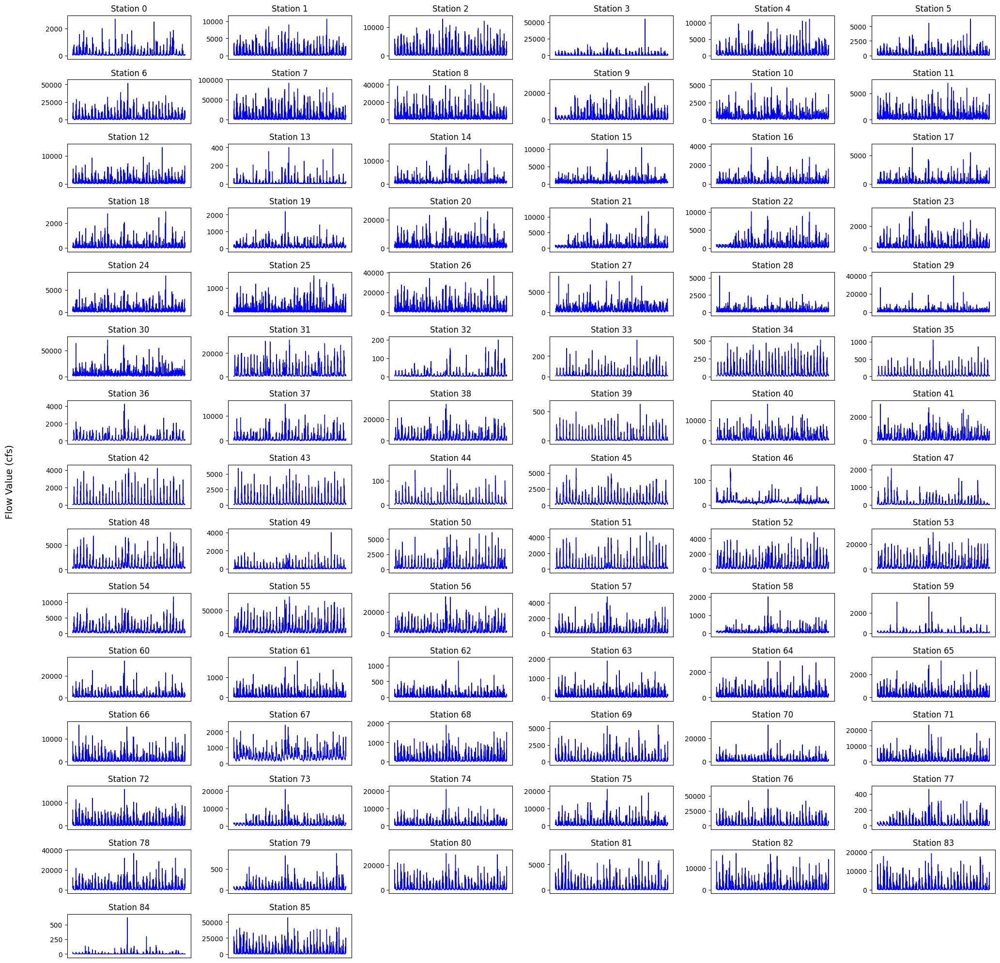

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'flow_data' is your 2D array of shape (86, 12784)
flow_data =F
# Get the number of stations and time steps
num_stations, num_time_steps = flow_data.shape

# Define the number of rows and columns for the subplot grid
num_rows = 15   # Adjust this value to customize the number of rows in the grid
num_cols = 6    # Adjust this value to customize the number of columns in the grid

# Calculate the total number of subplots needed and the number of empty subplots
total_subplots = num_stations
empty_subplots = num_rows * num_cols - total_subplots

# Create a grid of subplots to visualize the flow data for each station
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 20), sharex=True)

# Customizing plot style for the subplots
plot_color = 'b'
plot_linewidth = 1

# Iterate through the stations and plot the time series in each subplot
for i, ax in enumerate(axs.flatten()):
    if i < total_subplots:
        station_flow = flow_data[i]
        ax.plot(station_flow, color=plot_color, linewidth=plot_linewidth)
        ax.set_title(f'Station {i}')
        ax.set_xticks([])  # Hide x-axis ticks to save space

        # Set y-axis limits based on the minimum and maximum values of the station's time series
        min_flow = np.min(station_flow)
        max_flow = np.max(station_flow)
        y_padding = 0.1 * (max_flow - min_flow)  # Add 10% padding to the y-axis limits
        ax.set_ylim(min_flow - y_padding, max_flow + y_padding)

    else:
        ax.axis('off')  # Hide empty subplots

# Add a single y-axis label for the whole figure in the middle
fig.text(-0.03, 0.5, 'Flow Value (cfs)', va='center', rotation='vertical', fontsize=14)

plt.tight_layout()
plt.show()


In [ ]:
#### descritpve  staticstics for the flow in the station

flow_data = F
# Assuming 'flow_data' is your 2D array of shape (86, 12784)

# Calculate statistics for each station
mean_flow = np.mean(flow_data, axis=1)
median_flow = np.median(flow_data, axis=1)
std_dev_flow = np.std(flow_data, axis=1)
min_flow = np.min(flow_data, axis=1)
max_flow = np.max(flow_data, axis=1)

# Create a table for descriptive statistics
station_ids = range(0, 86)  # Assuming station IDs are from 1 to 86
statistics_table = pd.DataFrame({
    'Station ID': station_ids,
    'Mean Flow': mean_flow,
    'Median Flow': median_flow,
    'Standard Deviation': std_dev_flow,
    'Minimum Flow': min_flow,
    'Maximum Flow': max_flow
})


# Assuming 'dates' is an array containing the dates corresponding to the flow data
# and 'flow_data' is still your 2D array of shape (86, 12784)



In [ ]:
statistics_table

,Station ID,Mean Flow,Median Flow,Standard Deviation,Minimum Flow,Maximum Flow
0,0,133.676590,61.0,174.474280,12.0,2700.0
1,1,421.506023,215.0,630.120527,18.0,10700.0
2,2,644.200124,309.5,995.119326,14.0,12800.0
3,3,580.579905,259.5,1102.986784,16.0,55000.0
4,4,519.117040,284.0,735.379180,20.0,11200.0
...,...,...,...,...,...,...
81,81,234.027433,64.0,467.457770,2.1,7180.0
82,82,722.107635,329.0,1158.542854,23.0,16700.0
83,83,762.922200,274.5,1359.288738,7.2,19400.0
84,84,4.944259,1.6,12.614980,0.0,621.0


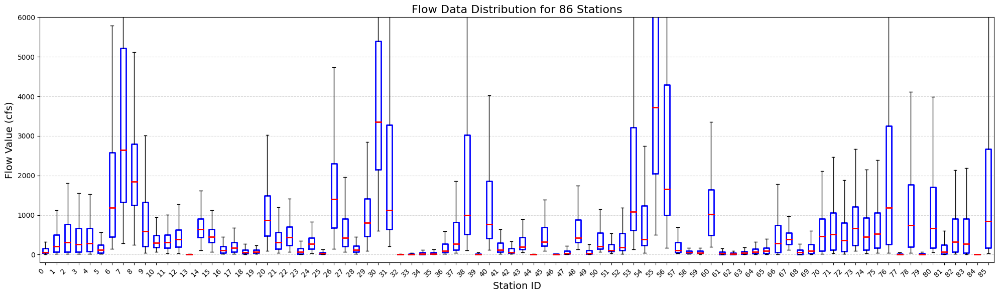

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'flow_data' is your 2D array of shape (86, 12784)

# Calculate summary statistics for flow data
median_flow = np.median(flow_data, axis=1)

# Create a box plot for flow data
plt.figure(figsize=(20, 6))

# Customizing boxplot style
boxprops = dict(linewidth=2, color='b')
medianprops = dict(linewidth=2, color='r')

plt.boxplot(flow_data.T,
            labels=[str(i) for i in range(86)],
            showfliers=False,
            boxprops=boxprops,
            medianprops=medianprops)

plt.xlabel('Station ID', fontsize=14)  # Increase font size for x-axis label
plt.ylabel('Flow Value (cfs)', fontsize=14)   # Increase font size for y-axis label
plt.ylim(-200, 6000)
plt.title('Flow Data Distribution for 86 Stations', fontsize=16)  # Increase font size for main title

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.5)

plt.show()


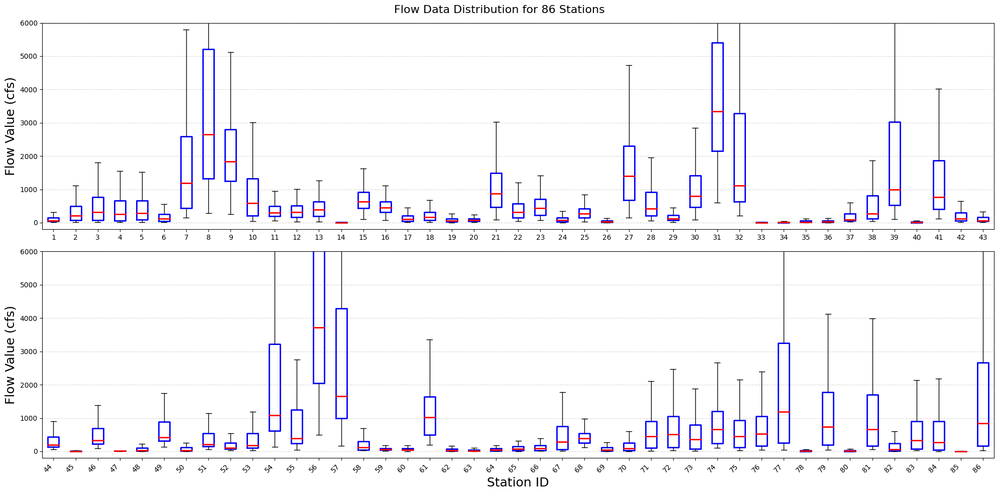

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'flow_data' is your 2D array of shape (86, 12784)

# Calculate summary statistics for flow data
median_flow = np.median(flow_data, axis=1)

# Create two subplots for flow data
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))

# Customizing boxplot style
boxprops = dict(linewidth=2, color='b')
medianprops = dict(linewidth=2, color='r')

# Subplot 1 (Top plot)
ax1.boxplot(flow_data[:43].T,
            labels=[str(i) for i in range(1, 44)],
            showfliers=False,
            boxprops=boxprops,
            medianprops=medianprops)

ax1.set_ylim(-200, 6000)
ax1.set_ylabel('Flow Value (cfs)', fontsize=18)

# Subplot 2 (Bottom plot)
ax2.boxplot(flow_data[43:].T,
            labels=[str(i) for i in range(44, 87)],
            showfliers=False,
            boxprops=boxprops,
            medianprops=medianprops)

ax2.set_ylim(-200, 6000)
ax2.set_xlabel('Station ID', fontsize=18)
ax2.set_ylabel('Flow Value (cfs)', fontsize=18)

# Set main title for the entire figure
plt.suptitle('Flow Data Distribution for 86 Stations', fontsize=16)

# Rotate the x-axis labels for better readability in the bottom subplot
plt.setp(ax2.get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()
ax2.grid(axis='y', linestyle='--', alpha=0.5)
ax1.grid(axis='y', linestyle='--', alpha=0.5)

plt.show()



In [ ]:

stationInds= [i for i in range(len(stationLat))]
stationIds = list(flowDict['stationID'])
Nstations= np.shape(F)[0]


# #saving
# save_pickle(stationInds,'stationInds.pickle')
# save_pickle(stationIds,'stationIds.pickle')
# save_pickle(Nstations,'Nstations.pickle')

In [ ]:
stationIds[40]

12451000

### plotting the traing validation and testing split

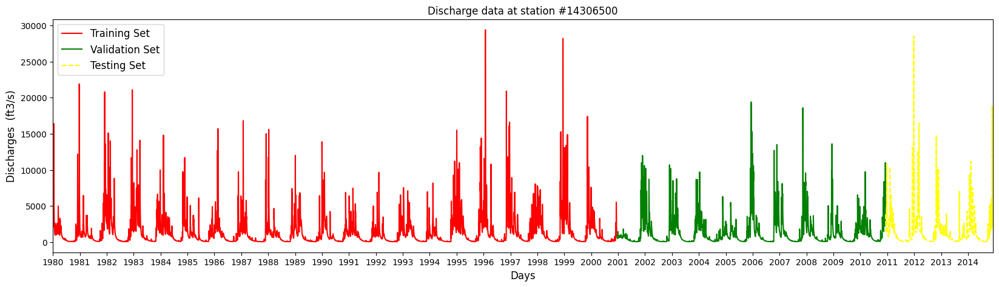

In [ ]:
st= 80
data =F[st,:]  # your time series data
fig = plt.figure(figsize=(20, 5))
# Split data into training, validation, and testing sets
training_set = data[0:7671]
validation_set = data[7671:7671+3652]
testing_set = data[7671+3652:]

# Plot data
plt.plot( range(0,7671),training_set, 'red', label='Training Set')
plt.plot(  range(7671,7671+3652),validation_set, 'green', label='Validation Set')
plt.plot( range(7671+3652,7671+3652+1461),testing_set, 'yellow', ls='--' ,label='Testing Set')

# Add labels and legend
plt.xlabel('Days',fontsize=12)
plt.ylabel('Discharges  (ft3/s)',fontsize=12)
plt.title('Discharge data at station #{}'.format(stationIds[st]))
plt.legend(fontsize=12)

years = range(1980, 2015)

# set the x-axis labels to be the years
plt.xticks(range(0, 12784 , 366), years)
plt.xlim(0,12784 )
plt.savefig(dir_output+'/comparisons/taint_test_val_split_80.png',dpi=300)
# Show plot
plt.show()

### elevation for each of the stations per cluster

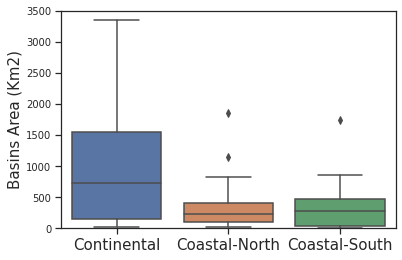

In [ ]:
# reading topography data (elevation and area for each basin)  and plotting them
topo_file= 'camels_topo.txt'
topo_df= pd.read_csv(dir_data+'/'+topo_file,sep=r';')
topo_df.set_index('gauge_id', inplace=True)

clustering_lables= load_pickle('clustering_labels.pickle')
# extracting the 86 stations

basins_areas = topo_df['area_gages2'].loc[stationIds]
basins_elevations = topo_df['elev_mean'].loc[stationIds]

def convert(x):  # convert labels into meaning full thing
  if x==0:
    return 'Continental'
  elif x==1:
    return 'Coastal-North'
  else: return 'Coastal-South'

clustering_lables = list(map( convert   ,clustering_lables))

# plotting
sns.set_style("ticks")
ax0=  sns.boxplot(y=basins_areas,x= clustering_lables)
plt.ylim(0,3500)
ax0.tick_params(axis='x', labelsize=15)
ax0.tick_params(axis='y', labelsize=10)
ax0.set_ylabel('Basins Area (Km2)', fontsize=15)
plt.savefig(dir_output+'/comparisons/Basins_areas_box.png',dpi=300)
plt.show()


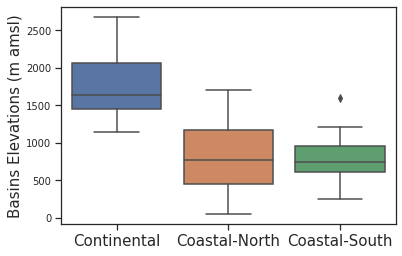

In [ ]:
ax1= sns.boxplot(y=basins_elevations,x= clustering_lables)

ax1.tick_params(axis='x', labelsize=15)
ax1.tick_params(axis='y', labelsize=10)
ax1.set_ylabel('Basins Elevations (m amsl)', fontsize=15)
plt.savefig(dir_output+'/comparisons/Basins_elevations_box.png',dpi=300)
plt.show()

### number of stations per cluster

(array([24.,  0.,  0.,  0.,  0., 34.,  0.,  0.,  0., 28.]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <BarContainer object of 10 artists>)

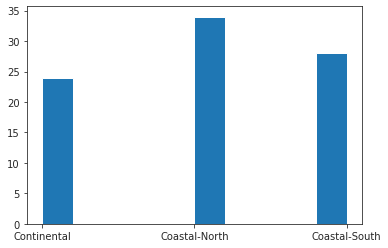

In [ ]:
# how many station we have for each of the clusters
plt.hist(clustering_lables)

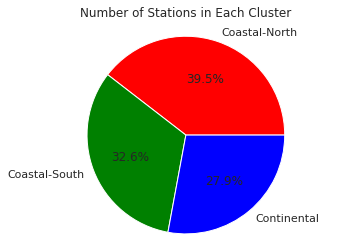

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Example data
clustering_labels = clustering_lables

# Count the number of stations in each cluster
unique_labels, counts = np.unique(clustering_labels, return_counts=True)

# Create a bar plot
plt.pie(counts, labels=unique_labels, colors=['red', 'green', 'blue'], autopct='%1.1f%%' )
plt.axis('equal')
plt.title('Number of Stations in Each Cluster', pad=10)
plt.show()


In [ ]:
unique_labels

array([34, 28, 24])

In [ ]:
### for visualization puroposes
#reduce spatial extent to only bound the stations of interest (reduce memory requirements)

bounding_box = 1 #1/0: yes/no if you want to reduce the spatial extent
border = 1 #number of pixels to border the outermost stations

if bounding_box:

  #find max/min lat/lon of stations in set
  minLon = np.min(stationLon.iloc[stationInds])
  maxLon = np.max(stationLon.iloc[stationInds])
  minLat = np.min(stationLat.iloc[stationInds])
  maxLat = np.max(stationLat.iloc[stationInds])

  #find corresponding indices in ERA lat/lon
  indMinLonERA = np.argmin(np.abs(eraLon - minLon))
  indMaxLonERA = np.argmin(np.abs(eraLon - maxLon))
  indMinLatERA = np.argmin(np.abs(eraLat - minLat))
  indMaxLatERA = np.argmin(np.abs(eraLat - maxLat))

  #spatial resolution in lat/lon dimensions
  d_eraLon = eraLon[1] - eraLon[0]
  d_eraLat = eraLat[0] - eraLat[1]

  #for visualization using plt.imshow -- define extent
  extentERA = [eraLon[indMinLonERA] - d_eraLon/2,eraLon[indMaxLonERA] + d_eraLon/2,eraLat[indMinLatERA] - d_eraLat/2,eraLat[indMaxLatERA] + d_eraLat/2]
  eraLon = eraLon[indMinLonERA:indMaxLonERA+1]
  eraLat = eraLat[indMaxLatERA:indMinLatERA+1]

  Nlat = len(eraLat) #number of grid cells / pixels along latitude
  Nlon = len(eraLon) #number of grid cells / pixels along longitude


### study area and the 86 stations considered

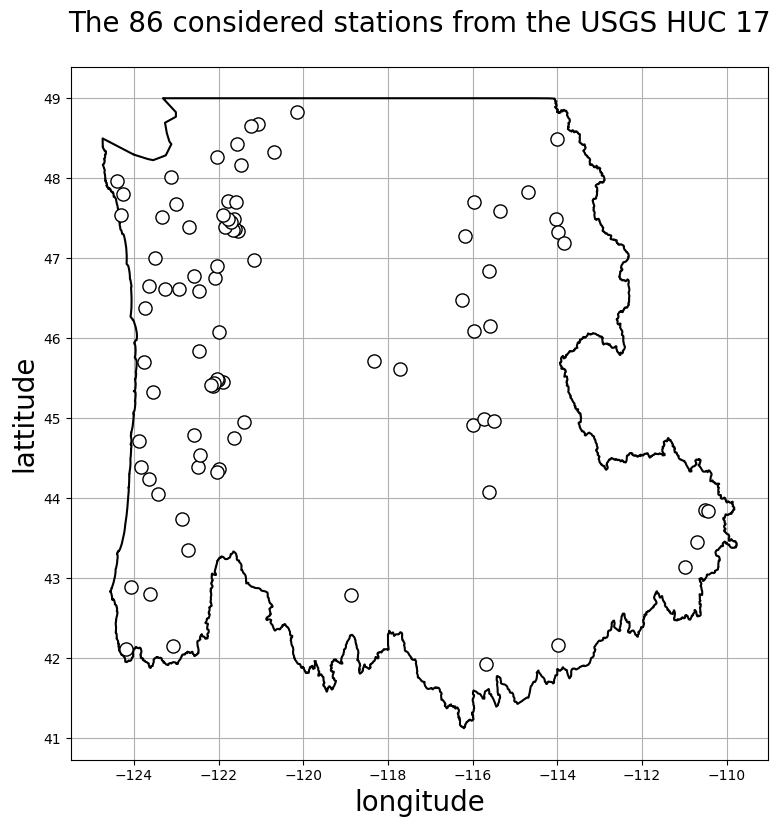

In [ ]:

fig, ax = plt.subplots(figsize = (9,9))

plot_prov_ax('17', ax = ax)
#plot_prov_ax('17', ax = ax)
ax.grid()
#ax.plot(np.mean(Tmin,axis=0))

for station in range(Nstations):

        ax.scatter(flowDict['stationLon'].iloc[station], flowDict['stationLat'].iloc[station], edgecolor = 'k', facecolor = 'w', s = 90, linewidth = 1, zorder = 3)
        ax.set_xlabel('longitude',size=20)
        ax.set_ylabel('lattitude',size=20)
ax.set_title ('The {} considered stations from the USGS HUC 17'.format(len(flowDict['stationID'])), size=20, pad= 25 )

# xtls = [str(ax.get_xticklabels()[i]).split(',')[1] + '$^\circ$ W' for i in range(len(ax.get_xticklabels()))]
# ax.set_xticklabels(xtls)
# ytls = [item.get_text() + '$^\circ$ N' for item in ax.get_yticklabels()]
# #ax.set_yticklabels(ytls)
plt.savefig(dir_output+'/comparisons/Stations_86.png',dpi=300)
plt.show()




In [ ]:
ax.imshow(Tmax[0])

## Standardize and normlize the data

In [ ]:
# years for training validation and testing
trainStartYear = 1980
trainFinYear = 2000
valStartYear = 2001
valFinYear = 2010
testStartYear = 2011
testFinYear = 2014

trainInds = np.squeeze(np.argwhere((flowYears>=trainStartYear) & (flowYears<=trainFinYear)))
valInds = np.squeeze(np.argwhere((flowYears>=valStartYear) & (flowYears<=valFinYear)))
testInds = np.squeeze(np.argwhere((flowYears>=testStartYear) & (flowYears<=testFinYear)))
Ntrain = len(trainInds)
Nval = len(valInds)
Ntest = len(testInds)

In [ ]:
# normalizing by substracting the mean and divdiding by the standard deviation

Tmaxmean_train = np.mean([Tmax[ii] for ii in range(np.shape(Tmax)[0])]) # normlize for the whole data set not only training
Tmaxstd_train = np.std([Tmax[ii] for ii in range(np.shape(Tmax)[0])])
Tmaxnorm = (Tmax - Tmaxmean_train)/Tmaxstd_train
Tmaxnorm = np.single(Tmaxnorm)



Tminmean_train = np.mean([Tmin[ii] for ii in range(np.shape(Tmax)[0])])
Tminstd_train = np.std([Tmin[ii] for ii in range(np.shape(Tmax)[0])])
Tminnorm = (Tmin - Tminmean_train)/Tminstd_train
Tminnorm = np.single(Tminnorm)

Pmean_train = np.mean([P[ii] for ii in range(np.shape(Tmax)[0])])
Pstd_train = np.std([P[ii] for ii in range(np.shape(Tmax)[0])])
Pnorm = (P - Pmean_train)/Pstd_train
Pnorm = np.single(Pnorm)


Fnorm = np.empty_like(F)
Fmean = np.zeros(Nstations)
Fstd = np.zeros(Nstations)
for station in range(np.shape(F)[0]):
  Fmean[station] = np.mean(F[station,list(trainInds)+list(testInds)+list(valInds)])
  Fstd[station] = np.std(F[station,list(trainInds)+list(testInds)+list(valInds)])
  Fnorm[station,:] = (F[station,:] - np.mean(F[station,trainInds]))/np.std(F[station,trainInds])
Fnorm = Fnorm.T    # for convenience

In [ ]:
np.mean(Tmax)

285.1636096088946

### discharge and normalized discharge plot

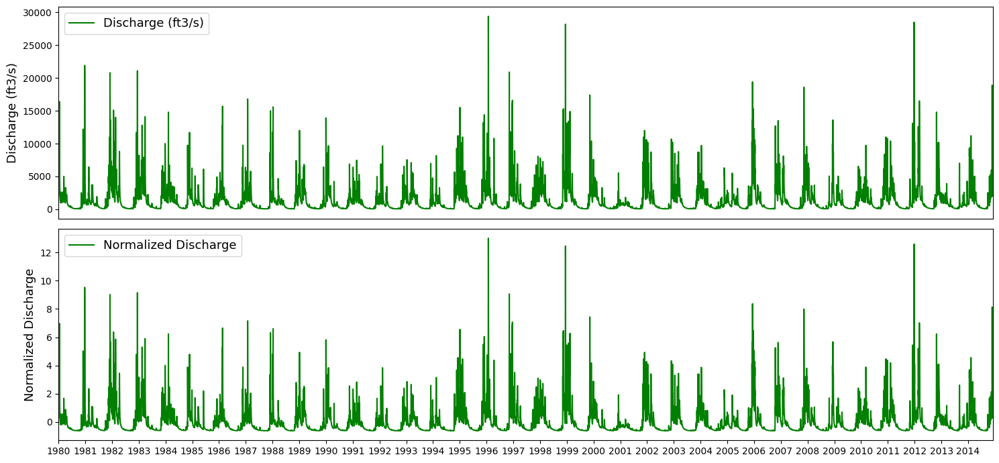

In [ ]:
saveIt=1
st=80
fig, ax = plt.subplots(2,1,figsize = (15,7))
fs=13
#fig.suptitle('Basin-averaged precipitation for station #{}'.format(stationIds[st]),y=1.02, fontsize=fs)

#plot_prov_ax('17', ax = ax)
ax[0].plot(F[st,:], label="Discharge (ft3/s)",c='g')
ax[0].set_xticks([])
ax[0].set_xlim(0,12784 )

ax[1].plot(Fnorm[:,st],label="Normalized Discharge",c='g')

years = range(1980, 2015)

# set the x-axis labels to be the years
plt.xticks(range(0, 12784 , 366), years)
plt.xlim(0,12784 )

# set the y-axis labels for each subplot
ax[0].set_ylabel('Discharge (ft3/s)', fontsize=fs)
ax[1].set_ylabel('Normalized Discharge',fontsize=fs)
ax[1].legend(fontsize=fs)
ax[0].legend(fontsize=fs)
plt.tight_layout()

if saveIt:
 plt.savefig(dir_output+'/comparisons/discharge_data_normalization.png',dpi=300)

## construct train and test predictor/target tensors (CNN-LSTM)


In [ ]:
#construct train and test predictor/target tensors

#target data
y_train = np.squeeze([Fnorm[0:trainInds[-1]+1,ii] for ii in range(np.shape(Fnorm)[1])]).T #drop first 365 days since those are used to predict first flow day
y_val = np.squeeze([Fnorm[valInds,ii] for ii in range(np.shape(Fnorm)[1])]).T
y_test = np.squeeze([Fnorm[testInds,ii] for ii in range(np.shape(Fnorm)[1])]).T

y_train = y_train.astype(dtype = np.float16)
y_val = y_val.astype(dtype = np.float16)
y_test = y_test.astype(dtype = np.float16)

#predictor data
nchannels = 3
x_train = np.empty((Ntrain, 365, ) + np.shape(Tmaxnorm)[1:] + (nchannels,),dtype=np.float16)
x_val = np.empty((Nval, 365,) + np.shape(Tmaxnorm)[1:] + (nchannels,), dtype = np.float16)
x_test = np.empty((Ntest, 365,) + np.shape(Tmaxnorm)[1:] + (nchannels,),dtype=np.float16)

#first, make (n_time x n_lon x n_lat x n_channels) tensor -- will be used to form weather videos
x_intermediate = np.empty(np.shape(Tmaxnorm) + (nchannels,),dtype='single')
x_intermediate[:,:,:,0] = Tmaxnorm
x_intermediate[:,:,:,1] = Tminnorm
x_intermediate[:,:,:,2] = Pnorm

# #training
for ii in range(Ntrain):
  x_train[ii] = x_intermediate[ii:ii+365]

#validation
for ii in range(Nval):
  x_val[ii] = x_intermediate[ii + Ntrain : ii + Ntrain + 365]

#testing
for ii in range(Ntest):
  x_test[ii] = x_intermediate[ii + Ntrain + Nval  : ii + Ntrain + Nval + 365]


#convert predict/target arrays to tensors
x_test = tf.convert_to_tensor(x_test)
x_val = tf.convert_to_tensor(x_val)
x_train = tf.convert_to_tensor(x_train)
y_test = tf.convert_to_tensor(y_test)
y_val = tf.convert_to_tensor(y_val)
y_train = tf.convert_to_tensor(y_train)

### gridded maximum and minimum temprater and precip


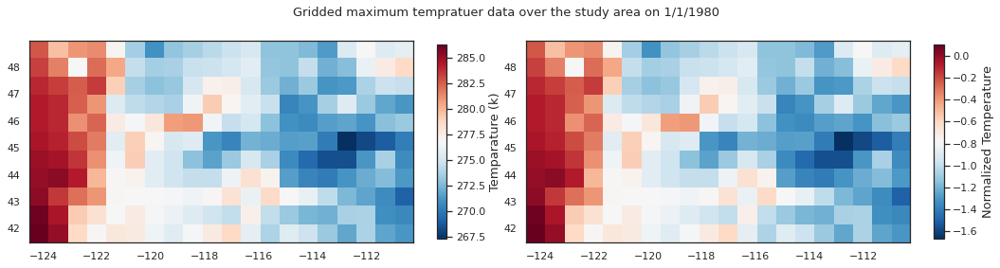

In [ ]:
saveIt=1
fig, ax = plt.subplots(1,2,figsize = (15,15))

fig.suptitle('Gridded maximum tempratuer data over the study area on 1/1/1980',y=0.62, fontsize=13)

#plot_prov_ax('17', ax = ax)
im= ax[0].imshow(Tmax[365],  cmap = 'RdBu_r', extent = extentERA)
cb0 = plt.colorbar(im, ax = ax[0], shrink=0.2)

im= ax[1].imshow(Tmaxnorm[365],  cmap = 'RdBu_r', extent = extentERA)
cb1 = plt.colorbar(im, ax = ax[1], shrink=0.2)

plt.tight_layout()

cb0.set_label('Temparature (k)', fontsize = 13)
cb1.set_label('Normalized Temperature', fontsize = 13)
if saveIt:
 plt.savefig(dir_output+'/comparisons/maxTemp_data_normalization.png',dpi=300)

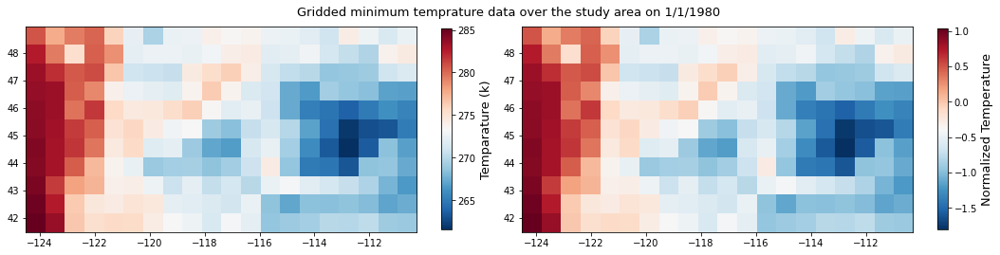

In [ ]:
saveIt=1
fig, ax = plt.subplots(1,2,figsize = (15,15))

fig.suptitle('Gridded minimum temprature data over the study area on 1/1/1980',y=0.62, fontsize=13)

#plot_prov_ax('17', ax = ax)
im= ax[0].imshow(Tmin[365],  cmap = 'RdBu_r', extent = extentERA)
cb0 = plt.colorbar(im, ax = ax[0], shrink=0.2)

im= ax[1].imshow(Tminnorm[365],  cmap = 'RdBu_r', extent = extentERA)
cb1 = plt.colorbar(im, ax = ax[1], shrink=0.2)

plt.tight_layout()

cb0.set_label('Temparature (k)', fontsize = 13)
cb1.set_label('Normalized Temperature', fontsize = 13)
if saveIt:
 plt.savefig(dir_output+'/comparisons/minTemp_data_normalization.png',dpi=300)

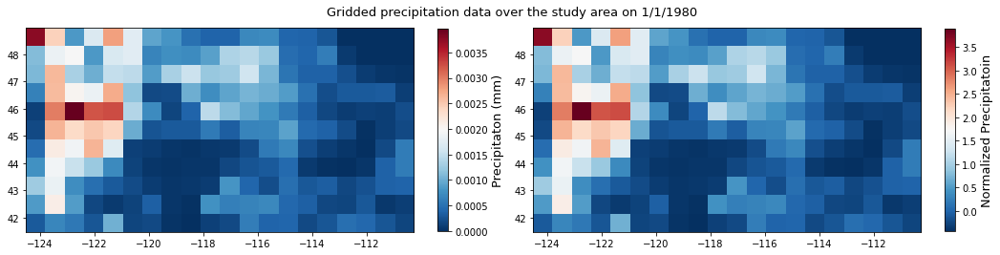

In [ ]:
saveIt=1
fig, ax = plt.subplots(1,2,figsize = (15,15))

fig.suptitle('Gridded precipitation data over the study area on 1/1/1980',y=0.62, fontsize=13)

#plot_prov_ax('17', ax = ax)
im= ax[0].imshow(P[365],  cmap = 'RdBu_r', extent = extentERA)
cb0 = plt.colorbar(im, ax = ax[0], shrink=0.2)

im= ax[1].imshow(Pnorm[365],  cmap = 'RdBu_r', extent = extentERA)
cb1 = plt.colorbar(im, ax = ax[1], shrink=0.2)

plt.tight_layout()

cb0.set_label('Precipitaton (mm)', fontsize = 13)
cb1.set_label('Normalized Precipitatoin', fontsize = 13)

if saveIt:
  plt.savefig(dir_output+'/comparisons/precipitation_data_normalization.png',dpi=300)


In [ ]:
## had you wanted to train the model from generator

# ALTERNATIVE:  Data can be structured as a generator which creates the input from x_intermediate.
#               Generators can be used when data cannot be loaded directly into RAM.  Memory issues
#               can come up especially from the multi-dimensional video structure.  We did not use
#               the generator approach here; rather, we loaded input/output directly to memory.  An
#               example of how to setup and train from generators is provided here.

# #training generator
# def gen_train():
#   for ii in range(Ntrain-365):
#     xx = tf.convert_to_tensor(x_intermediate[ii:ii+365])
#     yy = Fnorm[365+ii,:]
#     yield xx,yy

# #validation generator
# def gen_val():
#   for ii in range(Nval):
#     xx = tf.convert_to_tensor(x_intermediate[ii + Ntrain - 365 : ii + Ntrain])
#     yy = Fnorm[valInds[ii],:]
#     yield xx,yy

# #testing generator
# def gen_test():
#   for ii in range(Ntest):
#     xx = tf.convert_to_tensor(x_intermediate[ii + Ntrain + Nval - 365 : ii + Ntrain + Nval])
#     yy = Fnorm[testInds[ii],:]
#     yield xx,yy


#define datasets from these generators

# batch_size = 64
# x_shape= [365,np.shape(Pnorm)[1],np.shape(Pnorm)[2],3]
# #y_shape=[86]
# #y_shape=[1]
# y_shape=[np.shape(Fnorm)[1]]
# train_dataset = tf.data.Dataset.from_generator(
#     gen_train,
#     (tf.float16, tf.float16),
#     (tf.TensorShape(x_shape), tf.TensorShape(y_shape))
#     ).shuffle(Ntrain).batch(batch_size)

# val_dataset = tf.data.Dataset.from_generator(
#     gen_val,
#     (tf.float16, tf.float16),
#     (tf.TensorShape(x_shape), tf.TensorShape(y_shape))
#     ).shuffle(Nval).batch(batch_size)

# test_dataset = tf.data.Dataset.from_generator(
#     gen_test,
#     (tf.float16, tf.float16),
#     (tf.TensorShape(x_shape), tf.TensorShape(y_shape))
#     ).shuffle(Ntest).batch(batch_size)

# #Example of use for training:

# callbacks = EarlyStopping(monitor='val_loss',
#                         mode='min',
#                         verbose=1,
#                         patience = 5,
#                         restore_best_weights = True)

# model_bulk_CNN = build_bulk_model(learning_rate = 1e-1)



## Train the model and monitor prediction and loss while training

### building a model and save preidctions while training

In [ ]:
import numpy as np
from keras.callbacks import Callback

class PredictionSaver(Callback):
  def __init__(self, x, y, filepath):
    self.x = x
    self.y = y
    self.filepath = filepath

  def on_epoch_end(self, epoch, logs={}):
    prediction = self.model.predict(self.x)
    np.save(self.filepath.format(epoch), prediction)

# Define the filepath for saving the prediction
filepath = dir_output+'/CNN_LSTM/training_progress/prediction_{}.npy'
filepath = dir_output+'/CNN_LSTM/training_progress/models/model_{epoch:02d}.h5'
# Create the PredictionSaver callback
prediction_saver = PredictionSaver(x_test, y_test, filepath)


cp_callback = ModelCheckpoint(filepath=filepath, save_best_only=False)

seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 3,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_bulk_model_CNN_LSTM(learning_rate = learning_rate)
  history= model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks, cp_callback ]
  )



  #save the history in pickle

  # with open(dir_output+'/CNN_LSTM/training_progress/prediction_{}.pickle', 'wb') as f:
  #       pickle.dump(history, f)




Training bulk model 1 / 1
Epoch 1/50
120/120 [==============================] - 71s 569ms/step - loss: 0.9394 - val_loss: 0.7929
Epoch 2/50
120/120 [==============================] - 70s 579ms/step - loss: 0.7443 - val_loss: 0.6168
Epoch 3/50
120/120 [==============================] - 70s 579ms/step - loss: 0.5990 - val_loss: 0.5409
Epoch 4/50
120/120 [==============================] - 70s 579ms/step - loss: 0.5401 - val_loss: 0.5078
Epoch 5/50
120/120 [==============================] - 70s 579ms/step - loss: 0.5087 - val_loss: 0.4822
Epoch 6/50
120/120 [==============================] - 70s 579ms/step - loss: 0.4905 - val_loss: 0.4678
Epoch 7/50
120/120 [==============================] - 70s 580ms/step - loss: 0.4755 - val_loss: 0.4577
Epoch 8/50
120/120 [==============================] - 70s 579ms/step - loss: 0.4652 - val_loss: 0.4598
Epoch 9/50
120/120 [==============================] - 70s 579ms/step - loss: 0.4543 - val_loss: 0.4516
Epoch 10/50
120/120 [==========================

### visualizing the filters during training

Filters of Convlutional_2 layer (32 filters of 3x3x16)
 ################# EPOCH 1 #################


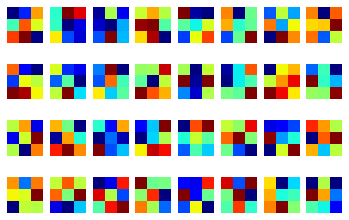

 ################# EPOCH 10 #################


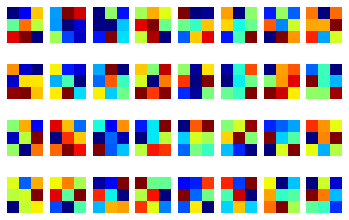

 ################# EPOCH 18 #################


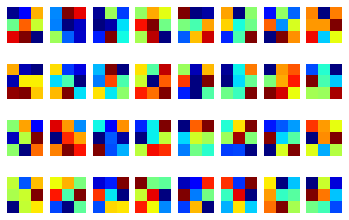

In [ ]:
from keras.models import load_model
# np.shape(model.layers[5].get_weights()[1])

layer= 2

# Load the model\

for epoch in  [1,10,18]:

        model = load_model(dir_output+'/CNN_LSTM/training_progress/models/model_{:02d}.h5'.format(epoch))
        # Extract the filters from the first convolutional layer
        filters, biases = model.layers[layer].get_weights()
        if epoch ==1: print('Filters of Convlutional_{} layer ({} filters of {}x{}x{})'.format(layer,filters.shape[3],filters.shape[0],filters.shape[0],filters.shape[2]))
        print(' ################# EPOCH {} #################'.format(epoch))
        # Normalize the filters
        f_min, f_max = filters.min(), filters.max()
        filters = (filters - f_min) / (f_max - f_min)

        # Get the number of filters
        num_filters = filters.shape[3]

        # Create a grid of subplots
        fig, axs = plt.subplots(int(num_filters / 8), 8)

        # Plot the filters
        for i in range(num_filters):
            ax = axs[i // 8, i % 8]
            ax.imshow(np.mean(filters[:, :, :, i],axis=2), cmap='jet')

            ax.axis('off')

        plt.show()


In [ ]:
epoch= 17

model = load_model(dir_output+'/CNN_LSTM/training_progress/models/model_{:02d}.h5'.format(epoch))
# Extract the filters from the first convolutional layer
filters, biases = model.layers[5].get_weights()

# Normalize the filters
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)

# # Get the number of filters
# num_filters = filters.shape[3]

# # Create a grid of subplots
# fig, axs = plt.subplots(int(num_filters / 8), 8)

# # Plot the filters
# for i in range(num_filters):
#     ax = axs[i // 8, i % 8]
#     ax.imshow(np.mean(filters[:, :, :, i],axis=2), cmap='gray')
#     ax.axis('off')

# plt.show()

### plot predictions while training

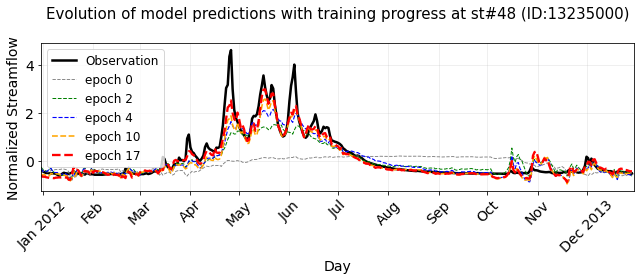

In [ ]:
saveIt=0
inds=48
fig, ax = plt.subplots(figsize = (9,4))
days = range(365, 365*2)
#days = range(Ntest)
days = range(365,365*2)
c=['gray','green','blue','orange','r']
ax.plot(days, y_test[365:365*2,inds], label = 'Observation', color = 'black', linewidth = 2.5)
ax.legend(fontsize = fs-4)
first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336])+365 #day-of-year of the first day of each month

months_str = ['Jan 2012', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec 2013']
for i,epoch in enumerate( [0,2,4,10,17]):
      y_test_predict_fine= np.load(dir_output+'/CNN_LSTM/training_progress/prediction_{}.npy'.format(epoch))


      rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

      fs = 16 #fontsize





      ax.plot(days,y_test_predict_fine[365:365*2,inds], label = 'epoch {}'.format(epoch), color = c[i], linewidth = 0.9*np.exp(epoch/18),ls='--')
      ax.set_ylabel('Normalized Streamflow', fontsize = fs-2)
      ax.set_xlabel('Day', fontsize = fs-2)

      #ax.set_title('Station {} (St ID:'.format(inds)+str(stationIDs[inds])+')' +'\nNSE = ' + str(np.round(NSE_bulk[inds], decimals = 2)), fontsize = fs-2)
      ax.set_xticks(first_days_of_month)
      ax.set_xlim((365,365*2))
      ax.set_xticklabels(months_str, rotation = 45)#, ha = 'right')
      ax.tick_params(labelsize = fs-2)
      ax.legend(fontsize = fs-4)
      #ax.text(x = -0.05, y = 1.1, s = '(a)', transform = ax.transAxes, fontsize = fs-2)
      ax.grid(True, alpha = 0.25)
      ax.set_title('Evolution of model predictions with training progress at st#48 (ID:{})'.format(stationIds[inds]), fontsize=15,pad=25)


      fig.tight_layout()
if saveIt:
  plt.savefig(dir_output+'/CNN_LSTM/training_progress/progress_prediction_{}.png'.format(inds),dpi=300)

#plt.plot(y_test[])

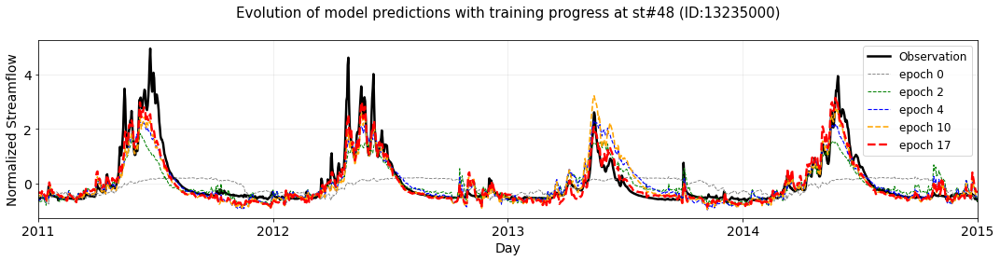

In [ ]:
saveIt=1
inds=48
fig, ax = plt.subplots(figsize = (15,4))
#days = range(365, 365*2)
days = range(Ntest)
#days = range(365,365*2)
c=['gray','green','blue','orange','r']
ax.plot(days, y_test[:,inds], label = 'Observation', color = 'black', linewidth = 2.5)
ax.legend(fontsize = fs-4)
first_days_of_year= np.array([i*365 for i in range(0,5)])
first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336])+365 #day-of-year of the first day of each month
year_str= [2011,2012,2013,2014,2015]
months_str = ['Jan 2012', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec 2013']
for i,epoch in enumerate( [0,2,4,10,17]):
      y_test_predict_fine= np.load(dir_output+'/CNN_LSTM/training_progress/prediction_{}.npy'.format(epoch))


      rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

      fs = 16 #fontsize





      ax.plot(days,y_test_predict_fine[:,inds], label = 'epoch {}'.format(epoch), color = c[i], linewidth = 0.9*np.exp(epoch/18),ls='--')
      ax.set_ylabel('Normalized Streamflow', fontsize = fs-2)
      ax.set_xlabel('Day', fontsize = fs-2)

      ax.set_title('Evolution of model predictions with training progress at st#48 (ID:{})'.format(stationIds[inds]), fontsize=15,pad=25)

      ax.set_xticks(first_days_of_year)
      ax.set_xlim((0,365*4))
      ax.set_xticklabels(year_str, rotation = 0)#, ha = 'right')
      ax.tick_params(labelsize = fs-2)
      ax.legend(fontsize = fs-4)
      #ax.text(x = -0.05, y = 1.1, s = '(a)', transform = ax.transAxes, fontsize = fs-2)
      ax.grid(True, alpha = 0.25)



      fig.tight_layout()
if saveIt:
  plt.savefig(dir_output+'/CNN_LSTM/training_progress/progress_prediction_full.png',dpi=300)

#plt.plot(y_test[])

### visualizing loss while training

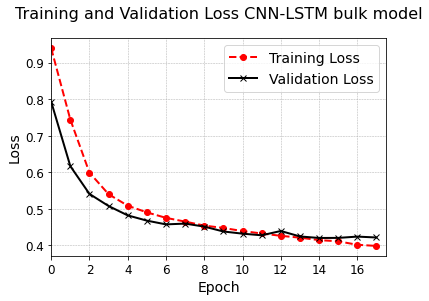

In [ ]:
with open(dir_output+'/CNN_LSTM/training_progress/history.pickle','rb') as f:
  history = pickle.load(f)
saveIt=0
# Extract the history values
loss = history.history['loss']
val_loss = history.history['val_loss']

# Set the figure size
plt.figure(figsize=(6, 4))

# Plot the training and validation loss
plt.plot(loss, linestyle='dashed', marker='o', color='r',linewidth=2, markersize=6, label='Training Loss')
plt.plot(val_loss, linestyle='solid', marker='x', color='black', linewidth=2, markersize=6, label='Validation Loss')

# Add a legend
plt.legend(loc='upper right', fontsize=14)

# Add axis labels
plt.xlabel('Epoch', fontsize=14)
plt.ylabel('Loss', fontsize=14)

# Add a title
plt.title('Training and Validation Loss CNN-LSTM bulk model', fontsize=16,pad=20)

# Set the tick label font size
plt.tick_params(axis='both', which='major', labelsize=12)
plt.xlim(0,17.5)
plt.grid(lw=0.5,ls='--')
# Show the plot
if saveIt:
  plt.savefig(dir_output+'/CNN_LSTM/training_progress/progress_loss.png',dpi=300)
plt.show()



In [ ]:
np.shape(flowDict['all_flowseason_NF']) # array with shape (86, 365) with the normalized seasonal flow for each of the 86 stations on daily scale

(86, 365)

In [ ]:
stationLon  # data frame with the longitude values for each of the station and the station ID as key

gauge_id
10396000   -118.86750
12010000   -123.74348
12013500   -123.65266
12020000   -123.27764
12025000   -122.94513
              ...    
14309500   -123.61091
14316700   -122.72894
14325000   -124.07065
14362250   -123.07532
14400000   -124.18731
Name: Longitude, Length: 86, dtype: float64

In [ ]:
stationLat  # data frame with the Latitude values for each of the station and the station ID as key

gauge_id
10396000    42.79083
12010000    46.37399
12013500    46.65093
12020000    46.61732
12025000    46.62010
              ...   
14309500    42.80400
14316700    43.34984
14325000    42.89150
14362250    42.15401
14400000    42.12344
Name: Latitude, Length: 86, dtype: float64

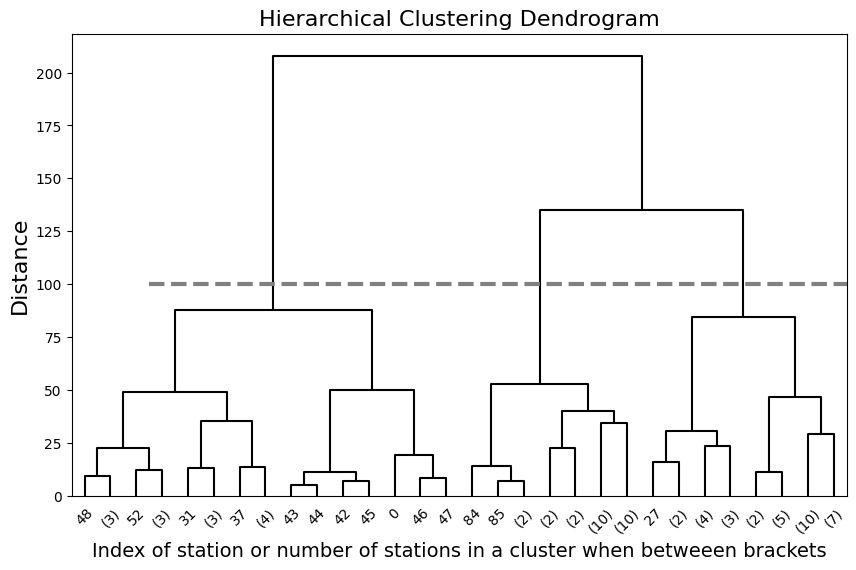

In [ ]:

#visualize dendrogram to inform number of clusters

# dfine a function to plot


def plot_dendrogram(model, **kwargs):

  """
  model: Agglomerative clustering model

  Creates linkage matrix and then plots the dendrogram
  Returns dendrogram

  Code from: https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html

  License:

  BSD 3-Clause License

  Copyright (c) 2007-2021 The scikit-learn developers.
  All rights reserved.

  Redistribution and use in source and binary forms, with or without
  modification, are permitted provided that the following conditions are met:

  * Redistributions of source code must retain the above copyright notice, this
    list of conditions and the following disclaimer.

  * Redistributions in binary form must reproduce the above copyright notice,
    this list of conditions and the following disclaimer in the documentation
    and/or other materials provided with the distribution.

  * Neither the name of the copyright holder nor the names of its
    contributors may be used to endorse or promote products derived from
    this software without specific prior written permission.

  THIS SOFTWARE IS PROVIDED BY THE COPYRIGHT HOLDERS AND CONTRIBUTORS "AS IS"
  AND ANY EXPRESS OR IMPLIED WARRANTIES, INCLUDING, BUT NOT LIMITED TO, THE
  IMPLIED WARRANTIES OF MERCHANTABILITY AND FITNESS FOR A PARTICULAR PURPOSE ARE
  DISCLAIMED. IN NO EVENT SHALL THE COPYRIGHT HOLDER OR CONTRIBUTORS BE LIABLE
  FOR ANY DIRECT, INDIRECT, INCIDENTAL, SPECIAL, EXEMPLARY, OR CONSEQUENTIAL
  DAMAGES (INCLUDING, BUT NOT LIMITED TO, PROCUREMENT OF SUBSTITUTE GOODS OR
  SERVICES; LOSS OF USE, DATA, OR PROFITS; OR BUSINESS INTERRUPTION) HOWEVER
  CAUSED AND ON ANY THEORY OF LIABILITY, WHETHER IN CONTRACT, STRICT LIABILITY,
  OR TORT (INCLUDING NEGLIGENCE OR OTHERWISE) ARISING IN ANY WAY OUT OF THE USE
  OF THIS SOFTWARE, EVEN IF ADVISED OF THE POSSIBILITY OF SUCH DAMAGE.
  """

  # create the counts of samples under each node
  counts = np.zeros(model.children_.shape[0])
  n_samples = len(model.labels_)
  for i, merge in enumerate(model.children_):
      current_count = 0
      for child_idx in merge:
          if child_idx < n_samples:
              current_count += 1  # leaf node
          else:
              current_count += counts[child_idx - n_samples]
      counts[i] = current_count

  linkage_matrix = np.column_stack([model.children_, model.distances_,
                                    counts]).astype(float)

  # Plot the corresponding dendrogram
  d = dendrogram(linkage_matrix, **kwargs)

  return d

#########################
saveIt = 1 #if save figure as a PNG file
saveEPS = 0 #if save figures as an EPS file

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)
model = model.fit(cluster_input)

# plot the top levels of the dendrogram
plt.figure(figsize=(10, 6))
d = plot_dendrogram(model, truncate_mode='level', p=4, color_threshold = 0, above_threshold_color = 'k')

# plot line showing where we cut and choose clusters
cutoff = 100
linemin = 30
linemax = 310


plt.plot([linemin,linemax],[cutoff,cutoff], color = 'gray', linestyle = '--', linewidth = 3)

plt.xlabel("Index of station or number of stations in a cluster when betweeen brackets", fontsize = 14)
plt.ylabel('Distance', fontsize = 16)
plt.title('Hierarchical Clustering Dendrogram', fontsize = 16)

if 1:
  plt.savefig(dir_output+'/comparisons/dendrogram.png',dpi=300)
if saveEPS:
  plt.savefig('dendrogram_seasonal.eps', format = 'eps', bbox_inches='tight')

plt.show()

In [ ]:
#from dendrogram, choose number of clusters and calculate mean pattern of each cluster

n_clusters_seasonal = 3
seasonal_clustering = AgglomerativeClustering(n_clusters = n_clusters_seasonal).fit(cluster_input)

#calculate average of each cluster
cluster_patterns = np.empty((n_clusters_seasonal, np.shape(cluster_input)[1]))
for cluster in range(n_clusters_seasonal):
  cluster_inds = np.argwhere(seasonal_clustering.labels_ == cluster)
  cluster_patterns[cluster,:] = np.mean(cluster_input[cluster_inds.reshape(-1,1),:], axis = 0)

In [ ]:
save_pickle(seasonal_clustering.labels_,'clustering_labels.pickle')

In [ ]:
#details for plotting/visualizations

#determine RGB values of colormap to use: chosen from coolors.co
rgbs = [[241, 135, 1], #cluster 0
      [205, 223, 160], #cluster 1
      [159, 222, 249], #etc
      [233, 134, 207],
      [21, 96, 121],
      [100, 23, 35]]

rgbas = [[241, 135, 1,256],
      [205, 223, 160,256],
      [159, 222, 249,256],
      [233, 134, 207,256],
      [21, 96, 121,256],
      [100, 23, 35,256]]

rgbs_array = np.asarray(rgbs)/256
rgbas_array = np.asarray(rgbas)/256

#colours of each station
cStations = np.empty((Nstations, 3))
for kk in range(Nstations):
  cStations[kk,:] = rgbs[seasonal_clustering.labels_[kk]]
cStations /= 256

#assign geographically relevant names for each cluster
cluster_names = [
                 'Continental',       #cluster 0
                 'Coastal-North',      #cluster 1
                 'Coastal-South',       #etc
                 'North-Eastern',
                ' North-Western ',
                 'North-Eastern'
]

first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336]) #day-of-year of the first day of each month

months_str = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

<ipython-input-22-b1d863638fe6>:46: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax0.set_xticklabels(xtls)
<ipython-input-22-b1d863638fe6>:48: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax0.set_yticklabels(ytls)


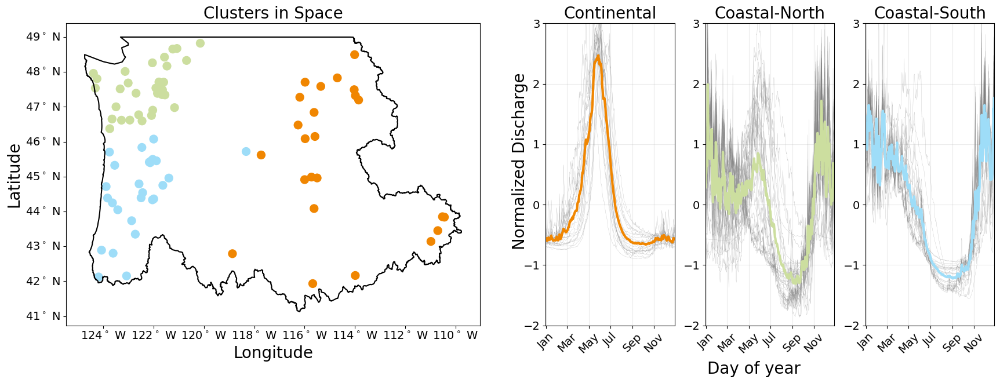

In [ ]:
#visualize clustering results (spatial + temporal patterns)

saveIt = 1
saveEPS = 0

fs = 20 #fontsize

fig = plt.figure(figsize = (17,7))

#left side: spatial map of stations, coloured by cluster to which they belong
ax0 = fig.add_subplot(1,2,1)
plot_prov_ax('17', ax = ax0)
#ax0.scatter(stationLon, stationLat, c = cStations, s = 100, linewidth = 1, edgeColor = 'k', zOrder = 3)
ax0.scatter(stationLon, stationLat, c = cStations, s = 100, linewidth = 1)
ax0.tick_params(labelsize = fs-6)
ax0.set_xlabel('Longitude', fontsize = fs)
ax0.set_ylabel('Latitude', fontsize = fs)
ax0.set_title('Clusters in Space', fontsize = fs)
#ax0.set_xlim((extentERA[0], extentERA[1]))
#ax0.set_ylim((extentERA[2], extentERA[3]))

#right side: subplots of seasonal streamflow of each cluster
subplot_inds = [3,4,5]#,11] #the right-side indices in a 2row x 6col grid, for plotting the temporal pattern
for cluster, subplot_ind in enumerate(subplot_inds):
  ax = fig.add_subplot(1,6,subplot_ind+1)
  ax.set_xticks(first_days_of_month[::2])
  ax.set_xlim((0,364))
  ax.set_ylim((-2,3))
  ax.set_xticklabels(months_str[::2], rotation = 45)#, ha = 'right')
  if cluster>3:
    ax.set_xticklabels([])
  cluster_inds = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster))
  ax.plot(cluster_input[cluster_inds,:365].T, linewidth = 0.25, alpha = 0.5, color = 'gray')
  ax.plot(cluster_patterns[cluster,:365], color = rgbs_array[cluster], linewidth = 3)
  ax.tick_params(labelsize = fs - 6)
  ax.set_title(cluster_names[cluster], fontsize = fs)
  ax.grid(True, alpha = 0.25)

fig.tight_layout(rect=[0, 0.03, 1, 0.95])

ax0.text(-107.75,43, 'Normalized Discharge', fontsize = fs, rotation = 90) #manually add axis labels to control tight-layout aesthetic
ax0.text(-100,39.35, 'Day of year', fontsize = fs)

#edit ticklabels
xtls = [str(int(item.get_text()[1:])) + '$^\circ$ W' for item in ax0.get_xticklabels()]
ax0.set_xticklabels(xtls)
ytls = [item.get_text() + '$^\circ$ N' for item in ax0.get_yticklabels()]
ax0.set_yticklabels(ytls)

if saveIt:
  plt.savefig(dir_output+'/comparisons/cluster_patterns.png', bbox_inches = 'tight', dpi = 300)

if saveEPS:
  plt.savefig('cluster_patterns.eps', format = 'eps', bbox_inches='tight')

plt.show()

## Training bulk and fine-tuned CNN-LSTM models

In [ ]:
model_bulk = build_bulk_model_CNN_LSTM(learning_rate = 1e-4)
model_bulk.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 365, 11, 20, 32)  128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 365, 11, 20, 16)  4624      
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 365, 11, 20, 32)  4640      
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 365, 11, 20, 3)   867       
 tributed)                                                       
                                                                 
 reshape (Reshape)           (None, 365, 660)         

In [ ]:
#set of random seeds to use for reproducability
seeds = [00]

#parameters for training
learning_rate = 1e-4

#parameters for heat maps
sigma = 1.5 #radius of perturbation
style_dict = {'style' : 'gauss', #style of perturbation: gaussian (not RISE/rectangular)
              'params' : sigma}
days_heat = range(Ntest) #days in test set to perturb
iters_total = 200 #total iterations of perturbation
iters_one_pass = 50 #number of iterations to pass through model at one time (too high --> RAM issues)
tol = 5e-3
#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 3,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_bulk_model_CNN_LSTM(learning_rate = learning_rate)
  model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks]
  )
  #predict train/val/test streamflow
  y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
  y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
  y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


  #save bulk model outputs
  file_train = 'y_train_bulk_predict_' + str(ii) + '.csv' #ii is the model number
  file_val = 'y_val_bulk_predict_' + str(ii) + '.csv'
  file_test = 'y_test_bulk_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'model_bulk_' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)

  #generate/save bulk heat maps
  print(' Making sensitivity heat maps')
  heat_mean_bulk = make_heat(
      model = model_bulk,
      x_test = x_test,
      y_test = y_test,
      style_dict = style_dict,
      days = days_heat,
      iters_total = iters_total,
      iters_one_pass = iters_one_pass,
      stationInds = range(Nstations),
      verbose = 0,
      tol = tol
      )
  fileName = 'heat_mean_bulk_' + str(ii) + '.csv'
  np.savetxt(dir_heat + '/' + fileName, heat_mean_bulk, delimiter = ',')

##### FINE-TUNING

  #prep fine-tune target output
  y_train_predict_fine_all = np.empty_like(y_train)
  y_val_predict_fine_all = np.empty_like(y_val)
  y_test_predict_fine_all = np.empty_like(y_test)

  #for each streamflow cluster, make/train/save fine-tuned model/output/heatmaps
  heat_mean_fine = np.zeros_like(heat_mean_bulk)
  for cluster in range(n_clusters_seasonal):

    print('Training fine model, cluster ' + str(cluster+1) + ' / ' + str(n_clusters_seasonal))

    stations_fine = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster)) #stations in this cluster
    N_stations = len(stations_fine) #number of stations in this cluster

    #create target datasets (note: x is the same, y is different (same spatial input, different station targets))
    y_train_fine_current = tf.convert_to_tensor(y_train.numpy()[:,stations_fine])
    y_val_fine_current = tf.convert_to_tensor(y_val.numpy()[:,stations_fine])
    y_test_fine_current = tf.convert_to_tensor(y_test.numpy()[:,stations_fine])

    train_dataset_fine = tf.data.Dataset.from_tensor_slices((x_train,y_train_fine_current)).shuffle(Ntrain).batch(batch_size = batch_size)
    val_dataset_fine = tf.data.Dataset.from_tensor_slices((x_val,y_val_fine_current)).shuffle(Nval).batch(batch_size = batch_size)

    #build and train fine-tuned model
    model_fine = build_fine_model(model_bulk = model_bulk, N_stations = N_stations, learning_rate = learning_rate)
    model_fine.fit(
      train_dataset_fine,
      validation_data = val_dataset_fine,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )

    #predict train/val/test streamflow
    y_train_predict_fine = model_fine.predict(x_train, batch_size = batch_size, verbose = 0)
    y_val_predict_fine = model_fine.predict(x_val, batch_size = batch_size, verbose = 0)
    y_test_predict_fine = model_fine.predict(x_test, batch_size = batch_size, verbose = 0)

    #reorganize predictions into array that matches the bulk train/val/test structure
    for kk, station_fine in enumerate(stations_fine): #for each station/index in this cluster
      y_train_predict_fine_all[:,station_fine] = y_train_predict_fine[:,kk] #y_***_predict_fine_all has fine-tuned predictions for all stations, in same order as bulk
      y_val_predict_fine_all[:,station_fine] = y_val_predict_fine[:,kk]
      y_test_predict_fine_all[:,station_fine] = y_test_predict_fine[:,kk]

    #save model
    model_name = 'model_fine_' + str(ii) + '_cluster_' + str(cluster) + '.h5'
    model_fine.save(dir_models + '/' + model_name)

    #generate fine-tuned heat maps
    print(' Making sensitivity heat maps')
    heat_mean_cluster = make_heat(
        model = model_fine,
        x_test = x_test,
        y_test = y_test,
        style_dict = style_dict,
        days = days_heat,
        iters_total = iters_total,
        iters_one_pass = iters_one_pass,
        stationInds = stations_fine,
        verbose = 0,
        tol = tol
        )
    for zz,station in enumerate(stations_fine): #reorganize heatmaps into array that matches the bulk heatmap order (e.g. heat_mean_fine[:,0] and heat_mean_bulk[:,0] are the same station)
      heat_mean_fine[:,station] = heat_mean_cluster[:,zz]

    #save the in-progress heatmaps in case of crash
    fileName = 'heat_mean_fine_' + str(ii) + '_cluster_' + str(cluster) + '_inprogess.csv'
    np.savetxt(dir_heat + '/' + fileName, heat_mean_bulk, delimiter = ',')

  #save fine-tuned heatmaps
  fileName = 'heat_mean_fine_' + str(ii) + '.csv'
  np.savetxt(dir_heat + '/' + fileName, heat_mean_fine, delimiter = ',')

  #save fine-tuned model predictions
  file_train = 'y_train_fine_predict_' + str(ii) + '.csv'
  file_val = 'y_val_fine_predict_' + str(ii) + '.csv'
  file_test = 'y_test_fine_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_fine_all, delimiter = ',')




Training bulk model 1 / 1


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch 1/50
120/120 [==============================] - 91s 630ms/step - loss: 0.9394 - val_loss: 0.7929
Epoch 2/50
120/120 [==============================] - 71s 580ms/step - loss: 0.7443 - val_loss: 0.6168
Epoch 3/50
120/120 [==============================] - 70s 579ms/step - loss: 0.5990 - val_loss: 0.5408
Epoch 4/50
120/120 [==============================] - 71s 581ms/step - loss: 0.5401 - val_loss: 0.5078
Epoch 5/50
120/120 [==============================] - 70s 580ms/step - loss: 0.5086 - val_loss: 0.4821
Epoch 6/50
120/120 [==============================] - 71s 580ms/step - loss: 0.4904 - val_loss: 0.4678
Epoch 7/50
120/120 [==============================] - 70s 580ms/step - loss: 0.4754 - val_loss: 0.4576
Epoch 8/50
120/120 [==============================] - 70s 579ms/step - loss: 0.4651 - val_loss: 0.4597
Epoch 9/50
120/120 [==============================] - 70s 580ms/step - loss: 0.4542 - val_loss: 0.4514
Epoch 10/50
120/120 [==============================] - 71s 581ms/step - l

<ipython-input-52-9a01a8afdb03>:148: RuntimeWarning: divide by zero encountered in double_scalars
  err = np.mean(np.abs(heat_curr - heat_prev)) / np.mean(heat_prev)


Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 36ms/step
1
1/1 [==============================] - 0s 36ms/step
2
1/1 [==============================] - 0s 36ms/step
3
1/1 [==============================] - 0s 35ms/step


### Compare results form different model runs

In [ ]:
#compare results from different model runs

#model runs to explore
runs = [0]
Nruns = len(runs)

#initialize
NSE_fine_runs = np.empty((Nruns, Nstations)) #fine-tuned NSE on test set
NSE_bulk_runs = np.empty((Nruns, Nstations)) #bulk NSE on test set
dNSE_runs = np.empty((Nruns, Nstations)) #difference in NSE from fine-tuning

A_fine_runs = np.empty((Nruns, Nstations)) #A from fine-tuned heatmaps on test set
A_bulk_runs = np.empty((Nruns, Nstations)) #A from bulk heatmaps on test set
dA_runs = np.empty((Nruns, Nstations)) #difference in A from fine-tuning

heat_mean_fine_runs = np.empty((Nruns, Npx, Nstations)) #fine-tuned heatmaps of each run
heat_mean_bulk_runs = np.empty((Nruns, Npx, Nstations)) #bulk heatmaps of each run

y_test_predict_bulk_runs = np.empty((Nruns, Ntest, Nstations)) #bulk model predictions of each run
y_test_predict_fine_runs = np.empty((Nruns, Ntest, Nstations)) #fine-tuned model predictions of each run

y_all_predict_fine_runs = np.empty((Nruns, Ntrain + Nval + Ntest , Nstations))

#loop through each run, open model outputs/heatmaps, calculate NSE and A
for ii, run in enumerate(runs):

  print('Run ' + str(run))

  #load modelled streamflow
  filename_train_bulk = 'CNN_LSTM/y_train_bulk_predict_' + str(run) + '.csv'
  filename_val_bulk = 'CNN_LSTM/y_val_bulk_predict_' + str(run) + '.csv'
  filename_test_bulk = 'CNN_LSTM/y_test_bulk_predict_' + str(run) + '.csv'
  filename_train_fine = 'CNN_LSTM/y_train_fine_predict_' + str(run) + '.csv'
  filename_val_fine = 'CNN_LSTM/y_val_fine_predict_' + str(run) + '.csv'
  filename_test_fine = 'CNN_LSTM/y_test_fine_predict_' + str(run) + '.csv'
  y_train_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_train_bulk, header = None))
  y_val_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_val_bulk, header = None))
  y_test_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_test_bulk, header = None))
  y_train_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_train_fine, header = None))
  y_val_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_val_fine, header = None))
  y_test_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_test_fine, header = None))
  y_test_predict_bulk_runs[ii,:,:] = y_test_predict_bulk
  y_test_predict_fine_runs[ii,:,:] = y_test_predict_fine
  y_all_predict_fine_runs[ii,:,:] = np.vstack((y_train_predict_fine, y_val_predict_fine, y_test_predict_fine))

  #load heat maps
  filename_bulk = 'heat_mean_bulk_' + str(run) + '.csv'
  filename_fine = 'heat_mean_fine_' + str(run) + '.csv'
  heat_mean_bulk = np.asarray(pd.read_csv(dir_heat + '/' + filename_bulk, header = None))
  heat_mean_fine = np.asarray(pd.read_csv(dir_heat + '/' + filename_fine, header = None))
  heat_mean_bulk_runs[ii,:,:] = heat_mean_bulk
  heat_mean_fine_runs[ii,:,:] = heat_mean_fine

  #initialize NSE train/val/test bulk/fine and A bulk/fine arrays of this current run
  NSE_fine = np.empty((Nstations,))
  NSE_bulk = np.empty((Nstations,))
  NSE_train_fine = np.empty((Nstations,))
  NSE_train_bulk = np.empty((Nstations,))
  NSE_val_fine = np.empty((Nstations,))
  NSE_val_bulk = np.empty((Nstations,))
  NSE_test_fine = np.empty((Nstations,))
  NSE_test_bulk = np.empty((Nstations,))
  A_fine = np.zeros((Nstations,))
  A_bulk= np.zeros((Nstations,))

  #loop through each station and calculate NSE and A
  for station in range(Nstations):

#####calculate NSE

    #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
    NSE_train_fine[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_fine[:,station]
        )
    NSE_val_fine[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_fine[:,station]
        )
    NSE_test_fine[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_fine[:,station]
        )
    NSE_train_bulk[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_bulk[:,station]
        )
    NSE_val_bulk[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_bulk[:,station]
        )
    NSE_test_bulk[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_bulk[:,station]
        )

#####calculate A
    A_bulk[station] = get_A(heat = heat_mean_bulk[:,station])
    A_fine[station] = get_A(heat = heat_mean_fine[:,station])

  dNSE = NSE_test_fine - NSE_test_bulk
  dA = A_fine - A_bulk

  NSE_fine_runs[ii,:] = np.asarray(NSE_test_fine)
  NSE_bulk_runs[ii,:] = np.asarray(NSE_test_bulk)
  dNSE_runs[ii,:] = dNSE

  A_fine_runs[ii,:] = A_fine
  A_bulk_runs[ii,:] = A_bulk
  dA_runs[ii,:] = dA

Run 0


In [ ]:
# save NSES
# file_nse_test_bulk = 'CNN_LSTM/NSE_test_bulk.csv' #ii is the model number
# file_nse_test_fine = 'CNN_LSTM/NSE_test_fine.csv'

# file_nse_train_bulk = 'CNN_LSTM/NSE_train_bulk.csv' #ii is the model number
# file_nse_train_fine = 'CNN_LSTM/NSE_train_fine.csv'

# file_nse_val_bulk = 'CNN_LSTM/NSE_val_bulk.csv' #ii is the model number
# file_nse_val_fine = 'CNN_LSTM/NSE_val_fine.csv'

# np.savetxt(dir_output + '/' + file_nse_test_bulk, NSE_test_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_test_fine, NSE_test_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_train_bulk, NSE_train_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_train_fine, NSE_train_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_val_bulk, NSE_val_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_val_fine, NSE_val_fine, delimiter = ',')


In [ ]:
#also calculate NSE of the model ensemble average streamflow, rather than model-by-model NSE

NSE_bulk = np.empty(Nstations)
NSE_fine = np.empty(Nstations)

for station in range(Nstations):

  NSE_bulk[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_bulk_runs,axis = 0)[:,station]
  )

  NSE_fine[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_fine_runs,axis = 0)[:,station]
  )

print('Median NSE test bulk ensemble = ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('Median NSE test fine ensemble = ' + str(np.round(np.median(NSE_fine), decimals = 2)))

Median NSE test bulk ensemble = 0.55
Median NSE test fine ensemble = 0.62


In [ ]:
print('\nFine-tuned model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_fine), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_fine), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_fine), decimals = 2)))

print('\nbulk-model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_bulk), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_bulk), decimals = 2)))


Fine-tuned model: 
	Minimum NSE: 0.33
	Median NSE: 0.62
	Maximum NSE: 0.92

bulk-model: 
	Minimum NSE: 0.23
	Median NSE: 0.55
	Maximum NSE: 0.88


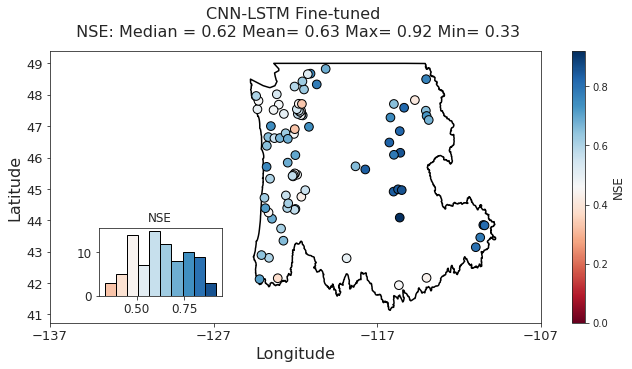

In [ ]:
plot_nses_spatially('CNN_LSTM','CNN-LSTM Fine-tuned',NSE_fine,1,'fine')

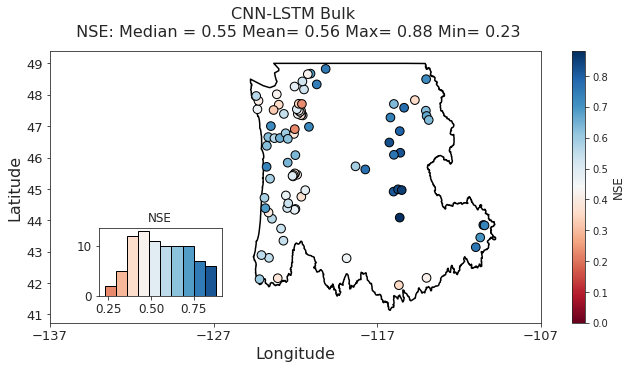

In [ ]:
plot_nses_spatially('CNN_LSTM','CNN-LSTM Bulk',NSE_bulk,1,'Bulk')

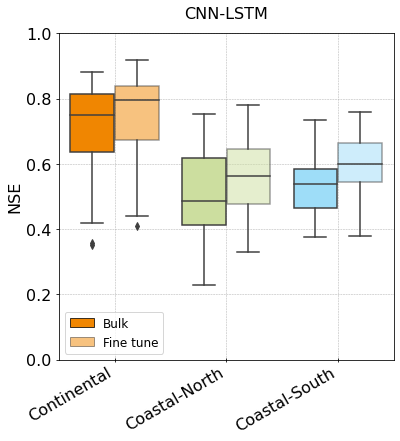

In [ ]:
plot_NSEs_box('CNN_LSTM','CNN-LSTM',NSE_bulk,NSE_fine,1)

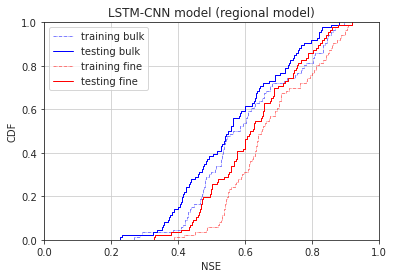

In [ ]:

plot_CDF('CNN_LSTM','LSTM-CNN model (regional model)',savefig=0)

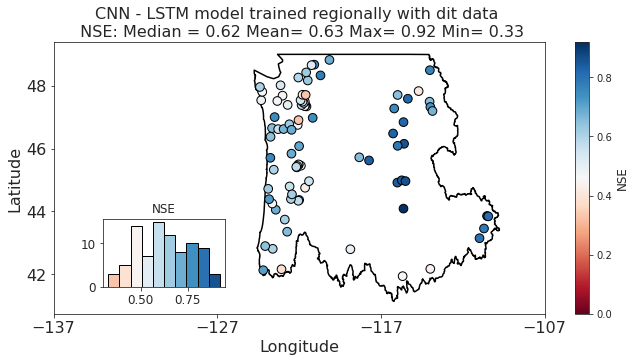

In [ ]:
#normalize each heat maps to have zero mean and unity variance -- want to compare spatial form of sensitivity

#initialize
heat_mean_fine_runs_norm = np.zeros_like(heat_mean_fine_runs)
heat_mean_bulk_runs_norm = np.zeros_like(heat_mean_bulk_runs)

#for each station and run, load/normalize each bulk/fine heat map
for station in range(Nstations):
  for run in range(Nruns):

    hh = heat_mean_fine_runs[run,:,station]
    heat_mean_fine_runs_norm[run,:,station] = (hh - np.mean(hh)) / np.std(hh) #if np.isnan((hh - np.mean(hh)) / np.std(hh)).sum()==0 else hh

    hh = heat_mean_bulk_runs[run,:,station]
    heat_mean_bulk_runs_norm[run,:,station] = (hh - np.mean(hh)) / np.std(hh)

#heat_mean_fine_runs_norm [np.argwhere(np.isnan(heat_mean_fine_runs_norm))]=0
#heat_mean_bulk_runs_norm
#calculate ensemble mean heat map for each station
#heat_fine_ensemble_mean = heat_mean_fine  #heat_mean_fine_runs_norm[0]#
heat_fine_ensemble_mean = np.mean(heat_mean_fine_runs_norm, axis = 0)
heat_bulk_ensemble_mean = np.mean(heat_mean_bulk_runs_norm, axis = 0)

cluster_heat_fine_mean = []
cluster_heat_bulk_mean = []

#calculate ensemble mean heat map for each cluster
for cluster in range(n_clusters_seasonal):

  inds = np.argwhere(seasonal_clustering.labels_ == cluster).reshape(-1,1) #indices of the cluster

  cluster_heat_mean_fine_current = np.squeeze(np.mean(heat_fine_ensemble_mean[:,inds], axis = 1))
  cluster_heat_mean_bulk_current = np.squeeze(np.mean(heat_bulk_ensemble_mean[:,inds], axis = 1))

  cluster_heat_fine_mean.append(cluster_heat_mean_fine_current)
  cluster_heat_bulk_mean.append(cluster_heat_mean_bulk_current)

In [ ]:
#calculate sensitive areas on ensemble mean heat maps
A_fine = np.zeros((Nstations,))
A_bulk= np.zeros((Nstations,))

for station in range(Nstations):
  A_bulk[station] = get_A(heat = heat_bulk_ensemble_mean[:,station])
  A_fine[station] = get_A(heat = heat_fine_ensemble_mean[:,station])

<ipython-input-40-679a8271bd0b>:50: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


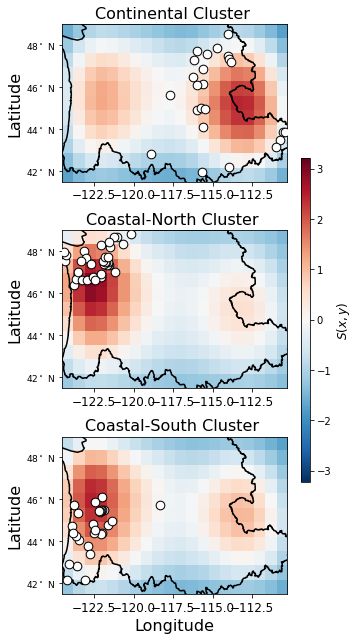

In [ ]:
#visualize fine-tuned ensemble mean heatmaps for each cluster

saveIt = 1
#ex = 'fine'
ex='bulk'

fs = 16
abc = ['(a)','(b)','(c)','(d)','(e)','(f)']

nrows = 3
ncols = 1

vmax = np.max(np.abs(cluster_heat_fine_mean))
vmin = -vmax#np.min(cluster_heat_fine_mean)

fig, axes = plt.subplots(nrows = nrows, ncols = ncols, figsize = (4*ncols,3*nrows))

for cluster, ax in enumerate(axes[:]): #for each cluster

  inds = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster).reshape(-1,1) )#indices of stations in this cluster
  im = ax.imshow(cluster_heat_bulk_mean[cluster].reshape(np.shape(Tmax[0])), aspect = 'auto', cmap = 'RdBu_r',extent = extentERA, vmin = vmin, vmax = vmax)



  ax.scatter(stationLon.iloc[inds], stationLat.iloc[inds], s = 75, facecolor = 'w', edgecolor = 'k', zOrder = 4) #stream gauge stations
  #plot_prov_ax('17', ax = ax) #provincial borders

  ax.tick_params(labelsize = fs-4)
  if cluster == 2or cluster == 5:
    ax.set_xlabel('Longitude', fontsize = fs)
  if cluster == 0 or cluster == 2 or cluster == 1:
    ax.set_ylabel('Latitude', fontsize = fs)

  ax.set_title(cluster_names[cluster] + ' Cluster ', fontsize = fs)
  ax.set_xlim((extentERA[0], extentERA[1]))
  ax.set_ylim((extentERA[2], extentERA[3]))
  #ax.text(x = -0.15, y = 1.1, s = abc[cluster], transform = ax.transAxes, fontsize = fs)
  plot_prov_ax('17', ax = ax) #provincial borders

#plt.title(' Sensitivity Heatmaps for 3 clusters (Fine-tuned model) ', fontsize = fs)
#plt.title(' Sensitivity Heatmaps for 3 clusters (Bulk model) ', fontsize = fs)
cax = fig.add_axes([1.01, 0.25, 0.03, 0.5]) #colourbar gets own axis
mapname = 'RdBu'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)
cb = fig.colorbar(im, cax = cax, orientation = 'vertical')
plt.ylabel('$S(x,y)$', fontsize = fs-4)#, cax)

plt.tight_layout()

#edit ticklabels to degrees W and N
for ax in axes.flatten():
  # xtls = [str(str(item.get_text())) for item in ax.get_xticklabels()]

  # ax.set_xticklabels(xtls, fontsize = 9)
  #print(xtls)
  matplotlib.rc('xtick', labelsize=5)
  ytls = [item.get_text() + '$^\circ$ N' for item in ax.get_yticklabels()]
  ax.set_yticklabels(ytls, fontsize = 9)
  #print(ytls)

if saveIt:
  plt.savefig(dir_output+'/CNN_LSTM/heatmap_{}.png'.format(ex), dpi = 300, bbox_inches = 'tight')


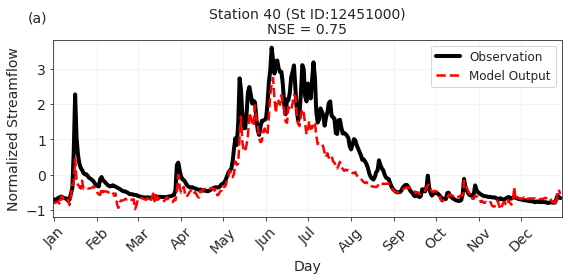

In [ ]:
##### examples of streamflow

saveIt = 0
saveEPS = 0


inds = 40


stationIDs = flowDict['stationID']

days = range(365*2, 365*3)
days = range(Ntest)
days = range(365)

rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

fs = 16 #fontsize

fig, ax = plt.subplots(figsize = (8,4))

ax.plot(days, y_test[0:365,inds], label = 'Observation', color = 'black', linewidth = 4)

ax.plot(y_test_predict_fine[days,inds], label = 'Model Output', color = 'r', linewidth = 2.5,ls='--')
ax.set_ylabel('Normalized Streamflow', fontsize = fs-2)
ax.set_xlabel('Day', fontsize = fs-2)

ax.set_title('Station {} (St ID:'.format(inds)+str(stationIDs[inds])+')' +'\nNSE = ' + str(np.round(NSE_bulk[inds], decimals = 2)), fontsize = fs-2)
ax.set_xticks(first_days_of_month)
ax.set_xlim((0,365))
ax.set_xticklabels(months_str, rotation = 45)#, ha = 'right')
ax.tick_params(labelsize = fs-2)
ax.legend(fontsize = fs-4)
ax.text(x = -0.05, y = 1.1, s = '(a)', transform = ax.transAxes, fontsize = fs-2)
ax.grid(True, alpha = 0.25)



fig.tight_layout()

if saveIt:
  plt.savefig('streamflow_ensemble_examples.png', bbox_inches = 'tight', dpi = 300)
if saveEPS:
  plt.savefig('streamflow_ensemble_examples.eps', format = 'eps', bbox_inches='tight')

plt.show()

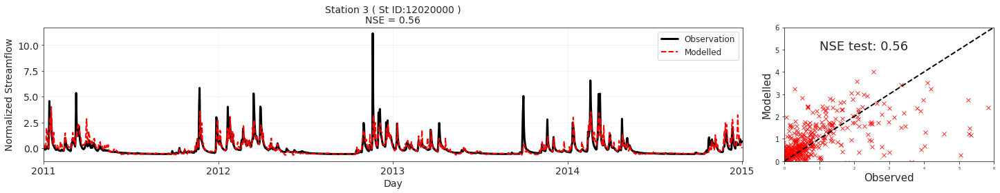

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'CNN_LSTM/y_test_fine_predict_0.csv',header=None))
# for inds in range(Nstations):
plot_st_streamFlow('CNN_LSTM',y_test,y_predict_fin,NSE_fine, 3,0)


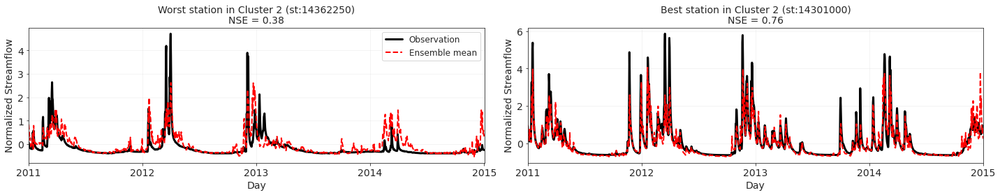

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'CNN_LSTM/y_test_fine_predict_0.csv',header=None))
plot_best_worst(y_test,y_predict_fin,NSE_fine, cluster=2)


In [ ]:
Ntest

1461

<ipython-input-142-cc41ab5ba9dd>:97: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


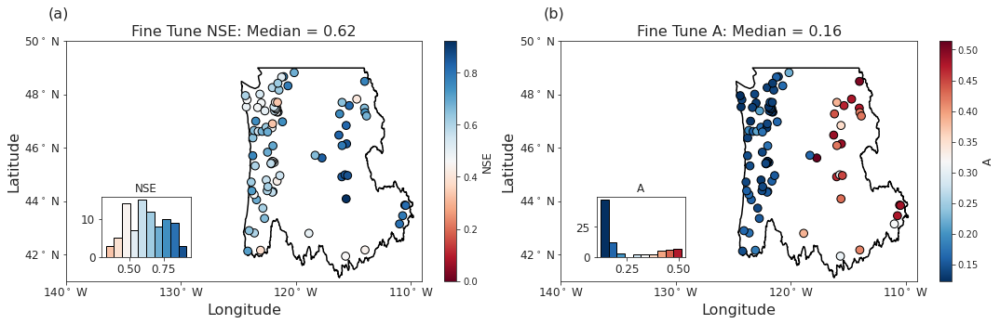

In [ ]:
#Visualize NSE and A in space for all stations

saveIt = 0
saveEPS = 0

fs = 16

fig, ax_maps = plt.subplots(nrows = 1, ncols = 2, figsize = (15,5))

########## NSE in space

##### map of NSE

# ax_map = fig.add_subplot(1,1,1)

vmin = 0
vmax = np.max(NSE_fine)
plot_prov_ax('17', ax = ax_maps[0])
s = ax_maps[0].scatter(stationLon.iloc[stationInds], stationLat.iloc[stationInds], c = NSE_fine, s = 75, zOrder = 3, edgecolor = 'k', cmap = 'RdBu', vmin = vmin, vmax = vmax)
cb = plt.colorbar(s, ax = ax_maps[0])#, orientation = 'horizontal')
cb.set_label('NSE', fontsize = 12)
ax_maps[0].set_ylim((41,50))
ax_maps[0].tick_params(labelsize = fs)
ax_maps[0].set_xlabel('Longitude', fontsize = fs)
ax_maps[0].set_ylabel('Latitude', fontsize = fs)
ax_maps[0].set_title('Fine Tune NSE: Median = ' + str(np.round(np.median(NSE_fine), decimals = 2)), fontsize = fs)
ax_maps[0].text(x = -0.05, y = 1.1, s = '(a)', transform = ax_maps[0].transAxes, fontsize = fs)
ax_maps[0].set_xticks(np.arange(-140,-100,10))

##### histogram of NSE

ax_hist_NSE = plt.axes([0,0,1,1], label = 'NSE_hist')
ip = InsetPosition(ax_maps[0], [0.1,0.1,0.25,0.25])
ax_hist_NSE.set_axes_locator(ip)

mapname = 'RdBu'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

n, bins, patches = ax_hist_NSE.hist(NSE_fine, edgecolor = 'k')
colours = scalarMap.to_rgba(bins)
kk = 0
for patch in patches:
  patch.set_facecolor(colours[kk])
  kk+=1

ax_hist_NSE.set_title('NSE', fontsize = fs-4)
#ax_hist_NSE.set_ylabel('Frequency', fontsize = fs-4)
ax_hist_NSE.set_frame_on = False
ax_hist_NSE.tick_params(labelsize = fs-4)


########## A in space

##### map of A

# ax_map = fig.add_subplot(1,1,1)

vmin = np.min(A_fine)
vmax = np.max(A_fine)
plot_prov_ax('17', ax = ax_maps[1])
s = ax_maps[1].scatter(stationLon.iloc[stationInds], stationLat.iloc[stationInds], c = A_fine, s = 75, zOrder = 3, edgecolor = 'k', cmap = 'RdBu_r', vmin = vmin, vmax = vmax)
cb = plt.colorbar(s, ax = ax_maps[1])#, orientation = 'horizontal')
cb.set_label('A', fontsize = 12)
ax_maps[1].set_ylim((41,50))
ax_maps[1].tick_params(labelsize = fs)
ax_maps[1].set_xlabel('Longitude', fontsize = fs)
ax_maps[1].set_ylabel('Latitude', fontsize = fs)
ax_maps[1].set_title('Fine Tune A: Median = ' + str(np.round(np.median(A_fine), decimals = 2)), fontsize = fs)
ax_maps[1].text(x = -0.05, y = 1.1, s = '(b)', transform = ax_maps[1].transAxes, fontsize = fs)
ax_maps[1].set_xticks(np.arange(-140,-100,10))

##### histogram of A

ax_hist_A = plt.axes([0,0,1,1], label = 'A_hist')
ip = InsetPosition(ax_maps[1], [0.1,0.1,0.25,0.25])
ax_hist_A.set_axes_locator(ip)

mapname = 'RdBu_r'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

n, bins, patches = ax_hist_A.hist(A_fine, edgecolor = 'k')
colours = scalarMap.to_rgba(bins)
kk = 0
for patch in patches:
  patch.set_facecolor(colours[kk])
  kk+=1

ax_hist_A.set_title('A', fontsize = fs-4)
#ax_hist_A.set_ylabel('Frequency', fontsize = fs-4)
ax_hist_A.set_frame_on = False
ax_hist_A.tick_params(labelsize = fs-4)

fig.tight_layout()

xtls = [item.get_text()[1:] + '$^\circ$ W' for item in ax_maps[0].get_xticklabels()]
ax_maps[0].set_xticklabels(xtls, fontsize = 12)
ytls = [item.get_text() + '$^\circ$ N' for item in ax_maps[0].get_yticklabels()]
ax_maps[0].set_yticklabels(ytls, fontsize = 12)

xtls = [item.get_text()[1:] + '$^\circ$ W' for item in ax_maps[1].get_xticklabels()]
ax_maps[1].set_xticklabels(xtls, fontsize = 12)
ytls = [item.get_text() + '$^\circ$ N' for item in ax_maps[1].get_yticklabels()]
ax_maps[1].set_yticklabels(ytls, fontsize = 12)

if saveIt:
  plt.savefig('NSE_A_map_hist.png', bbox_inches = 'tight', dpi = 300)
if saveEPS:
  plt.savefig('NSE_A_map_hist.eps', format = 'eps', bbox_inches='tight')

plt.show()

<ipython-input-143-7e7b24be8fb6>:107: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


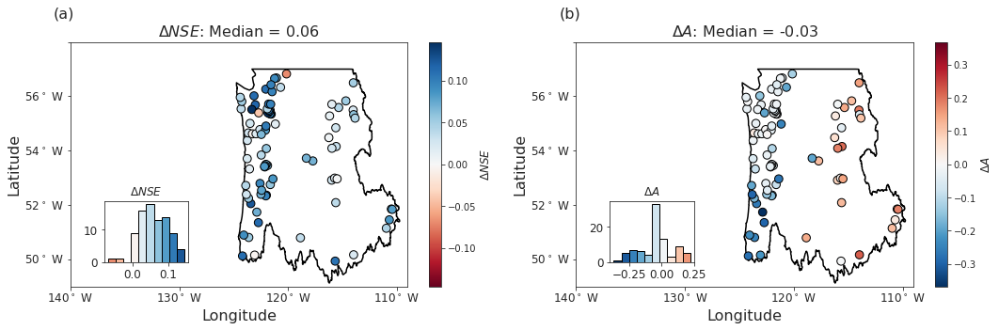

In [ ]:
#Visualize \DeltaNSE and \DeltaA in space for all stations

saveIt = 0
saveEPS = 0

fs = 16

fig, ax_maps = plt.subplots(nrows = 1, ncols = 2, figsize = (15,5))

dNSE = NSE_fine - NSE_bulk
dNSE_crop = np.sort(dNSE)[:-1] #dNSE w/ largest removed (largest > 1, 2nd largest <0.3; remove largest for readability)
dA = A_fine - A_bulk

########## dNSE in space

##### map of dNSE

vmax = np.max(np.abs(dNSE_crop))
vmin = -vmax
plot_prov_ax('17', ax = ax_maps[0])
s = ax_maps[0].scatter(stationLon.iloc[stationInds], stationLat.iloc[stationInds], c = dNSE, s = 75, zOrder = 3, edgecolor = 'k', cmap = 'RdBu', vmin = vmin, vmax = vmax)
cb = plt.colorbar(s, ax = ax_maps[0])#, orientation = 'horizontal')
cb.set_label('$\Delta NSE$', fontsize = 12)
ax_maps[0].set_ylim((41,50))
ax_maps[0].tick_params(labelsize = fs)
ax_maps[0].set_xlabel('Longitude', fontsize = fs)
ax_maps[0].set_ylabel('Latitude', fontsize = fs)
ax_maps[0].set_title('$\Delta NSE$: Median = ' + str(np.round(np.median(dNSE), decimals = 2)), fontsize = fs)
ax_maps[0].text(x = -0.05, y = 1.1, s = '(a)', transform = ax_maps[0].transAxes, fontsize = fs)
ax_maps[0].set_xticks(np.arange(-140,-100,10))

##### histogram of dNSE

ax_hist_NSE = plt.axes([0,0,1,1], label = 'dNSE_hist')
ip = InsetPosition(ax_maps[0], [0.1,0.1,0.25,0.25])
ax_hist_NSE.set_axes_locator(ip)

mapname = 'RdBu'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

n, bins, patches = ax_hist_NSE.hist(dNSE_crop, edgecolor = 'k')
colours = scalarMap.to_rgba(bins)
kk = 0
for patch in patches:
  patch.set_facecolor(colours[kk])
  kk+=1

ax_hist_NSE.set_title('$\Delta NSE$', fontsize = fs-4)
#ax_hist_NSE.set_ylabel('Frequency', fontsize = fs-4)
ax_hist_NSE.set_frame_on = False
ax_hist_NSE.tick_params(labelsize = fs-4)


########## dA in space

##### map of A

vmax = np.max(np.abs(dA))
vmin = -vmax
plot_prov_ax('17', ax = ax_maps[1])
s = ax_maps[1].scatter(stationLon.iloc[stationInds], stationLat.iloc[stationInds], c = dA, s = 75, zOrder = 3, edgecolor = 'k', cmap = 'RdBu_r', vmin = vmin, vmax = vmax)
cb = plt.colorbar(s, ax = ax_maps[1])#, orientation = 'horizontal')
cb.set_label('$\Delta A$', fontsize = 12)
ax_maps[1].set_ylim((41,50))
ax_maps[1].tick_params(labelsize = fs)
ax_maps[1].set_xlabel('Longitude', fontsize = fs)
ax_maps[1].set_ylabel('Latitude', fontsize = fs)
ax_maps[1].set_title('$\Delta A$: Median = ' + str(np.round(np.median(dA), decimals = 2)), fontsize = fs)
ax_maps[1].text(x = -0.05, y = 1.1, s = '(b)', transform = ax_maps[1].transAxes, fontsize = fs)
ax_maps[1].set_xticks(np.arange(-140,-100,10))

##### histogram of A

ax_hist_A = plt.axes([0,0,1,1], label = 'dA_hist')
ip = InsetPosition(ax_maps[1], [0.1,0.1,0.25,0.25])
ax_hist_A.set_axes_locator(ip)

mapname = 'RdBu_r'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

n, bins, patches = ax_hist_A.hist(dA, edgecolor = 'k')
colours = scalarMap.to_rgba(bins)
kk = 0
for patch in patches:
  patch.set_facecolor(colours[kk])
  kk+=1

ax_hist_A.set_title('$\Delta A$', fontsize = fs-4)
#ax_hist_A.set_ylabel('Frequency', fontsize = fs-4)
ax_hist_A.set_frame_on = False
ax_hist_A.tick_params(labelsize = fs-4)

xtls = [str(np.abs(val)) + '$^\circ$ W' for val in np.arange(-140,-100,10)]
ax_maps[0].set_xticklabels(xtls, fontsize = 12)
ytls = [str(val) + '$^\circ$ W' for val in np.arange(48,58,2)]
ax_maps[0].set_yticklabels(ytls, fontsize = 12)

xtls = [str(np.abs(val)) + '$^\circ$ W' for val in np.arange(-140,-100,10)]
ax_maps[1].set_xticklabels(xtls, fontsize = 12)
ytls = [str(val) + '$^\circ$ W' for val in np.arange(48,58,2)]
ax_maps[1].set_yticklabels(ytls, fontsize = 12)

fig.tight_layout()

if saveIt:
  plt.savefig('dNSE_dA_map_hist.png', bbox_inches = 'tight', dpi = 300)
if saveEPS:
  plt.savefig('dNSE_dA_map_hist.eps', format = 'eps', bbox_inches='tight')

plt.show()

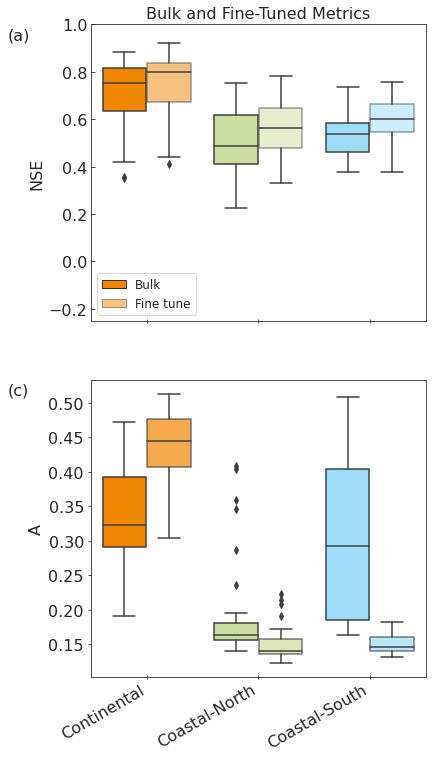

In [ ]:
##### NSE, D, and A for bulk and fine-tune all at once

saveIt = 0
saveEPS = 0

fs = 16 #fontsize

fig, axes = plt.subplots(nrows = 2, ncols = 1, figsize = (6,12))


#################### NSE

#x: cluster labels; y: NSE; hue: bulk/fine
boxx_bulk = seasonal_clustering.labels_
boxx_fine = seasonal_clustering.labels_

# boxy_bulk = np.mean(NSE_bulk_runs, axis = 0) #average NSE across model runs for each station
# boxy_fine = np.mean(NSE_fine_runs, axis = 0)

boxy_bulk = NSE_bulk
boxy_fine = NSE_fine

boxx = np.hstack((boxx_bulk, boxx_fine))
boxy = np.hstack((boxy_bulk, boxy_fine))

hue = np.hstack((['Bulk' for kk in range(len(dNSE))], ['Fine tune' for kk in range(len(dNSE))]))

bp = sns.boxplot(x = boxx, y = boxy, hue = hue, ax = axes[0])
for kk in range(n_clusters_seasonal):
  bp.artists[2*kk].set_facecolor(rgbs_array[kk]) #manually set colour of boxes to match our clusters
  bp.artists[2*kk+1].set_facecolor(rgbs_array[kk])
  bp.artists[2*kk+1].set_alpha(0.5) #fine-tuned boxes set partially transparent

axes[0].set_ylabel('NSE', fontsize = fs)
axes[0].set_title('Bulk and Fine-Tuned Metrics', fontsize = fs)
axes[0].tick_params(labelsize = fs, labelbottom = False, direction = 'in')
axes[0].tick_params(axis = 'x', direction = 'inout')
#axes[0].set_ylim((-0.5,1))
axes[0].set_ylim((-0.25,1))
axes[0].text(x = -0.25, y = 0.95, s = '(a)', transform = axes[0].transAxes, fontsize = fs)
axes[0].set_xticklabels(cluster_names, rotation = 30, ha = 'right')

leg = axes[0].legend(loc = 'lower left', fontsize = fs-4)
leg.legendHandles[0].set_color(rgbs_array[0])
leg.legendHandles[0].set_edgecolor('k')
leg.legendHandles[1].set_color(rgbs_array[0])
leg.legendHandles[1].set_alpha(0.5)
leg.legendHandles[1].set_edgecolor('k')


#################### A

#x: cluster labels; y: A; hue: bulk/fine
# boxy_bulk = np.empty(np.shape(boxx_bulk))
# boxy_fine = np.empty(np.shape(boxx_fine))

# boxy_bulk = np.mean(A_bulk_runs, axis = 0) #average A across model runs for each station
# boxy_fine = np.mean(A_fine_runs, axis = 0)

boxy_bulk = A_bulk
boxy_fine = A_fine

boxx = np.hstack((boxx_bulk, boxx_fine))
boxy = np.hstack((boxy_bulk, boxy_fine))

hue = np.hstack((['Bulk' for kk in range(len(dA))], ['Fine tune' for kk in range(len(dA))]))
bp = sns.boxplot(x = boxx, y = boxy, hue = hue, ax = axes[1])
bp.get_legend().remove()
for kk in range(n_clusters_seasonal):
  bp.artists[2*kk].set_facecolor(rgbs_array[kk]) #manually set colour of boxes to match our clusters
  bp.artists[2*kk+1].set_facecolor(rgbs_array[kk])
  bp.artists[2*kk+1].set_alpha(0.7) #fine-tuned boxes set partially transparent

axes[1].set_ylabel('A', fontsize = fs)
axes[1].tick_params(labelsize = fs)
axes[1].tick_params(axis = 'x', direction = 'inout')
axes[1].text(x = -0.25, y = 0.95, s = '(c)', transform = axes[1].transAxes, fontsize = fs)
axes[1].set_xticklabels(cluster_names, rotation = 30, ha = 'right')



if saveIt:
  plt.savefig('NSE_A_D_bulk_fine.png', bbox_inches = 'tight', dpi = 300)
if saveEPS:
  plt.savefig('NSE_A_D_bulk_fine.eps', format = 'eps', bbox_inches='tight')
plt.show()

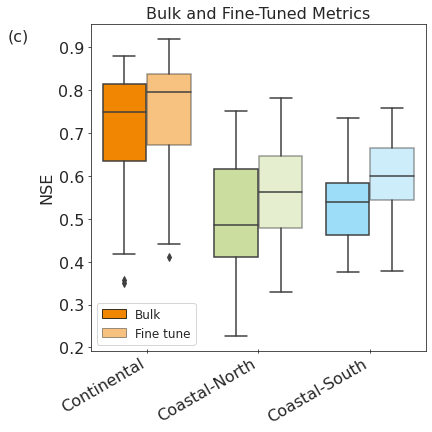

In [ ]:
plot_NSEs_box(NSE_bulk,NSE_fine, 0)

# Training bulk and fine-tuned model with CNN part (No lstm )

In [ ]:
#train bulk and fine-tuned for CNN
#set of random seeds to use for reproducability
seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 5,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_bulk_model_CNN(learning_rate = learning_rate)
  model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks]
  )
  #predict train/val/test streamflow
  y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
  y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
  y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


  #save bulk model outputs
  file_train = 'CNN_only/y_train_bulk_predict_' + str(ii) + '.csv' #ii is the model number
  file_val = 'CNN_only/y_val_bulk_predict_' + str(ii) + '.csv'
  file_test = 'CNN_only/y_test_bulk_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'CNN_only/model_bulk_' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)


##### FINE-TUNING

  #prep fine-tune target output
  y_train_predict_fine_all = np.empty_like(y_train)
  y_val_predict_fine_all = np.empty_like(y_val)
  y_test_predict_fine_all = np.empty_like(y_test)

  #for each streamflow cluster, make/train/save fine-tuned model/output/heatmaps

  for cluster in range(n_clusters_seasonal):

    print('Training fine model, cluster ' + str(cluster+1) + ' / ' + str(n_clusters_seasonal))

    stations_fine = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster)) #stations in this cluster
    N_stations = len(stations_fine) #number of stations in this cluster

    #create target datasets (note: x is the same, y is different (same spatial input, different station targets))
    y_train_fine_current = tf.convert_to_tensor(y_train.numpy()[:,stations_fine])
    y_val_fine_current = tf.convert_to_tensor(y_val.numpy()[:,stations_fine])
    y_test_fine_current = tf.convert_to_tensor(y_test.numpy()[:,stations_fine])

    train_dataset_fine = tf.data.Dataset.from_tensor_slices((x_train,y_train_fine_current)).shuffle(Ntrain).batch(batch_size = batch_size)
    val_dataset_fine = tf.data.Dataset.from_tensor_slices((x_val,y_val_fine_current)).shuffle(Nval).batch(batch_size = batch_size)

    #build and train fine-tuned model
    model_fine = build_fine_model(model_bulk = model_bulk, N_stations = N_stations, learning_rate = learning_rate)
    model_fine.fit(
      train_dataset_fine,
      validation_data = val_dataset_fine,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )

    #predict train/val/test streamflow
    y_train_predict_fine = model_fine.predict(x_train, batch_size = batch_size, verbose = 0)
    y_val_predict_fine = model_fine.predict(x_val, batch_size = batch_size, verbose = 0)
    y_test_predict_fine = model_fine.predict(x_test, batch_size = batch_size, verbose = 0)

    #reorganize predictions into array that matches the bulk train/val/test structure
    for kk, station_fine in enumerate(stations_fine): #for each station/index in this cluster
      y_train_predict_fine_all[:,station_fine] = y_train_predict_fine[:,kk] #y_***_predict_fine_all has fine-tuned predictions for all stations, in same order as bulk
      y_val_predict_fine_all[:,station_fine] = y_val_predict_fine[:,kk]
      y_test_predict_fine_all[:,station_fine] = y_test_predict_fine[:,kk]

    #save model
    model_name = 'CNN_only/model_fine_' + str(ii) + '_cluster_' + str(cluster) + '.h5'
    model_fine.save(dir_models + '/' + model_name)



  #save fine-tuned model predictions
  file_train = 'CNN_only/y_train_fine_predict_' + str(ii) + '.csv'
  file_val = 'CNN_only/y_val_fine_predict_' + str(ii) + '.csv'
  file_test = 'CNN_only/y_test_fine_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_fine_all, delimiter = ',')




Training bulk model 1 / 1


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch 1/50
120/120 [==============================] - 85s 600ms/step - loss: 0.7532 - val_loss: 0.6542
Epoch 2/50
120/120 [==============================] - 70s 578ms/step - loss: 0.6524 - val_loss: 0.6174
Epoch 3/50
120/120 [==============================] - 70s 574ms/step - loss: 0.5908 - val_loss: 0.5880
Epoch 4/50
120/120 [==============================] - 70s 574ms/step - loss: 0.5468 - val_loss: 0.5667
Epoch 5/50
120/120 [==============================] - 70s 574ms/step - loss: 0.5139 - val_loss: 0.5415
Epoch 6/50
120/120 [==============================] - 70s 574ms/step - loss: 0.4902 - val_loss: 0.5263
Epoch 7/50
120/120 [==============================] - 70s 574ms/step - loss: 0.4723 - val_loss: 0.5144
Epoch 8/50
120/120 [==============================] - 70s 579ms/step - loss: 0.4527 - val_loss: 0.5053
Epoch 9/50
120/120 [==============================] - 70s 574ms/step - loss: 0.4376 - val_loss: 0.5022
Epoch 10/50
120/120 [==============================] - 70s 574ms/step - l

In [ ]:
#compare results from different model runs

#model runs to explore
runs = [0]
Nruns = len(runs)

#initialize
NSE_fine_runs = np.empty((Nruns, Nstations)) #fine-tuned NSE on test set
NSE_bulk_runs = np.empty((Nruns, Nstations)) #bulk NSE on test set
dNSE_runs = np.empty((Nruns, Nstations)) #difference in NSE from fine-tuning

A_fine_runs = np.empty((Nruns, Nstations)) #A from fine-tuned heatmaps on test set
A_bulk_runs = np.empty((Nruns, Nstations)) #A from bulk heatmaps on test set
dA_runs = np.empty((Nruns, Nstations)) #difference in A from fine-tuning

heat_mean_fine_runs = np.empty((Nruns, Npx, Nstations)) #fine-tuned heatmaps of each run
heat_mean_bulk_runs = np.empty((Nruns, Npx, Nstations)) #bulk heatmaps of each run

y_test_predict_bulk_runs = np.empty((Nruns, Ntest, Nstations)) #bulk model predictions of each run
y_test_predict_fine_runs = np.empty((Nruns, Ntest, Nstations)) #fine-tuned model predictions of each run

y_all_predict_fine_runs = np.empty((Nruns, Ntrain + Nval + Ntest , Nstations))

#loop through each run, open model outputs/heatmaps, calculate NSE and A
for ii, run in enumerate(runs):

  print('Run ' + str(run))

  #load modelled streamflow
  filename_train_bulk = 'CNN_only/y_train_bulk_predict_' + str(run) + '.csv'
  filename_val_bulk = 'CNN_only/y_val_bulk_predict_' + str(run) + '.csv'
  filename_test_bulk = 'CNN_only/y_test_bulk_predict_' + str(run) + '.csv'
  filename_train_fine = 'CNN_only/y_train_fine_predict_' + str(run) + '.csv'
  filename_val_fine = 'CNN_only/y_val_fine_predict_' + str(run) + '.csv'
  filename_test_fine = 'CNN_only/y_test_fine_predict_' + str(run) + '.csv'
  y_train_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_train_bulk, header = None))
  y_val_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_val_bulk, header = None))
  y_test_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_test_bulk, header = None))
  y_train_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_train_fine, header = None))
  y_val_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_val_fine, header = None))
  y_test_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_test_fine, header = None))
  y_test_predict_bulk_runs[ii,:,:] = y_test_predict_bulk
  y_test_predict_fine_runs[ii,:,:] = y_test_predict_fine
  y_all_predict_fine_runs[ii,:,:] = np.vstack((y_train_predict_fine, y_val_predict_fine, y_test_predict_fine))


  #initialize NSE train/val/test bulk/fine and A bulk/fine arrays of this current run
  NSE_fine = np.empty((Nstations,))
  NSE_bulk = np.empty((Nstations,))
  NSE_train_fine = np.empty((Nstations,))
  NSE_train_bulk = np.empty((Nstations,))
  NSE_val_fine = np.empty((Nstations,))
  NSE_val_bulk = np.empty((Nstations,))
  NSE_test_fine = np.empty((Nstations,))
  NSE_test_bulk = np.empty((Nstations,))


  #loop through each station and calculate NSE and A
  for station in range(Nstations):

#####calculate NSE

    #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
    NSE_train_fine[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_fine[:,station]
        )
    NSE_val_fine[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_fine[:,station]
        )
    NSE_test_fine[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_fine[:,station]
        )
    NSE_train_bulk[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_bulk[:,station]
        )
    NSE_val_bulk[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_bulk[:,station]
        )
    NSE_test_bulk[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_bulk[:,station]
        )

#also calculate NSE of the model ensemble average streamflow, rather than model-by-model NSE

NSE_bulk = np.empty(Nstations)
NSE_fine = np.empty(Nstations)

for station in range(Nstations):

  NSE_bulk[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_bulk_runs,axis = 0)[:,station]
  )

  NSE_fine[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_fine_runs,axis = 0)[:,station]
  )

print('Median NSE test bulk ensemble = ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('Median NSE test fine ensemble = ' + str(np.round(np.median(NSE_fine), decimals = 2)))



Run 0
Median NSE test bulk ensemble = 0.48
Median NSE test fine ensemble = 0.51


In [ ]:
# save NSES
# file_nse_test_bulk = 'CNN_only/NSE_test_bulk.csv' #ii is the model number
# file_nse_test_fine = 'CNN_only/NSE_test_fine.csv'

# file_nse_train_bulk = 'CNN_only/NSE_train_bulk.csv' #ii is the model number
# file_nse_train_fine = 'CNN_only/NSE_train_fine.csv'

# file_nse_val_bulk = 'CNN_only/NSE_val_bulk.csv' #ii is the model number
# file_nse_val_fine = 'CNN_only/NSE_val_fine.csv'

# np.savetxt(dir_output + '/' + file_nse_test_bulk, NSE_test_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_test_fine, NSE_test_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_train_bulk, NSE_train_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_train_fine, NSE_train_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_val_bulk, NSE_val_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_val_fine, NSE_val_fine, delimiter = ',')

In [ ]:
print('\nFine-tuned model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_fine), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_test_fine), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_test_fine), decimals = 2)))

print('\nbulk-model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_bulk), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_test_bulk), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_test_bulk), decimals = 2)))


Fine-tuned model: 
	Minimum NSE: -0.17
	Median NSE: 0.51
	Maximum NSE: 0.76

bulk-model: 
	Minimum NSE: -0.15
	Median NSE: 0.48
	Maximum NSE: 0.73


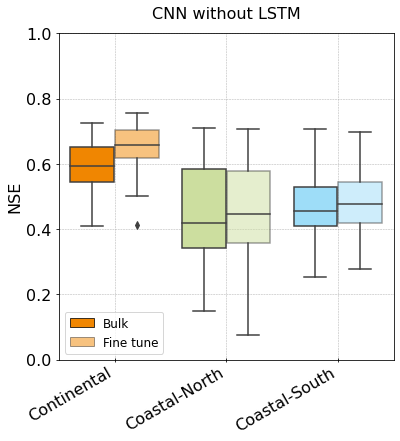

In [ ]:
plot_NSEs_box('CNN_only','CNN without LSTM',NSE_bulk,NSE_fine,1)

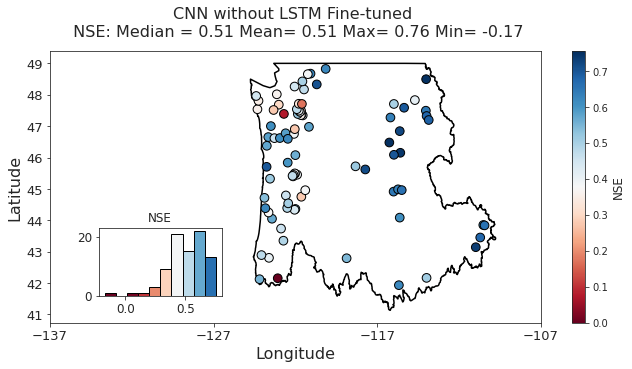

In [ ]:
plot_nses_spatially('CNN_only','CNN without LSTM Fine-tuned', NSE_fine,1,'Fine')

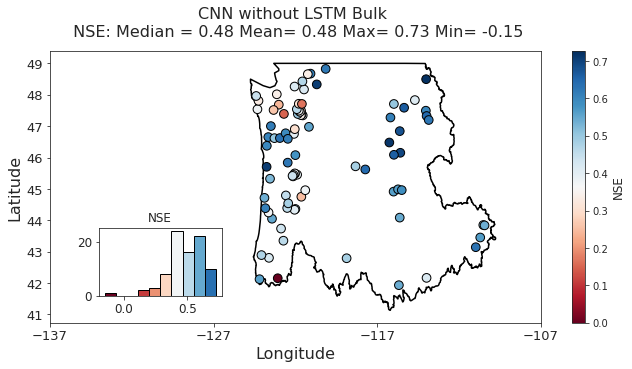

In [ ]:
plot_nses_spatially('CNN_only','CNN without LSTM Bulk', NSE_bulk,1,'Bulk')

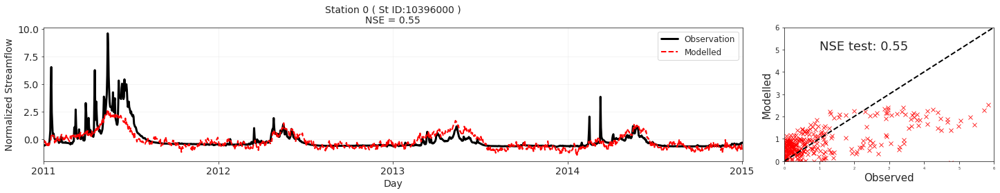

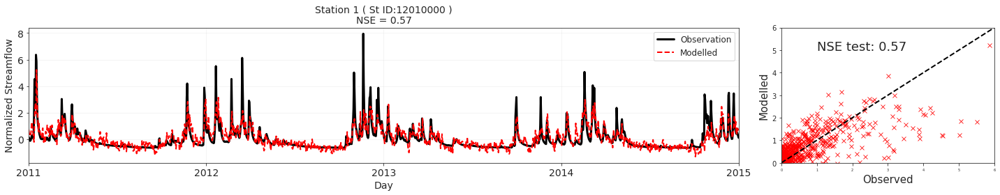

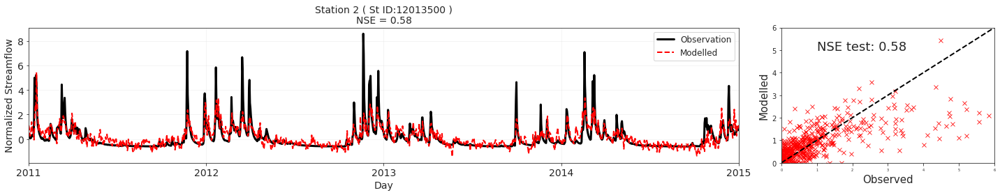

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'CNN_only/y_test_fine_predict_0.csv',header=None))
for inds in range(3):
  plot_st_streamFlow('CNN_only',y_test,y_predict_fin,NSE_fine, inds,0)

# LSTM model without CNN (using ERA forcing )

In [ ]:
#train bulk and fine-tuned for CNN
#set of random seeds to use for reproducability
seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 5,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_LSTM_Model_era(learning_rate = learning_rate)
  model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks]
  )
  #predict train/val/test streamflow
  y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
  y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
  y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


  #save bulk model outputs
  file_train = 'LSTM_only_era/y_train_bulk_predict_' + str(ii) + '.csv' #ii is the model number
  file_val = 'LSTM_only_era/y_val_bulk_predict_' + str(ii) + '.csv'
  file_test = 'LSTM_only_era/y_test_bulk_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'LSTM_only_era/model_bulk_' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)


##### FINE-TUNING

  #prep fine-tune target output
  y_train_predict_fine_all = np.empty_like(y_train)
  y_val_predict_fine_all = np.empty_like(y_val)
  y_test_predict_fine_all = np.empty_like(y_test)

  #for each streamflow cluster, make/train/save fine-tuned model/output/heatmaps

  for cluster in range(n_clusters_seasonal):

    print('Training fine model, cluster ' + str(cluster+1) + ' / ' + str(n_clusters_seasonal))

    stations_fine = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster)) #stations in this cluster
    N_stations = len(stations_fine) #number of stations in this cluster

    #create target datasets (note: x is the same, y is different (same spatial input, different station targets))
    y_train_fine_current = tf.convert_to_tensor(y_train.numpy()[:,stations_fine])
    y_val_fine_current = tf.convert_to_tensor(y_val.numpy()[:,stations_fine])
    y_test_fine_current = tf.convert_to_tensor(y_test.numpy()[:,stations_fine])

    train_dataset_fine = tf.data.Dataset.from_tensor_slices((x_train,y_train_fine_current)).shuffle(Ntrain).batch(batch_size = batch_size)
    val_dataset_fine = tf.data.Dataset.from_tensor_slices((x_val,y_val_fine_current)).shuffle(Nval).batch(batch_size = batch_size)

    #build and train fine-tuned model
    model_fine = build_fine_model(model_bulk = model_bulk, N_stations = N_stations, learning_rate = learning_rate)
    model_fine.fit(
      train_dataset_fine,
      validation_data = val_dataset_fine,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )

    #predict train/val/test streamflow
    y_train_predict_fine = model_fine.predict(x_train, batch_size = batch_size, verbose = 0)
    y_val_predict_fine = model_fine.predict(x_val, batch_size = batch_size, verbose = 0)
    y_test_predict_fine = model_fine.predict(x_test, batch_size = batch_size, verbose = 0)

    #reorganize predictions into array that matches the bulk train/val/test structure
    for kk, station_fine in enumerate(stations_fine): #for each station/index in this cluster
      y_train_predict_fine_all[:,station_fine] = y_train_predict_fine[:,kk] #y_***_predict_fine_all has fine-tuned predictions for all stations, in same order as bulk
      y_val_predict_fine_all[:,station_fine] = y_val_predict_fine[:,kk]
      y_test_predict_fine_all[:,station_fine] = y_test_predict_fine[:,kk]

    #save model
    model_name = 'LSTM_only_era/model_fine_' + str(ii) + '_cluster_' + str(cluster) + '.h5'
    model_fine.save(dir_models + '/' + model_name)



  #save fine-tuned model predictions
  file_train = 'LSTM_only_era/y_train_fine_predict_' + str(ii) + '.csv'
  file_val = 'LSTM_only_era/y_val_fine_predict_' + str(ii) + '.csv'
  file_test = 'LSTM_only_era/y_test_fine_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_fine_all, delimiter = ',')




Training bulk model 1 / 1


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch 1/50
120/120 [==============================] - 17s 62ms/step - loss: 0.9218 - val_loss: 0.7443
Epoch 2/50
120/120 [==============================] - 7s 50ms/step - loss: 0.7287 - val_loss: 0.5999
Epoch 3/50
120/120 [==============================] - 7s 50ms/step - loss: 0.6009 - val_loss: 0.5338
Epoch 4/50
120/120 [==============================] - 7s 50ms/step - loss: 0.5420 - val_loss: 0.5062
Epoch 5/50
120/120 [==============================] - 7s 53ms/step - loss: 0.5072 - val_loss: 0.4845
Epoch 6/50
120/120 [==============================] - 7s 51ms/step - loss: 0.4852 - val_loss: 0.4783
Epoch 7/50
120/120 [==============================] - 7s 50ms/step - loss: 0.4664 - val_loss: 0.4617
Epoch 8/50
120/120 [==============================] - 7s 50ms/step - loss: 0.4538 - val_loss: 0.4558
Epoch 9/50
120/120 [==============================] - 7s 50ms/step - loss: 0.4382 - val_loss: 0.4680
Epoch 10/50
120/120 [==============================] - 7s 51ms/step - loss: 0.4318 - val_l

In [ ]:
#compare results from different model runs

#model runs to explore
runs = [0]
Nruns = len(runs)

#initialize
NSE_fine_runs = np.empty((Nruns, Nstations)) #fine-tuned NSE on test set
NSE_bulk_runs = np.empty((Nruns, Nstations)) #bulk NSE on test set
dNSE_runs = np.empty((Nruns, Nstations)) #difference in NSE from fine-tuning

A_fine_runs = np.empty((Nruns, Nstations)) #A from fine-tuned heatmaps on test set
A_bulk_runs = np.empty((Nruns, Nstations)) #A from bulk heatmaps on test set
dA_runs = np.empty((Nruns, Nstations)) #difference in A from fine-tuning

heat_mean_fine_runs = np.empty((Nruns, Npx, Nstations)) #fine-tuned heatmaps of each run
heat_mean_bulk_runs = np.empty((Nruns, Npx, Nstations)) #bulk heatmaps of each run

y_test_predict_bulk_runs = np.empty((Nruns, Ntest, Nstations)) #bulk model predictions of each run
y_test_predict_fine_runs = np.empty((Nruns, Ntest, Nstations)) #fine-tuned model predictions of each run

y_all_predict_fine_runs = np.empty((Nruns, Ntrain + Nval + Ntest , Nstations))

#loop through each run, open model outputs/heatmaps, calculate NSE and A
for ii, run in enumerate(runs):

  print('Run ' + str(run))

  #load modelled streamflow
  filename_train_bulk = 'LSTM_only_era/y_train_bulk_predict_' + str(run) + '.csv'
  filename_val_bulk = 'LSTM_only_era/y_val_bulk_predict_' + str(run) + '.csv'
  filename_test_bulk = 'LSTM_only_era/y_test_bulk_predict_' + str(run) + '.csv'
  filename_train_fine = 'LSTM_only_era/y_train_fine_predict_' + str(run) + '.csv'
  filename_val_fine = 'LSTM_only_era/y_val_fine_predict_' + str(run) + '.csv'
  filename_test_fine = 'LSTM_only_era/y_test_fine_predict_' + str(run) + '.csv'
  y_train_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_train_bulk, header = None))
  y_val_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_val_bulk, header = None))
  y_test_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_test_bulk, header = None))
  y_train_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_train_fine, header = None))
  y_val_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_val_fine, header = None))
  y_test_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_test_fine, header = None))
  y_test_predict_bulk_runs[ii,:,:] = y_test_predict_bulk
  y_test_predict_fine_runs[ii,:,:] = y_test_predict_fine
  y_all_predict_fine_runs[ii,:,:] = np.vstack((y_train_predict_fine, y_val_predict_fine, y_test_predict_fine))


  #initialize NSE train/val/test bulk/fine and A bulk/fine arrays of this current run
  NSE_fine = np.empty((Nstations,))
  NSE_bulk = np.empty((Nstations,))
  NSE_train_fine = np.empty((Nstations,))
  NSE_train_bulk = np.empty((Nstations,))
  NSE_val_fine = np.empty((Nstations,))
  NSE_val_bulk = np.empty((Nstations,))
  NSE_test_fine = np.empty((Nstations,))
  NSE_test_bulk = np.empty((Nstations,))


  #loop through each station and calculate NSE and A
  for station in range(Nstations):

#####calculate NSE

    #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
    NSE_train_fine[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_fine[:,station]
        )
    NSE_val_fine[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_fine[:,station]
        )
    NSE_test_fine[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_fine[:,station]
        )
    NSE_train_bulk[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_bulk[:,station]
        )
    NSE_val_bulk[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_bulk[:,station]
        )
    NSE_test_bulk[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_bulk[:,station]
        )

#also calculate NSE of the model ensemble average streamflow, rather than model-by-model NSE

NSE_bulk = np.empty(Nstations)
NSE_fine = np.empty(Nstations)

for station in range(Nstations):

  NSE_bulk[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_bulk_runs,axis = 0)[:,station]
  )

  NSE_fine[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_fine_runs,axis = 0)[:,station]
  )

print('Median NSE test bulk ensemble = ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('Median NSE test fine ensemble = ' + str(np.round(np.median(NSE_fine), decimals = 2)))



Run 0
Median NSE test bulk ensemble = 0.59
Median NSE test fine ensemble = 0.61


In [ ]:
# save NSES
file_nse_test_bulk = 'LSTM_only_era/NSE_test_bulk.csv' #ii is the model number
file_nse_test_fine = 'LSTM_only_era/NSE_test_fine.csv'

file_nse_train_bulk = 'LSTM_only_era/NSE_train_bulk.csv' #ii is the model number
file_nse_train_fine = 'LSTM_only_era/NSE_train_fine.csv'

file_nse_val_bulk = 'LSTM_only_era/NSE_val_bulk.csv' #ii is the model number
file_nse_val_fine = 'LSTM_only_era/NSE_val_fine.csv'

np.savetxt(dir_output + '/' + file_nse_test_bulk, NSE_test_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_test_fine, NSE_test_fine, delimiter = ',')

np.savetxt(dir_output + '/' + file_nse_train_bulk, NSE_train_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_train_fine, NSE_train_fine, delimiter = ',')

np.savetxt(dir_output + '/' + file_nse_val_bulk, NSE_val_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_val_fine, NSE_val_fine, delimiter = ',')

In [ ]:
print('\nFine-tuned model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_fine), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_test_fine), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_test_fine), decimals = 2)))

print('\nbulk-model: \n\tMinimum NSE: ' + str(np.round(np.min(NSE_bulk), decimals = 2)))
print('\tMedian NSE: ' + str(np.round(np.median(NSE_test_bulk), decimals = 2)))
print('\tMaximum NSE: ' + str(np.round(np.max(NSE_test_bulk), decimals = 2)))


Fine-tuned model: 
	Minimum NSE: 0.32
	Median NSE: 0.61
	Maximum NSE: 0.9

bulk-model: 
	Minimum NSE: 0.07
	Median NSE: 0.59
	Maximum NSE: 0.9


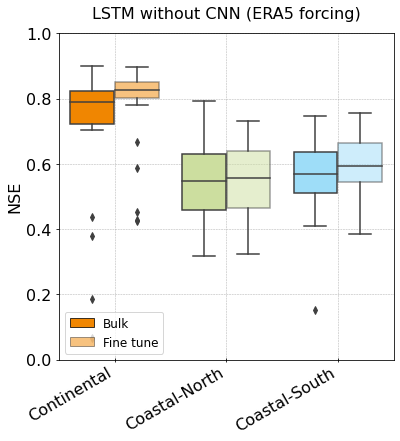

In [ ]:
plot_NSEs_box('LSTM_only_era','LSTM without CNN (ERA5 forcing)',NSE_bulk,NSE_fine,1)

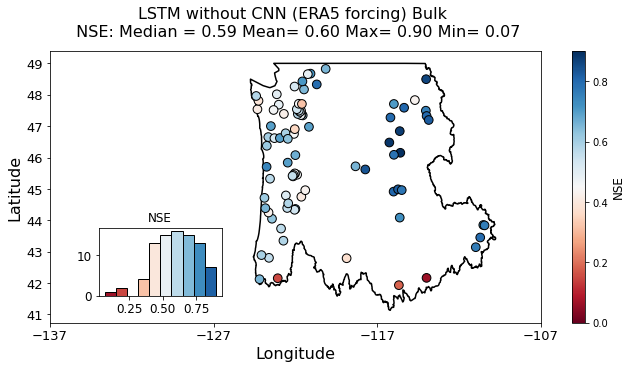

In [ ]:
plot_nses_spatially('LSTM_only_era','LSTM without CNN (ERA5 forcing) Bulk', NSE_bulk,1,'Bulk')

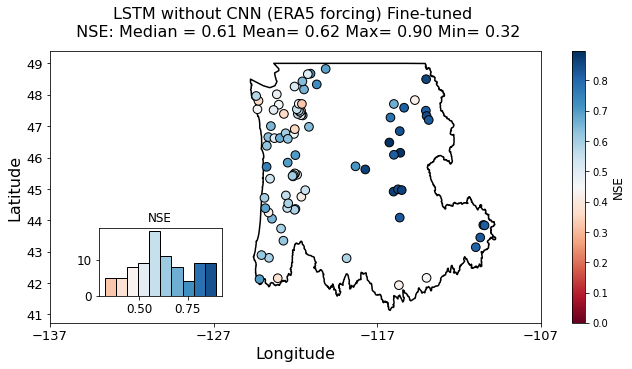

In [ ]:
plot_nses_spatially('LSTM_only_era','LSTM without CNN (ERA5 forcing) Fine-tuned', NSE_fine,1,'Fine')

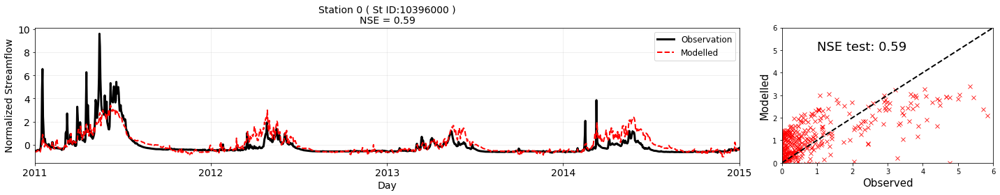

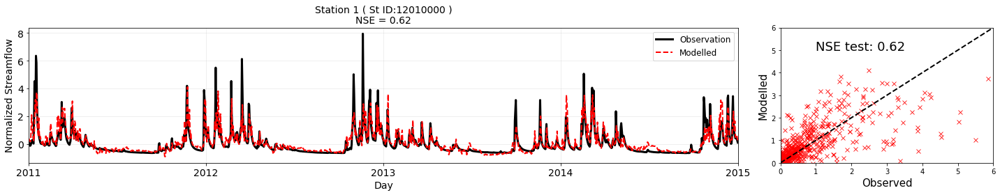

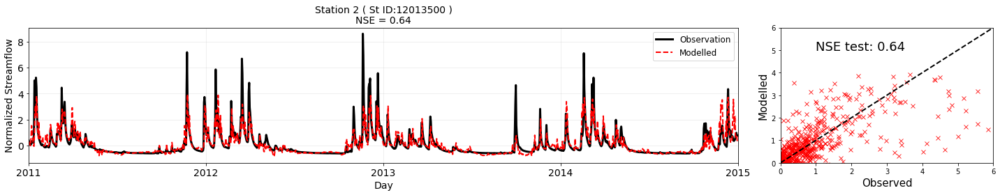

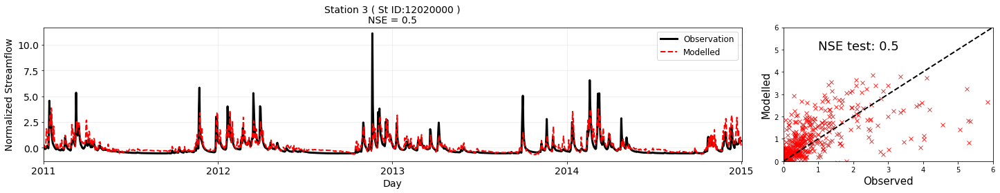

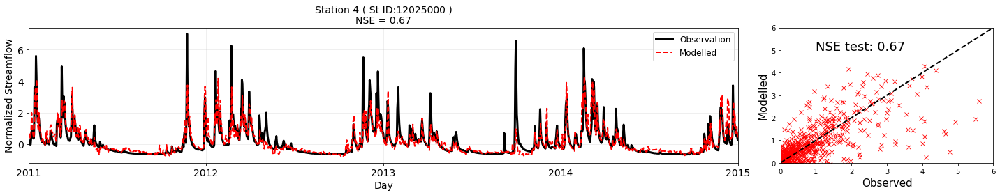

...

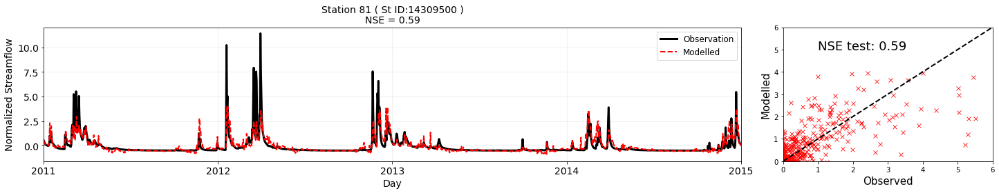

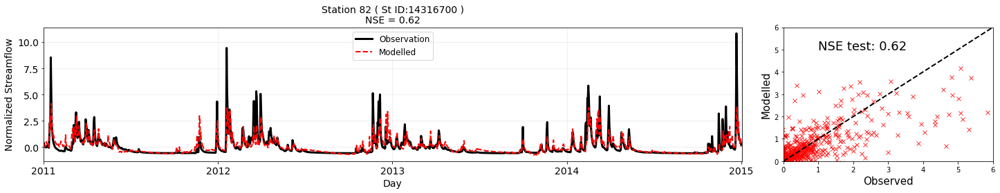

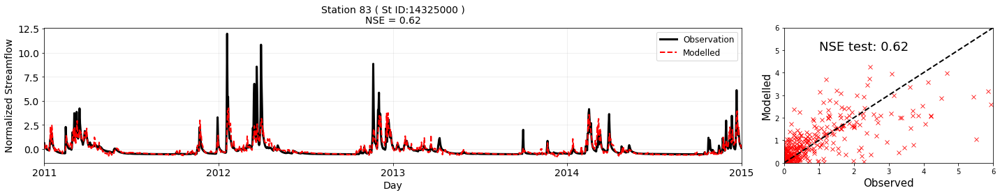

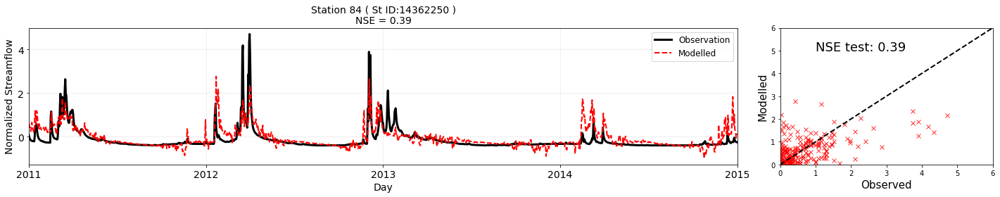

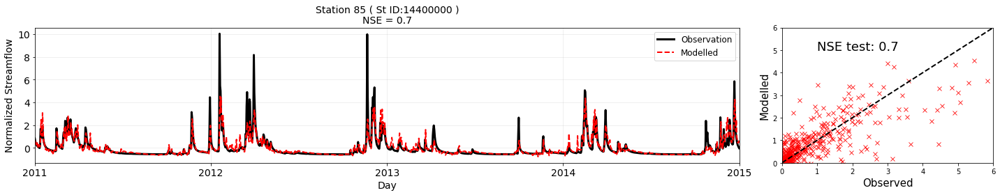

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'LSTM_only_era/y_test_fine_predict_0.csv',header=None))
for inds in range(Nstations):
    plot_st_streamFlow('LSTM_only_era',y_test,y_predict_fin,NSE_fine, inds,1)


# Modle with lstm only with camel forcing data (regional model )

## loading the data

In [ ]:
# loading the data p tmin and tmax
stationIds = list(map(lambda x: str(x), stationIds))
#load daily temperature data
pickle_in = open(dir_data + '/' + 'p_tmin_tmax_HU17.pickle','rb')
forcing_data = pickle.load(pickle_in)  # 0 for p 1 for tmin 2  for tmax
p    =    np.array(pd.DataFrame(forcing_data[0])[stationIds])
tmin = np.array(pd.DataFrame(forcing_data[1])[stationIds])
tmax= np.array(pd.DataFrame(forcing_data[2])[stationIds])


In [ ]:

np.shape(Fnorm)

(12784, 86)

In [ ]:
# normalizing the data

tmaxmean = np.mean(tmax,axis=0) # normlize for the whole data set not only training
tmaxstd = np.std(tmax,axis=0)
tmaxnorm = (tmax - tmaxmean)/tmaxstd
tmaxnorm = np.single(tmaxnorm)


tminmean = np.mean(tmin,axis=0) # normlize for the whole data set not only training
tminstd = np.std(tmin,axis=0)
tminnorm = (tmin - tminmean)/tminstd
tminnorm = np.single(tminnorm)

pmean = np.mean(p,axis=0) # normlize for the whole data set not only training
pstd = np.std(p,axis=0)
pnorm = (p - pmean)/pstd
pnorm = np.single(pnorm)

# Tminmean_train = np.mean([Tmin[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Tminstd_train = np.std([Tmin[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Tminnorm = (Tmin - Tminmean_train)/Tminstd_train
# Tminnorm = np.single(Tminnorm)

# Pmean_train = np.mean([P[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Pstd_train = np.std([P[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Pnorm = (P - Pmean_train)/Pstd_train
# Pnorm = np.single(Pnorm)

ValueError: ignored

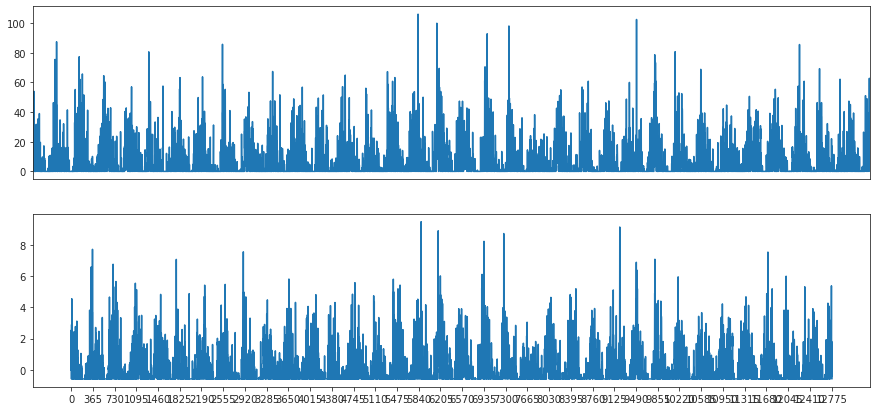

In [ ]:
saveIt=1
st=80
fig, ax = plt.subplots(2,1,figsize = (15,7))
fs=13
#fig.suptitle('Basin-averaged precipitation for station #{}'.format(stationIds[st]),y=1.02, fontsize=fs)

#plot_prov_ax('17', ax = ax)
ax[0].plot(p[:,st], label="precipitation (mm)")
ax[0].set_xticks([])
ax[0].set_xlim(0,12784 )

ax[1].plot(pnorm[:,st],label="normalized precipitation")

years = range(1980, 2015)

# set the x-axis labels to be the years
plt.xticks(range(0, 12784 , 365), years)
plt.xlim(0,12784 )

# set the y-axis labels for each subplot
ax[0].set_ylabel('Precipitation (mm/day)', fontsize=fs)
ax[1].set_ylabel('Normalized Precipitation',fontsize=fs)
ax[1].legend(fontsize=fs)
ax[0].legend(fontsize=fs)
plt.tight_layout()

if saveIt:
 plt.savefig(dir_output+'/comparisons/prcp_bainavg_data_normalization.png',dpi=300)

ValueError: ignored

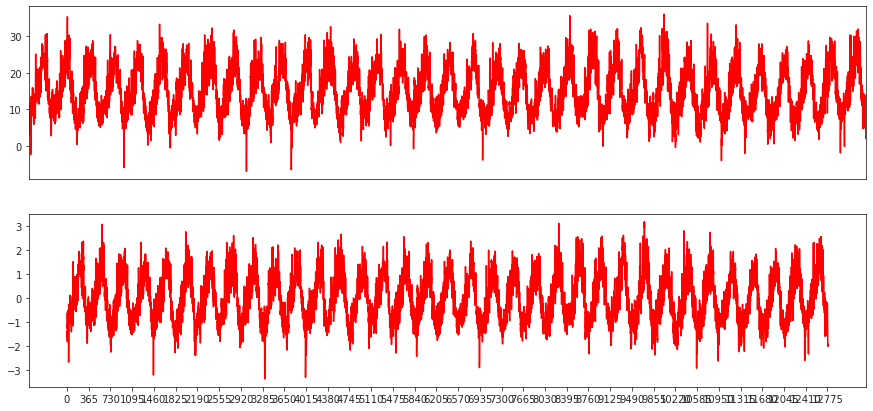

In [ ]:
saveIt=0
st=80
fig, ax = plt.subplots(2,1,figsize = (15,7))
fs=13
#fig.suptitle('Basin-averaged maximimum temparature for station #{}'.format(stationIds[st]),y=1.02, fontsize=20)

#plot_prov_ax('17', ax = ax)
ax[0].plot(tmax[:,st], label="Tmax (C)",c='r')
ax[0].set_xticks([])
ax[0].set_xlim(0,12784 )

ax[1].plot(tmaxnorm[:,st],label="normalized Tmax",c='r')

years = range(1980, 2015)

# set the x-axis labels to be the years
plt.xticks(range(0, 12784 , 365), years)
plt.xlim(0,12784 )

# set the y-axis labels for each subplot
ax[0].set_ylabel('Max temprature (c)', fontsize=fs)
ax[1].set_ylabel('Normalized max temprature ',fontsize=fs)
ax[1].legend(fontsize=fs)
ax[0].legend(fontsize=fs)

ax[0].axhline(y=0, color='black', linewidth=1, linestyle='-')
ax[1].axhline(y=0, color='black', linewidth=1, linestyle='-')
plt.tight_layout()

if saveIt:
 plt.savefig(dir_output+'/comparisons/tmax_bainavg_data_normalization.png',dpi=300)


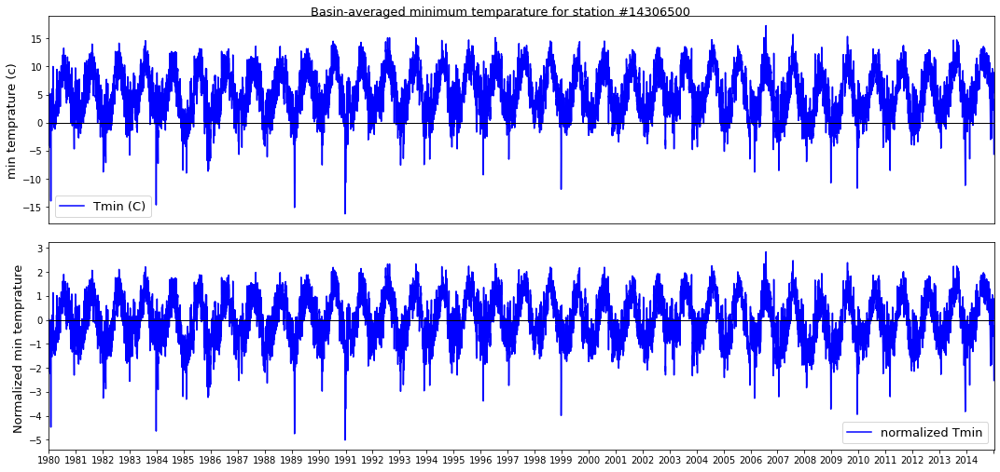

In [ ]:
saveIt=0
st=80
fig, ax = plt.subplots(2,1,figsize = (15,7))
fs=13
fig.suptitle('Basin-averaged minimum temparature for station #{}'.format(stationIds[st]),y=1, fontsize=fs)

#plot_prov_ax('17', ax = ax)
ax[0].plot(tmin[:,st], label="Tmin (C)",c='b')
ax[0].set_xticks([])
ax[0].set_xlim(0,12784 )

ax[1].plot(tminnorm[:,st],label="normalized Tmin",c='b')

years = range(1980, 2015)

# set the x-axis labels to be the years
plt.xticks(range(0, 12784 , 365), years)
plt.xlim(0,12784 )

# set the y-axis labels for each subplot
ax[0].set_ylabel('min temprature (c)', fontsize=fs)
ax[1].set_ylabel('Normalized min temprature ',fontsize=fs)
ax[1].legend(fontsize=fs)
ax[0].legend(fontsize=fs)

ax[0].axhline(y=0, color='black', linewidth=1, linestyle='-')
ax[1].axhline(y=0, color='black', linewidth=1, linestyle='-')
plt.tight_layout()
if saveIt:
 plt.savefig(dir_output+'/comparisons/tmin_bainavg_data_normalization.png',dpi=300)

In [ ]:
# constuct the target data
y_train = np.squeeze([Fnorm[365:trainInds[-1]+1,ii] for ii in range(np.shape(Fnorm)[1])]).T #drop first 365 days since those are used to predict first flow day
y_val = np.squeeze([Fnorm[valInds,ii] for ii in range(np.shape(Fnorm)[1])]).T
y_test = np.squeeze([Fnorm[testInds,ii] for ii in range(np.shape(Fnorm)[1])]).T


# construct predictor data

x_train = np.empty((Ntrain-365, 365, ) + (np.shape(tmaxnorm)[1]*3,)  ,dtype=np.float16)
x_val = np.empty((Nval, 365,) + (np.shape(tmaxnorm)[1]*3,) , dtype = np.float16)
x_test = np.empty((Ntest, 365,) + (np.shape(tmaxnorm)[1]*3,) ,dtype=np.float16)


#first, make (n_time x n_lon x n_lat x n_channels) tensor -- will be used to form weather videos
x_intermediate = np.empty((Ntrain+Nval+Ntest,) + (np.shape(tmaxnorm)[1]*3,),dtype='single')

for i in range(np.shape(x_intermediate)[0]):
  t1= tmaxnorm[i,:]
  t2= tminnorm[i,:]
  p= pnorm[i,:]
  x_intermediate[i,:]= np.hstack([t1,t2,p])

# #training
for ii in range(Ntrain-365):
  x_train[ii] = x_intermediate[ii:ii+365]

#validation
for ii in range(Nval):
  x_val[ii] = x_intermediate[ii + Ntrain-365 : ii + Ntrain ]

#testing
for ii in range(Ntest):
  x_test[ii] = x_intermediate[ii + Ntrain + Nval-365  : ii + Ntrain + Nval ]


In [ ]:
np.shape(x_train.reshape((7306,365,3,86))[:,:,:,[1,2,3]])

(7306, 365, 3, 3)

In [ ]:
np.shape(np.reshape(y_train,(7306*86,-1)))

(628316, 1)

In [ ]:

#convert predict/target arrays to tensors
x_test = tf.convert_to_tensor(x_test)
x_val = tf.convert_to_tensor(x_val)
x_train = tf.convert_to_tensor(x_train)
y_test = tf.convert_to_tensor(y_test)
y_val = tf.convert_to_tensor(y_val)
y_train = tf.convert_to_tensor(y_train)

In [ ]:
np.shape(x_test)

TensorShape([1461, 365, 258])

In [ ]:
#train bulk and fine-tuned for LSTM
#set of random seeds to use for reproducability
seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 5,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_LSTM_Model(learning_rate = learning_rate)
  model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks]
  )
  #predict train/val/test streamflow
  y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
  y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
  y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


  #save bulk model outputs
  file_train = 'LSTM_only/y_train_bulk_predict_' + str(ii) + '.csv' #ii is the model number
  file_val = 'LSTM_only/y_val_bulk_predict_' + str(ii) + '.csv'
  file_test = 'LSTM_only/y_test_bulk_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'LSTM_only/model_bulk_' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)


##### FINE-TUNING

  #prep fine-tune target output
  y_train_predict_fine_all = np.empty_like(y_train)
  y_val_predict_fine_all = np.empty_like(y_val)
  y_test_predict_fine_all = np.empty_like(y_test)

  #for each streamflow cluster, make/train/save fine-tuned model/output/heatmaps

  for cluster in range(n_clusters_seasonal):

    print('Training fine model, cluster ' + str(cluster+1) + ' / ' + str(n_clusters_seasonal))

    stations_fine = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster)) #stations in this cluster
    N_stations = len(stations_fine) #number of stations in this cluster

    #create target datasets (note: x is the same, y is different (same spatial input, different station targets))
    y_train_fine_current = tf.convert_to_tensor(y_train.numpy()[:,stations_fine])
    y_val_fine_current = tf.convert_to_tensor(y_val.numpy()[:,stations_fine])
    y_test_fine_current = tf.convert_to_tensor(y_test.numpy()[:,stations_fine])

    train_dataset_fine = tf.data.Dataset.from_tensor_slices((x_train,y_train_fine_current)).shuffle(Ntrain).batch(batch_size = batch_size)
    val_dataset_fine = tf.data.Dataset.from_tensor_slices((x_val,y_val_fine_current)).shuffle(Nval).batch(batch_size = batch_size)

    #build and train fine-tuned model
    model_fine = build_fine_model(model_bulk = model_bulk, N_stations = N_stations, learning_rate = learning_rate)
    model_fine.fit(
      train_dataset_fine,
      validation_data = val_dataset_fine,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )

    #predict train/val/test streamflow
    y_train_predict_fine = model_fine.predict(x_train, batch_size = batch_size, verbose = 0)
    y_val_predict_fine = model_fine.predict(x_val, batch_size = batch_size, verbose = 0)
    y_test_predict_fine = model_fine.predict(x_test, batch_size = batch_size, verbose = 0)

    #reorganize predictions into array that matches the bulk train/val/test structure
    for kk, station_fine in enumerate(stations_fine): #for each station/index in this cluster
      y_train_predict_fine_all[:,station_fine] = y_train_predict_fine[:,kk] #y_***_predict_fine_all has fine-tuned predictions for all stations, in same order as bulk
      y_val_predict_fine_all[:,station_fine] = y_val_predict_fine[:,kk]
      y_test_predict_fine_all[:,station_fine] = y_test_predict_fine[:,kk]

    #save model
    model_name = 'LSTM_only/model_fine_' + str(ii) + '_cluster_' + str(cluster) + '.h5'
    model_fine.save(dir_models + '/' + model_name)



  #save fine-tuned model predictions
  file_train = 'LSTM_only/y_train_fine_predict_' + str(ii) + '.csv'
  file_val = 'LSTM_only/y_val_fine_predict_' + str(ii) + '.csv'
  file_test = 'LSTM_only/y_test_fine_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_fine_all, delimiter = ',')

Training bulk model 1 / 1


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch 1/50
115/115 [==============================] - 12s 39ms/step - loss: 0.9162 - val_loss: 0.7535
Epoch 2/50
115/115 [==============================] - 4s 29ms/step - loss: 0.7522 - val_loss: 0.6489
Epoch 3/50
115/115 [==============================] - 4s 29ms/step - loss: 0.6325 - val_loss: 0.5449
Epoch 4/50
115/115 [==============================] - 4s 29ms/step - loss: 0.5289 - val_loss: 0.4846
Epoch 5/50
115/115 [==============================] - 4s 29ms/step - loss: 0.4719 - val_loss: 0.4647
Epoch 6/50
115/115 [==============================] - 4s 29ms/step - loss: 0.4369 - val_loss: 0.4450
Epoch 7/50
115/115 [==============================] - 4s 30ms/step - loss: 0.4128 - val_loss: 0.4382
Epoch 8/50
115/115 [==============================] - 4s 29ms/step - loss: 0.3945 - val_loss: 0.4266
Epoch 9/50
115/115 [==============================] - 4s 30ms/step - loss: 0.3806 - val_loss: 0.4174
Epoch 10/50
115/115 [==============================] - 4s 29ms/step - loss: 0.3676 - val_l

In [ ]:
#compare results from different model runs

#model runs to explore
runs = [0]
Nruns = len(runs)

#initialize
NSE_fine_runs = np.empty((Nruns, Nstations)) #fine-tuned NSE on test set
NSE_bulk_runs = np.empty((Nruns, Nstations)) #bulk NSE on test set
dNSE_runs = np.empty((Nruns, Nstations)) #difference in NSE from fine-tuning

A_fine_runs = np.empty((Nruns, Nstations)) #A from fine-tuned heatmaps on test set
A_bulk_runs = np.empty((Nruns, Nstations)) #A from bulk heatmaps on test set
dA_runs = np.empty((Nruns, Nstations)) #difference in A from fine-tuning

heat_mean_fine_runs = np.empty((Nruns, Npx, Nstations)) #fine-tuned heatmaps of each run
heat_mean_bulk_runs = np.empty((Nruns, Npx, Nstations)) #bulk heatmaps of each run

y_test_predict_bulk_runs = np.empty((Nruns, Ntest, Nstations)) #bulk model predictions of each run
y_test_predict_fine_runs = np.empty((Nruns, Ntest, Nstations)) #fine-tuned model predictions of each run

y_all_predict_fine_runs = np.empty((Nruns, Ntrain + Nval + Ntest-365 , Nstations))

#loop through each run, open model outputs/heatmaps, calculate NSE and A
for ii, run in enumerate(runs):

  print('Run ' + str(run))

  #load modelled streamflow
  filename_train_bulk = 'LSTM_only/y_train_bulk_predict_' + str(run) + '.csv'
  filename_val_bulk = 'LSTM_only/y_val_bulk_predict_' + str(run) + '.csv'
  filename_test_bulk = 'LSTM_only/y_test_bulk_predict_' + str(run) + '.csv'
  filename_train_fine = 'LSTM_only/y_train_fine_predict_' + str(run) + '.csv'
  filename_val_fine = 'LSTM_only/y_val_fine_predict_' + str(run) + '.csv'
  filename_test_fine = 'LSTM_only/y_test_fine_predict_' + str(run) + '.csv'
  y_train_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_train_bulk, header = None))
  y_val_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_val_bulk, header = None))
  y_test_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_test_bulk, header = None))
  y_train_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_train_fine, header = None))
  y_val_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_val_fine, header = None))
  y_test_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_test_fine, header = None))
  y_test_predict_bulk_runs[ii,:,:] = y_test_predict_bulk
  y_test_predict_fine_runs[ii,:,:] = y_test_predict_fine
  y_all_predict_fine_runs[ii,:,:] = np.vstack((y_train_predict_fine, y_val_predict_fine, y_test_predict_fine))


  #initialize NSE train/val/test bulk/fine and A bulk/fine arrays of this current run
  NSE_fine = np.empty((Nstations,))
  NSE_bulk = np.empty((Nstations,))
  NSE_train_fine = np.empty((Nstations,))
  NSE_train_bulk = np.empty((Nstations,))
  NSE_val_fine = np.empty((Nstations,))
  NSE_val_bulk = np.empty((Nstations,))
  NSE_test_fine = np.empty((Nstations,))
  NSE_test_bulk = np.empty((Nstations,))


  #loop through each station and calculate NSE and A
  for station in range(Nstations):

#####calculate NSE

    #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
    NSE_train_fine[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_fine[:,station]
        )
    NSE_val_fine[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_fine[:,station]
        )
    NSE_test_fine[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_fine[:,station]
        )
    NSE_train_bulk[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_bulk[:,station]
        )
    NSE_val_bulk[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_bulk[:,station]
        )
    NSE_test_bulk[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_bulk[:,station]
        )

#also calculate NSE of the model ensemble average streamflow, rather than model-by-model NSE

NSE_bulk = np.empty(Nstations)
NSE_fine = np.empty(Nstations)

for station in range(Nstations):

  NSE_bulk[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_bulk_runs,axis = 0)[:,station]
  )

  NSE_fine[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_fine_runs,axis = 0)[:,station]
  )

print('Median NSE test bulk ensemble = ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('Median NSE test fine ensemble = ' + str(np.round(np.median(NSE_fine), decimals = 2)))



Run 0
Median NSE test bulk ensemble = 0.58
Median NSE test fine ensemble = 0.57


In [ ]:
np.median(NSE_bulk)

0.5654516399085653

In [ ]:
# save NSES
# file_nse_test_bulk = 'LSTM_only/NSE_test_bulk.csv' #ii is the model number
# file_nse_test_fine = 'LSTM_only/NSE_test_fine.csv'

# file_nse_train_bulk = 'LSTM_only/NSE_train_bulk.csv' #ii is the model number
# file_nse_train_fine = 'LSTM_only/NSE_train_fine.csv'

# file_nse_val_bulk = 'LSTM_only/NSE_val_bulk.csv' #ii is the model number
# file_nse_val_fine = 'LSTM_only/NSE_val_fine.csv'

# np.savetxt(dir_output + '/' + file_nse_test_bulk, NSE_test_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_test_fine, NSE_test_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_train_bulk, NSE_train_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_train_fine, NSE_train_fine, delimiter = ',')

# np.savetxt(dir_output + '/' + file_nse_val_bulk, NSE_val_bulk, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_val_fine, NSE_val_fine, delimiter = ',')


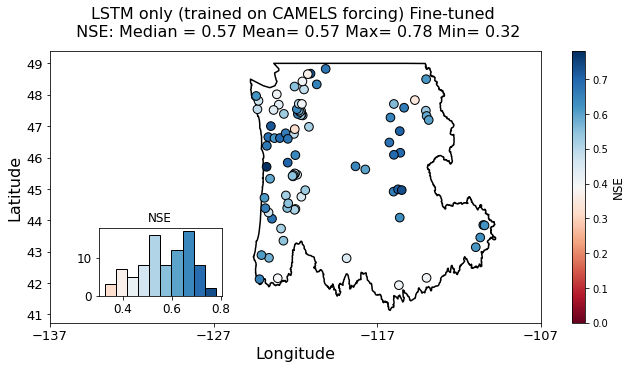

In [ ]:
plot_nses_spatially('LSTM_only','LSTM only (trained on CAMELS forcing) Fine-tuned', NSE_fine,1,'Fine')

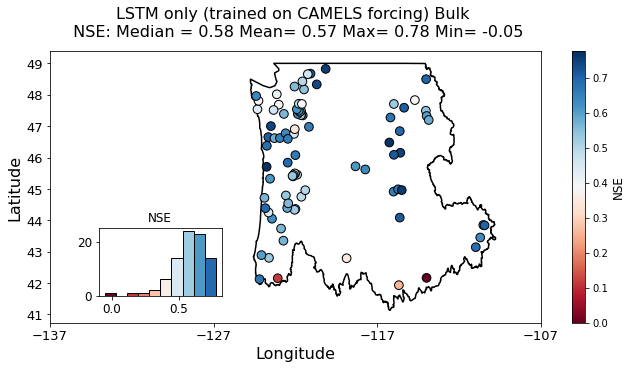

In [ ]:
plot_nses_spatially('LSTM_only','LSTM only (trained on CAMELS forcing) Bulk', NSE_bulk,1,'bulk')

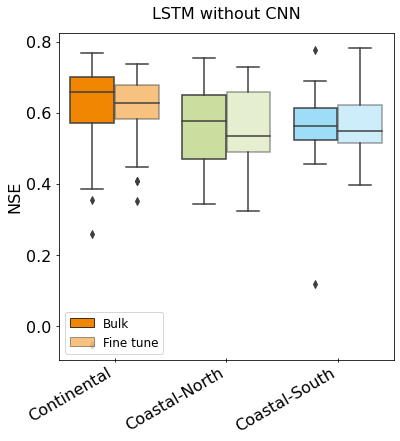

In [ ]:
plot_NSEs_box('LSTM_only','LSTM without CNN', NSE_bulk,NSE_fine,1)

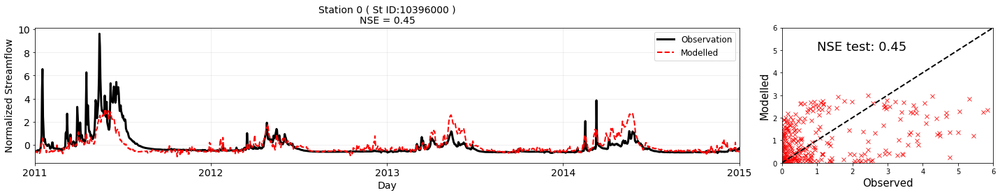

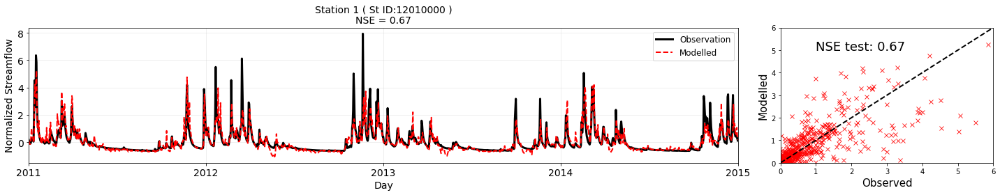

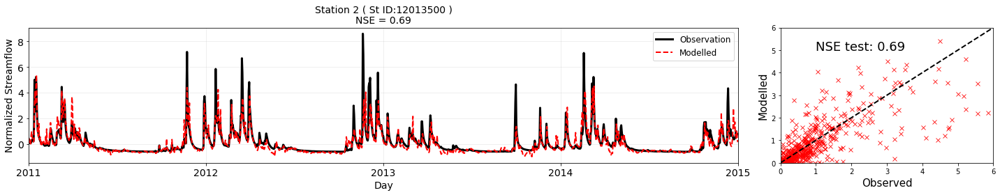

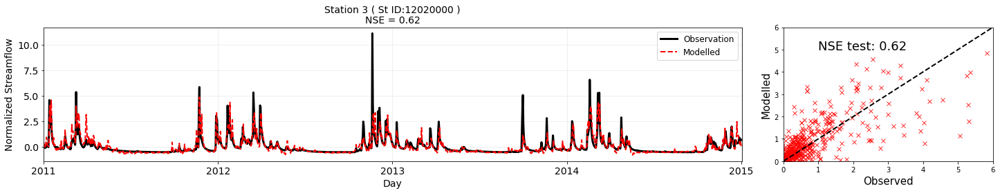

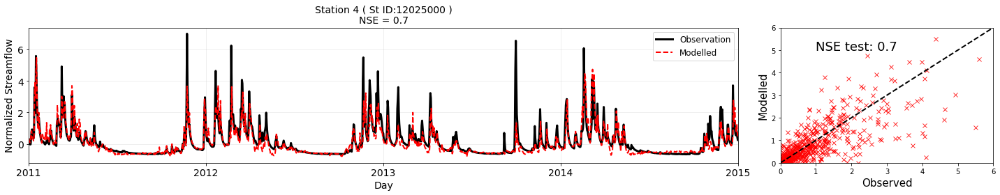

...

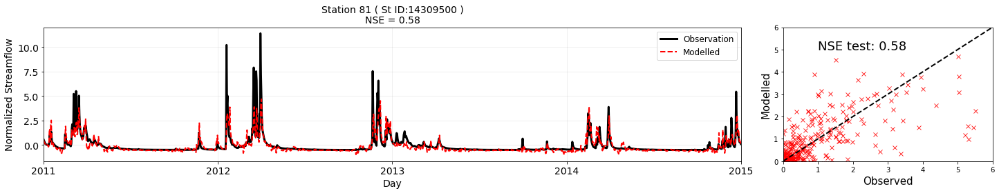

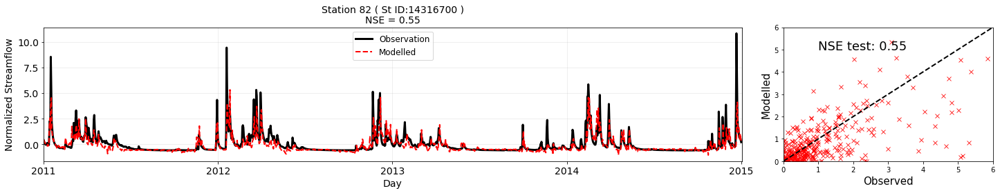

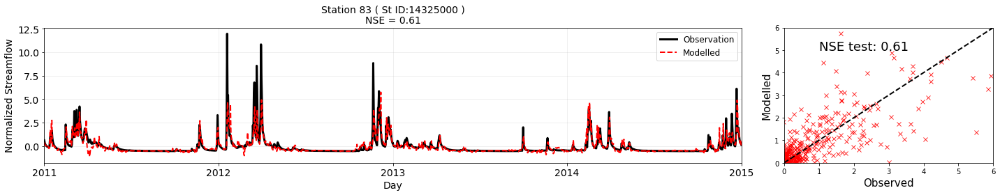

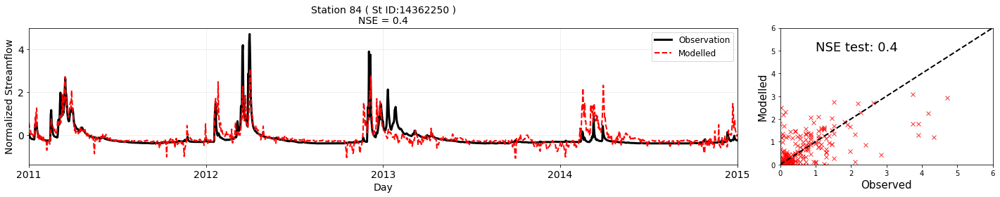

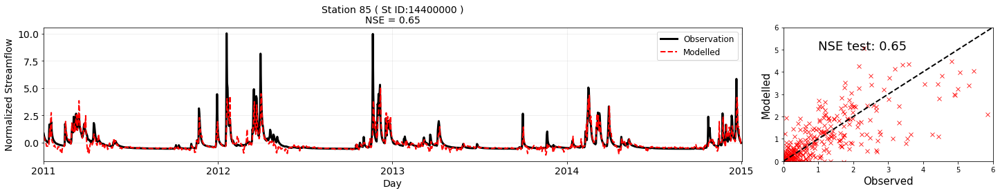

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'LSTM_only/y_test_fine_predict_0.csv',header=None))
for inds in  range(86):
  plot_st_streamFlow('LSTM_only',y_test,y_predict_fin,NSE_fine, inds,1)


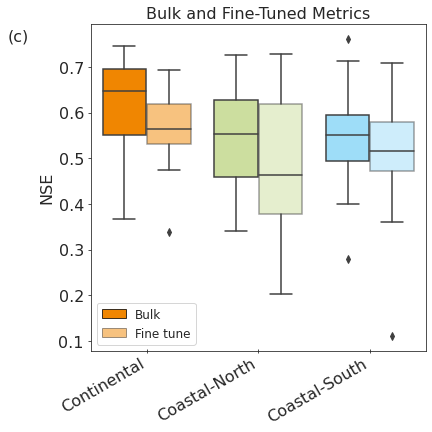

In [ ]:
plot_NSEs_box(NSE_bulk,NSE_fine,0)

# prediction in ungagued setup LSTM ( general mode)

In [ ]:
# loading the data p tmin and tmax
stationIds = list(map(lambda x: str(x), stationIds))
#load daily temperature data
pickle_in = open(dir_data + '/' + 'p_tmin_tmax_HU17.pickle','rb')
forcing_data = pickle.load(pickle_in)  # 0 for p 1 for tmin 2  for tmax
p    =    np.array(pd.DataFrame(forcing_data[0])[stationIds])
tmin = np.array(pd.DataFrame(forcing_data[1])[stationIds])
tmax= np.array(pd.DataFrame(forcing_data[2])[stationIds])


In [ ]:

print(np.shape(p))
print(np.shape(tmin))
print(np.shape(tmax))
print(np.shape(Fnorm))

(12784, 86)
(12784, 86)
(12784, 86)
(12784, 86)


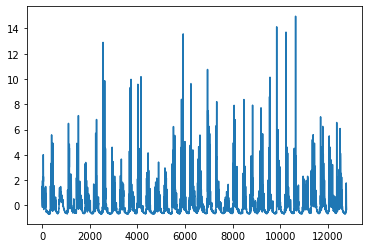

In [ ]:
plt.plot(Fnorm.T.reshape(-1)[4*35*365:5*35*365])

In [ ]:
# normalizing the data

tmaxmean = np.mean(tmax,axis=0) # normlize for the whole data set not only training
tmaxstd = np.std(tmax,axis=0)
tmaxnorm = (tmax - tmaxmean)/tmaxstd
tmaxnorm = np.single(tmaxnorm)


tminmean = np.mean(tmin,axis=0) # normlize for the whole data set not only training
tminstd = np.std(tmin,axis=0)
tminnorm = (tmin - tminmean)/tminstd
tminnorm = np.single(tminnorm)

pmean = np.mean(p,axis=0) # normlize for the whole data set not only training
pstd = np.std(p,axis=0)
pnorm = (p - pmean)/pstd
pnorm = np.single(pnorm)

# Tminmean_train = np.mean([Tmin[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Tminstd_train = np.std([Tmin[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Tminnorm = (Tmin - Tminmean_train)/Tminstd_train
# Tminnorm = np.single(Tminnorm)

# Pmean_train = np.mean([P[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Pstd_train = np.std([P[ii] for ii in range(len(trainInds)+len(testInds)+len(valInds))])
# Pnorm = (P - Pmean_train)/Pstd_train
# Pnorm = np.single(Pnorm)

In [ ]:
# split the 86 stations into gagued and ungagued stations

import random
num_gagued=76
num_ungagued=10
#1000 is best
random.seed(1000)
stations = list(range(86))
seen_stations = random.sample(stations, k=num_gagued)
unseen_stations = list(set(stations) - set(seen_stations))
print("Category 1 indices:", seen_stations)
print("Category 2 indices:", unseen_stations)


#clustering_lables= load_pickle('clustering_labels.pickle')

#selected_elements = tf.gather(tensor, row_indices, axis=0)

Category 1 indices: [54, 12, 50, 45, 8, 59, 21, 68, 55, 16, 28, 30, 46, 62, 25, 73, 29, 58, 23, 5, 72, 18, 80, 82, 65, 26, 44, 56, 84, 1, 48, 53, 34, 69, 61, 49, 13, 85, 11, 63, 51, 6, 76, 10, 64, 66, 0, 20, 78, 43, 41, 33, 7, 57, 35, 32, 42, 79, 77, 27, 47, 19, 15, 3, 9, 74, 14, 71, 67, 81, 17, 40, 39, 83, 2, 60]
Category 2 indices: [4, 36, 37, 38, 70, 75, 52, 22, 24, 31]


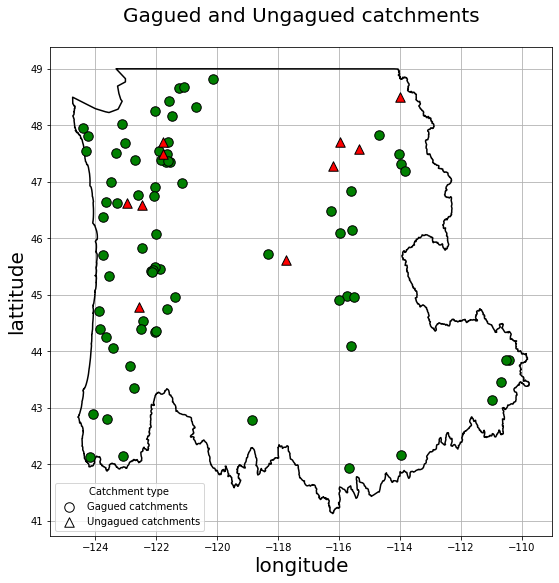

In [ ]:
fig, ax = plt.subplots(figsize = (9,9))

plot_prov_ax('17', ax = ax)
ax.grid()

gagued_catchments = ax.scatter([], [], edgecolor = 'k', facecolor = 'w', s = 90, linewidth = 1, zorder = 3, label = "Gagued catchments")
ungagued_catchments = ax.scatter([], [], edgecolor = 'k', facecolor = 'w', s = 90, linewidth = 1, zorder = 3, marker="^", label = "Ungagued catchments")

for station in seen_stations:
    ax.scatter(flowDict['stationLon'].iloc[station], flowDict['stationLat'].iloc[station], c="g",edgecolor = 'k', facecolor = 'w', s = 90, linewidth = 1, zorder = 3)

for station in unseen_stations:
    ax.scatter(flowDict['stationLon'].iloc[station], flowDict['stationLat'].iloc[station], edgecolor = 'k', c="r" ,facecolor = 'w', s = 90, linewidth = 1, zorder = 3, marker="^")

ax.set_xlabel('longitude',size=20)
ax.set_ylabel('lattitude',size=20)
ax.set_title ('Gagued and Ungagued catchments', size=20, pad= 25 )

legend = ax.legend(handles=[gagued_catchments, ungagued_catchments])
legend.set_title('Catchment type')
plt.savefig(dir_output+'/comparisons/Stations_86.png',dpi=300)
plt.show()

In [ ]:
# constuct the target data  on the shape (365,3,86) one year video for all of the stations

y_train = np.squeeze([Fnorm[365:trainInds[-1]+1,ii] for ii in range(np.shape(Fnorm)[1])]).T #drop first 365 days since those are used to predict first flow day
y_val = np.squeeze([Fnorm[valInds,ii] for ii in range(np.shape(Fnorm)[1])]).T
y_test = np.squeeze([Fnorm[testInds,ii] for ii in range(np.shape(Fnorm)[1])]).T


# construct predictor data

x_train = np.empty((Ntrain-365, 365, ) + (3,np.shape(tmaxnorm)[1],)  ,dtype=np.float16)
x_val = np.empty((Nval, 365,) + (3,np.shape(tmaxnorm)[1],) , dtype = np.float16)
x_test = np.empty((Ntest, 365,) + (3,np.shape(tmaxnorm)[1],) ,dtype=np.float16)


# #first, make (n_time x n_lon x n_lat x n_channels) tensor -- will be used to form weather videos
x_intermediate = np.empty((Ntrain+Nval+Ntest,) + (3,np.shape(tmaxnorm)[1],),dtype='single')

for i in range(np.shape(x_intermediate)[0]):
  t1= tmaxnorm[i,:]
  t2= tminnorm[i,:]
  p= pnorm[i,:]
  x_intermediate[i,0,:]= t1
  x_intermediate[i,1,:]= t2
  x_intermediate[i,2,:]= p

# #training
for ii in range(Ntrain-365):
  x_train[ii] = x_intermediate[ii:ii+365]

#validation
for ii in range(Nval):
  x_val[ii] = x_intermediate[ii + Ntrain-365 : ii + Ntrain ]

#testing
for ii in range(Ntest):
  x_test[ii] = x_intermediate[ii + Ntrain + Nval-365  : ii + Ntrain + Nval ]

In [ ]:
Ntest

1461

In [ ]:
np.shape(y_train)

(7306, 86)

In [ ]:
# subset the seen stations will be used for traiing and validation
x_train_seen = x_train[:,:,:,seen_stations]
x_val_seen = x_val[:,:,:,seen_stations]
x_test_seen = x_test[:,:,:,seen_stations]
y_train_seen = y_train[:,seen_stations]
y_val_seen = y_val[:,seen_stations]
y_test_seen = y_test[:,seen_stations]

# subset the unseen stations will be used for testing

x_test_unseen= x_test[:,:,:,unseen_stations]
y_test_unseen = y_test[:,unseen_stations]

In [ ]:
np.shape(x_train)

(7306, 365, 3, 86)

In [ ]:
# reshape the data into general example format (training using all the data regard less of the station all, train general model
x_train_seen_re = x_train_seen.transpose(3, 0, 1, 2).reshape(7306*num_gagued, 365, 3)
x_val_seen_re =  x_val_seen.transpose(3, 0, 1, 2).reshape(3652*num_gagued, 365, 3)
x_test_seen_re =  x_test_seen.transpose(3, 0, 1, 2).reshape(1461*num_gagued, 365, 3)
y_train_seen_re = y_train_seen.T.reshape((-1))
y_val_seen_re =  y_val_seen.T.reshape((-1))
y_test_seen_re = y_test_seen.T.reshape((-1))

# subset the unseen stations will be used for testing

x_test_unseen_re= x_test_unseen.transpose(3, 0, 1, 2).reshape(1461*num_ungagued, 365, 3)
y_test_unseen_re = y_test_unseen.T.reshape((-1))

In [ ]:
#convert predict/target arrays to tensors for the seen stations
x_test_seen_tens = tf.convert_to_tensor(x_test_seen_re)
x_val_seen_tens = tf.convert_to_tensor(x_val_seen_re)
x_train_seen_tens = tf.convert_to_tensor(x_train_seen_re)
y_test_seen_tens = tf.convert_to_tensor(y_test_seen_re)
y_val_seen_tens = tf.convert_to_tensor(y_val_seen_re)
y_train_seen_tens = tf.convert_to_tensor(y_train_seen_re)

# unseen
y_test_unseen_tens = tf.convert_to_tensor(y_test_unseen_re)
x_test_unseen_tens = tf.convert_to_tensor(x_test_unseen_re)

In [ ]:
def build_LSTM_general(learning_rate):

  """
  Returns the
   LSTM modle  to predict for one station to be trained for all the station s
  learning_rate: learning rate for training the bulk model

  Architecture of this model:


    LSTM layer: 80 units

    Dense layer: N_stations neurons

  """


  model = Sequential()


  #LSTM
  model.add(
      LSTM(
          80, input_shape=(365,3),
           return_sequences=False
           )
      )


  model.add(
    Dropout(
        rate =0.3
        )
    )

  #Dense
  model.add(
      Dense(
          1,
          activation = 'linear'
          )
      )

  #compile
  model.compile(loss=tf.keras.losses.mse,
                  optimizer=tf.keras.optimizers.Adam(lr=learning_rate))

  return model


In [ ]:
m = build_LSTM_general(1e-4)
m.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 80)                26880     
                                                                 
 dropout_1 (Dropout)         (None, 80)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 81        
                                                                 
Total params: 26,961
Trainable params: 26,961
Non-trainable params: 0
_________________________________________________________________


In [ ]:
seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### model for seen data

  print('Training model for the gagued stations ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 5,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 256
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train_seen_tens, y_train_seen_tens)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val_seen_tens, y_val_seen_tens)).shuffle(Nval).batch(batch_size)
  #test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test_seen)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_LSTM_general(learning_rate = learning_rate)
  history= model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1.,
  callbacks = [callbacks ]
  )

  # #predict train/val/test streamflow

  y_test_unseen_predict_bulk = model_bulk.predict(x_test_unseen_tens, batch_size = batch_size, verbose = 0)
  y_test_seen_predict_bulk = model_bulk.predict(x_test_seen_tens, batch_size = batch_size, verbose = 0)

  #save bulk model outputs
  file_seen = 'LSTM_general_ungagued/y_test_seen_predict_' + str(ii) + '.csv' #ii is the model number

  file_unseen = 'LSTM_general_ungagued/y_test_unseen_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_unseen, y_test_unseen_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_seen, y_test_seen_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'model_general_LSTM_ungagued' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)

  #generate/save bulk heat maps

Training model for the gagued stations 1 / 1


Epoch 1/50
2169/2169 [==============================] - 39s 17ms/step - loss: 0.5459 - val_loss: 0.6179
Epoch 2/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.5079 - val_loss: 0.6345
Epoch 3/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.4616 - val_loss: 0.5988
Epoch 4/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.4718 - val_loss: 0.6047
Epoch 5/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.4130 - val_loss: 0.5656
Epoch 6/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.3733 - val_loss: 0.5601
Epoch 7/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.3611 - val_loss: 0.5102
Epoch 8/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.3423 - val_loss: 0.5202
Epoch 9/50
2169/2169 [==============================] - 36s 17ms/step - loss: 0.3305 - val_loss: 0.5171
Epoch 10/50
2169/2169 [==============================] - 36s 17m

In [ ]:
# evaluating the nse


un_st=10

NSE_unseen = np.empty((un_st,))
NSE_seen = np.empty((86-un_st,))
filename_unseen = 'LSTM_general_ungagued/y_test_unseen_predict_0' + '.csv'
filename_seen = 'LSTM_general_ungagued/y_test_seen_predict_0' + '.csv'


y_test_unseen_predict = np.asarray(pd.read_csv(dir_output + '/' + filename_unseen, header = None))
y_test_seen_predict = np.asarray(pd.read_csv(dir_output + '/' + filename_seen, header = None))




In [ ]:


y_test_unseen_predict= y_test_unseen_predict.reshape(1461, 10, order='F')
y_test_seen_predict= y_test_seen_predict.reshape(1461, 76, order='F')


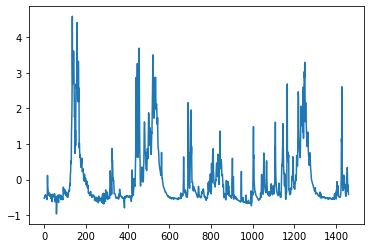

In [ ]:
plt.plot(y_test_unseen_predict[:,1])
#np.shape(y_test_unseen_tens)

In [ ]:

for st in range(un_st):
  NSE_unseen[st] = nse(
      y_obs   = y_test_unseen[:,st],
      y_model = y_test_unseen_predict[:,st]

      )

for st in range(Nstations- un_st):
  NSE_seen[st] = nse(
      y_obs   = y_test_seen[:,st],
      y_model = y_test_seen_predict[:,st]

      )


print("NSE for unseen data: {}".format(np.median(NSE_unseen)))
print("NSE for seen data: {}".format(np.median(NSE_seen)))



NSE for unseen data: 0.49930280297261875
NSE for seen data: 0.4294212264295245


In [ ]:
print(NSE_seen)
print(NSE_unseen)

[ 0.66878823  0.30723457  0.30904977  0.71767609  0.40343765 -2.33494829
  0.44035655  0.40305665  0.69420661  0.30574419 -0.32188784 -0.02295997
 -0.41582847  0.45199518  0.09260557  0.0978963  -0.1139807   0.17119785
  0.37823987  0.60947644  0.49301694  0.37113635  0.53413716  0.47724427
  0.5753046   0.26941785  0.52163059  0.55826087 -0.29653628  0.81570823
  0.7112286   0.58777626  0.21899841  0.16734846  0.27305884  0.28287716
 -0.09614542  0.71866403  0.29122783  0.45637671 -0.06525227  0.89789869
  0.70773949  0.47635772  0.48663204  0.5901268   0.49211369  0.28785367
  0.57013326  0.24844875  0.17444841  0.49688412  0.51413992 -0.07461159
  0.63467808  0.24404409  0.67283959  0.425678    0.58826251 -0.48635921
  0.15519523  0.43316446 -0.00801526  0.70941381  0.65228937  0.63393046
  0.32937293  0.51149508  0.24767098  0.6076792   0.31635948  0.24847313
  0.63476779  0.61609868  0.76451887  0.4158993 ]
[0.70570164 0.50866469 0.1784629  0.38479204 0.52682547 0.58353346
 0.4213

In [ ]:
file_seen = 'LSTM_general_ungagued/NSE_test_seen.csv'
file_unseen = 'LSTM_general_ungagued/NSE_test_unseen.csv'

np.savetxt(dir_output + '/' + file_seen, NSE_seen, delimiter = ',')
np.savetxt(dir_output + '/' + file_unseen, NSE_unseen, delimiter = ',')

In [ ]:
# reading the benchmark data for comparison

filename_indv = 'LSTM_indv/NSE_test' + '.csv'


NSE_bench = np.asarray(pd.read_csv(dir_output + '/' + filename_indv, header = None))



In [ ]:
NSE_bench_unseen= NSE_bench[unseen_stations]

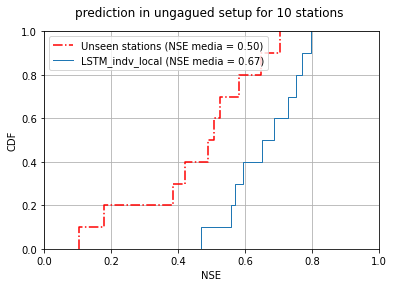

In [ ]:
saveIt=0
sns.ecdfplot(NSE_unseen, label='Unseen stations (NSE media = {:.2f})'.format(np.median(NSE_unseen)),color='r',ls='-.',linewidth=1.5)
sns.ecdfplot(NSE_bench_unseen, label='LSTM_indv_local (NSE media = {:.2f})'.format(np.median(NSE_bench_unseen)),color='green',ls='-',linewidth=1)
plt.xticks(fontsize=10)
plt.title("prediction in ungagued setup for 10 stations ", pad=15)
plt.xlim(0,1)
plt.xlabel('NSE')
plt.ylabel('CDF')
plt.legend()
plt.grid()
if saveIt:
    plt.savefig(dir_output+'/LSTM_general_ungagued/seen_unseen.png',dpi=300)

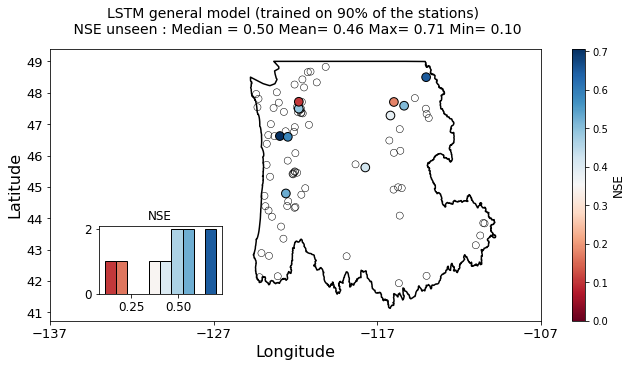

In [ ]:


model_name = "LSTM_general_ungagued"
title = "LSTM general model (trained on 90% of the stations)"
saveIt=0
fs = 16
ex=''
nses= NSE_unseen
fig, ax_maps = plt.subplots(nrows = 1, ncols = 1, figsize = (11,5))

########## NSE in space

##### map of NSE

# ax_map = fig.add_subplot(1,1,1)

vmin = 0
vmax = np.max(nses)

for station in seen_stations:
  ax_maps.scatter(flowDict['stationLon'].iloc[station], flowDict['stationLat'].iloc[station], c="none", edgecolor='k', facecolor='none', s=50, linewidth=0.5, zorder=1)

s = ax_maps.scatter(list(stationLon.iloc[unseen_stations]), list(stationLat.iloc[unseen_stations]), c = nses, s = 75, edgecolor = 'k', cmap = 'RdBu', vmin = vmin, vmax = vmax)


plot_prov_ax('17',  ax_maps)
cb = plt.colorbar(s, ax = ax_maps)#, orientation = 'horizontal')
cb.set_label('NSE', fontsize = 12)
#ax_maps.set_ylim((48,57))
ax_maps.tick_params(labelsize = 13)
ax_maps.set_xlabel('Longitude', fontsize = fs)
ax_maps.set_ylabel('Latitude', fontsize = fs)
ax_maps.set_title(str(title) +' \n NSE unseen : Median = {:.2f} Mean= {:.2f} Max= {:.2f} Min= {:.2f}'.format(np.median(nses),np.mean(nses),np.max(nses),np.min(nses)) , fontsize = 14,pad=15)

ax_maps.set_xticks(np.arange(-137.0,-100.0,10.0))

##### histogram of NSE

ax_hist_NSE = plt.axes([0,0,1,1], label = 'NSE_hist')
ip = InsetPosition(ax_maps, [0.1,0.1,0.25,0.25])
ax_hist_NSE.set_axes_locator(ip)

mapname = 'RdBu'
cmap = cm.get_cmap(mapname)
norm = matplotlib.colors.Normalize(vmin = vmin, vmax = vmax)
scalarMap = cm.ScalarMappable(norm = norm, cmap = cmap)

n, bins, patches = ax_hist_NSE.hist(nses, edgecolor = 'k')
colours = scalarMap.to_rgba(bins)
kk = 0
for patch in patches:
  patch.set_facecolor(colours[kk])
  kk+=1



ax_hist_NSE.set_title('NSE', fontsize = fs-4)
#ax_hist_NSE.set_ylabel('Frequency', fontsize = fs-4)
ax_hist_NSE.set_frame_on = False
ax_hist_NSE.tick_params(labelsize = fs-4)
if saveIt:
    plt.savefig(dir_output+'/'+str(model_name)+'/NSE_spatial{}.png'.format(ex), bbox_inches = 'tight', dpi = 300)

# LSTM trined for individual stations with tmin tmax p (from camels)

In [ ]:
#st=80
for st in range(Nstations):
      # constuct the target data
      y_train = np.squeeze(Fnorm[365:trainInds[-1]+1,st] ).T #drop first 365 days since those are used to predict first flow day
      y_val = np.squeeze(Fnorm[valInds,st] ).T
      y_test = np.squeeze(Fnorm[testInds,st] ).T


      # construct predictor data

      x_train = np.empty((Ntrain-365, 365, ) + (3,)  ,dtype=np.float16)
      x_val = np.empty((Nval, 365,) + (3,) , dtype = np.float16)
      x_test = np.empty((Ntest, 365,) + (3,) ,dtype=np.float16)


      #first, make (n_time x n_lon x n_lat x n_channels) tensor -- will be used to form weather videos
      x_intermediate = np.empty((Ntrain+Nval+Ntest,) + (3,),dtype='single')

      for i in range(np.shape(x_intermediate)[0]):
        t1= tmaxnorm[i,st]
        t2= tminnorm[i,st]
        p= pnorm[i,st]
        x_intermediate[i,:]= np.hstack([t1,t2,p])

      # #training
      for ii in range(Ntrain-365):
        x_train[ii] = x_intermediate[ii:ii+365]

      #validation
      for ii in range(Nval):
        x_val[ii] = x_intermediate[ii + Ntrain-365 : ii + Ntrain ]

      #testing
      for ii in range(Ntest):
        x_test[ii] = x_intermediate[ii + Ntrain + Nval-365  : ii + Ntrain + Nval ]

      #convert predict/target arrays to tensors
      x_test = tf.convert_to_tensor(x_test)
      x_val = tf.convert_to_tensor(x_val)
      x_train = tf.convert_to_tensor(x_train)
      y_test = tf.convert_to_tensor(y_test)
      y_val = tf.convert_to_tensor(y_val)
      y_train = tf.convert_to_tensor(y_train)



      seeds = 00

      #parameters for training
      learning_rate = 1e-4

      # training a model for the station st

      print('Training  model for station ' + str(st) + ' / ' + str(Nstations))

      #set random seeds
      seed(seeds)
      np.random.seed(seeds)
      tf.random.set_seed(seeds)

      #define early stopping callback to use in all models
      callbacks = EarlyStopping(monitor='val_loss',
                              mode='min',
                              verbose=1,
                              patience = 5,
                              restore_best_weights = True)

      #create train/val/test datasets for bulk model
      batch_size = 64
      train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
      val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
      test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



      #generate/train bulk model
      model_bulk = build_LSTM_Model_INDV(learning_rate = learning_rate)
      model_bulk.fit(
      train_dataset_bulk,
      validation_data = val_dataset_bulk,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )
      #predict train/val/test streamflow
      y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
      y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
      y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


      #save bulk model outputs
      file_train = 'LSTM_indv/y_train_bulk_predict_' + str(st) + '.csv' #ii is the model number
      file_val = 'LSTM_indv/y_val_bulk_predict_' + str(st) + '.csv'
      file_test = 'LSTM_indv/y_test_bulk_predict_' + str(st) + '.csv'

      np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
      np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
      np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

      #save bulk model
      model_name = 'LSTM_indv/model_st_' + str(st) + '.h5'
      model_bulk.save(dir_models + '/' + model_name)



Training  model for station 0 / 86
Epoch 1/50


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Streaming output truncated to the last 5000 lines.
Epoch 12/50
115/115 [==============================] - 2s 17ms/step - loss: 0.3149 - val_loss: 0.5083
Epoch 13/50
115/115 [==============================] - 2s 17ms/step - loss: 0.3110 - val_loss: 0.5120
Epoch 14/50
115/115 [==============================] - 2s 16ms/step - loss: 0.3088 - val_loss: 0.4930
Epoch 15/50
115/115 [==============================] - 2s 17ms/step - loss: 0.3067 - val_loss: 0.4914
Epoch 16/50
115/115 [==============================] - 2s 17ms/step - loss: 0.3032 - val_loss: 0.4915
Epoch 17/50
115/115 [==============================] - 2s 17ms/step - loss: 0.3001 - val_loss: 0.4917
Epoch 18/50
115/115 [==============================] - 2s 17ms/step - loss: 0.2993 - val_loss: 0.4852
Epoch 19/50
115/115 [==============================] - 2s 17ms/step - loss: 0.2956 - val_loss: 0.4849
Epoch 20/50
115/115 [==============================] - 2s 16ms/step - loss: 0.2930 - val_loss: 0.4924
Epoch 21/50
115/115 [==========

In [ ]:
#compare results from different model runs





#initialize


NSE_train = np.empty((Nstations,))

NSE_val = np.empty((Nstations,))

NSE_test = np.empty((Nstations,))




for st in range(Nstations):
  #load modelled streamflow
  filename_train = 'LSTM_indv/y_train_bulk_predict_' + str(st) + '.csv'
  filename_val= 'LSTM_indv/y_val_bulk_predict_' + str(st) + '.csv'
  filename_test = 'LSTM_indv/y_test_bulk_predict_' + str(st) + '.csv'


  y_train = np.squeeze(Fnorm[365:trainInds[-1]+1,st] ).T #drop first 365 days since those are used to predict first flow day
  y_val = np.squeeze(Fnorm[valInds,st] ).T
  y_test = np.squeeze(Fnorm[testInds,st] ).T

  np.savetxt(dir_output + '/' + 'LSTM_indv/y_test_'+str(st)+'.csv',y_test, delimiter = ',')

  y_train_predict = np.asarray(pd.read_csv(dir_output + '/' + filename_train, header = None))
  y_val_predict = np.asarray(pd.read_csv(dir_output + '/' + filename_val, header = None))
  y_test_predict = np.asarray(pd.read_csv(dir_output + '/' + filename_test, header = None))



  #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
  NSE_train[st] = nse(
      y_obs   = y_train,
      y_model = y_train_predict
      )
  NSE_val[st] = nse(
      y_obs   = y_val,
      y_model = y_val_predict
      )
  NSE_test[st] = nse(
      y_obs   = y_test,
      y_model = y_test_predict

      )

#save NSEs
# file_train = 'LSTM_indv/NSE_train.csv' #ii is the model number
# file_val = 'LSTM_indv/NSE_val.csv'
# file_test = 'LSTM_indv/NSE_test.csv'

# np.savetxt(dir_output + '/' + file_train, NSE_train, delimiter = ',')
# np.savetxt(dir_output + '/' + file_val, NSE_val, delimiter = ',')
# np.savetxt(dir_output + '/' + file_test, NSE_test, delimiter = ',')




In [ ]:
print('Median NSE test  = ' + str(np.round(np.median(NSE_test), decimals = 2)))
print('Median NSE train = ' + str(np.round(np.median(NSE_train), decimals = 2)))

Median NSE test  = 0.63
Median NSE train = 0.72


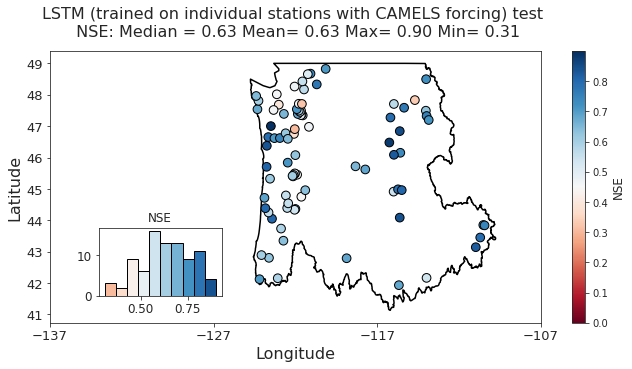

In [ ]:
plot_nses_spatially('LSTM_indv','LSTM (trained on individual stations with CAMELS forcing) test', NSE_test,1,'test')

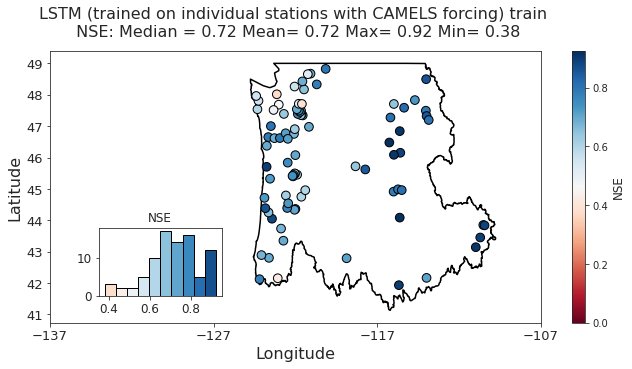

In [ ]:
plot_nses_spatially('LSTM_indv','LSTM (trained on individual stations with CAMELS forcing) train', NSE_train,1,'train')

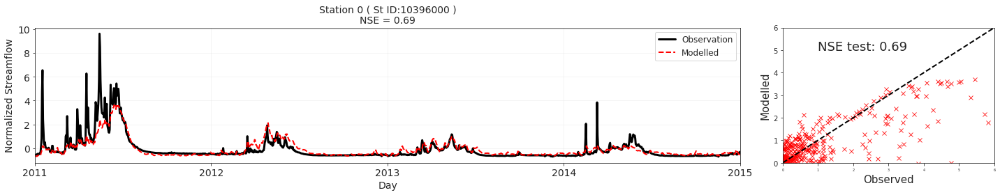

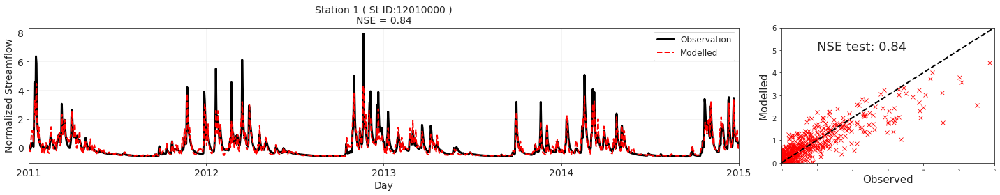

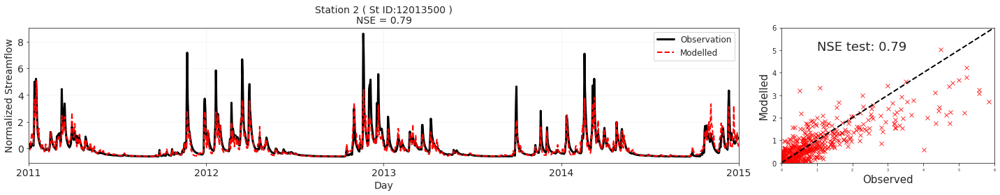

In [ ]:

for inds in range(3):#Nstations):

        y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'LSTM_indv/y_test_bulk_predict_{}.csv'.format(inds),header=None))
        y_test = np.loadtxt(dir_output+'/LSTM_indv/y_test_{}.csv'.format(inds))
        plot_st_streamFlow_lstm_indv('LSTM_indv',y_test,y_predict_fin,NSE_test, inds,0)


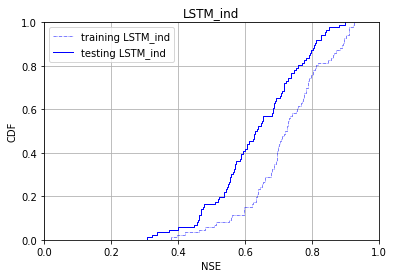

In [ ]:
plot_CDF_train_test(NSE_test,NSE_train,'LSTM_ind',0)

In [ ]:
nse(y_train, y_train_predict)

0.8659890049995835

In [ ]:
nse(y_test,y_train_predict)

0.8032893987796351

# Using only dense layer (to check the none linearity), simple naive model

In [ ]:
m =build_ANN_Model(10e-4)
m.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_2 (Flatten)         (None, 240900)            0         
                                                                 
 dropout_3 (Dropout)         (None, 240900)            0         
                                                                 
 dense_6 (Dense)             (None, 86)                20717486  
                                                                 
Total params: 20,717,486
Trainable params: 20,717,486
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#train bulk and fine-tuned for ANN
#set of random seeds to use for reproducability
seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 5,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_ANN_Model(learning_rate = learning_rate)
  model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks]
  )
  #predict train/val/test streamflow
  y_train_predict_bulk = model_bulk.predict(x_train, batch_size = batch_size, verbose = 0)
  y_val_predict_bulk = model_bulk.predict(x_val, batch_size = batch_size, verbose = 0)
  y_test_predict_bulk = model_bulk.predict(x_test, batch_size = batch_size, verbose = 0)


  #save bulk model outputs
  file_train = 'ANN/y_train_bulk_predict_' + str(ii) + '.csv' #ii is the model number
  file_val = 'ANN/y_val_bulk_predict_' + str(ii) + '.csv'
  file_test = 'ANN/y_test_bulk_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_bulk, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_bulk, delimiter = ',')

  #save bulk model
  model_name = 'ANN/model_bulk_' + str(ii) + '.h5'
  model_bulk.save(dir_models + '/' + model_name)


##### FINE-TUNING

  #prep fine-tune target output
  y_train_predict_fine_all = np.empty_like(y_train)
  y_val_predict_fine_all = np.empty_like(y_val)
  y_test_predict_fine_all = np.empty_like(y_test)

  #for each streamflow cluster, make/train/save fine-tuned model/output/heatmaps

  for cluster in range(n_clusters_seasonal):

    print('Training fine model, cluster ' + str(cluster+1) + ' / ' + str(n_clusters_seasonal))

    stations_fine = np.squeeze(np.argwhere(seasonal_clustering.labels_ == cluster)) #stations in this cluster
    N_stations = len(stations_fine) #number of stations in this cluster

    #create target datasets (note: x is the same, y is different (same spatial input, different station targets))
    y_train_fine_current = tf.convert_to_tensor(y_train.numpy()[:,stations_fine])
    y_val_fine_current = tf.convert_to_tensor(y_val.numpy()[:,stations_fine])
    y_test_fine_current = tf.convert_to_tensor(y_test.numpy()[:,stations_fine])

    train_dataset_fine = tf.data.Dataset.from_tensor_slices((x_train,y_train_fine_current)).shuffle(Ntrain).batch(batch_size = batch_size)
    val_dataset_fine = tf.data.Dataset.from_tensor_slices((x_val,y_val_fine_current)).shuffle(Nval).batch(batch_size = batch_size)

    #build and train fine-tuned model
    model_fine = build_fine_model(model_bulk = model_bulk, N_stations = N_stations, learning_rate = learning_rate)
    model_fine.fit(
      train_dataset_fine,
      validation_data = val_dataset_fine,
      epochs = 50,
      verbose = 1,
      callbacks = [callbacks]
      )

    #predict train/val/test streamflow
    y_train_predict_fine = model_fine.predict(x_train, batch_size = batch_size, verbose = 0)
    y_val_predict_fine = model_fine.predict(x_val, batch_size = batch_size, verbose = 0)
    y_test_predict_fine = model_fine.predict(x_test, batch_size = batch_size, verbose = 0)

    #reorganize predictions into array that matches the bulk train/val/test structure
    for kk, station_fine in enumerate(stations_fine): #for each station/index in this cluster
      y_train_predict_fine_all[:,station_fine] = y_train_predict_fine[:,kk] #y_***_predict_fine_all has fine-tuned predictions for all stations, in same order as bulk
      y_val_predict_fine_all[:,station_fine] = y_val_predict_fine[:,kk]
      y_test_predict_fine_all[:,station_fine] = y_test_predict_fine[:,kk]

    #save model
    model_name = 'ANN/model_fine_' + str(ii) + '_cluster_' + str(cluster) + '.h5'
    model_fine.save(dir_models + '/' + model_name)



  #save fine-tuned model predictions
  file_train = 'ANN/y_train_fine_predict_' + str(ii) + '.csv'
  file_val = 'ANN/y_val_fine_predict_' + str(ii) + '.csv'
  file_test = 'ANN/y_test_fine_predict_' + str(ii) + '.csv'

  np.savetxt(dir_output + '/' + file_train, y_train_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_val, y_val_predict_fine_all, delimiter = ',')
  np.savetxt(dir_output + '/' + file_test, y_test_predict_fine_all, delimiter = ',')

Training bulk model 1 / 1
Epoch 1/50
120/120 [==============================] - 7s 48ms/step - loss: 3.4004 - val_loss: 1.2275
Epoch 2/50
120/120 [==============================] - 5s 36ms/step - loss: 1.1725 - val_loss: 1.2125
Epoch 3/50
120/120 [==============================] - 5s 37ms/step - loss: 0.9873 - val_loss: 1.2252
Epoch 4/50
120/120 [==============================] - 5s 36ms/step - loss: 0.9260 - val_loss: 1.2240
Epoch 5/50
120/120 [==============================] - 5s 35ms/step - loss: 0.9445 - val_loss: 1.3516
Epoch 6/50
120/120 [==============================] - 5s 36ms/step - loss: 1.0179 - val_loss: 1.2365
Epoch 7/50
120/120 [==============================] - 5s 36ms/step - loss: 0.8876 - val_loss: 1.2951
Epoch 7: early stopping
Training fine model, cluster 1 / 3
Epoch 1/50
120/120 [==============================] - 6s 38ms/step - loss: 3.2731 - val_loss: 1.0759
Epoch 2/50
120/120 [==============================] - 5s 37ms/step - loss: 1.0571 - val_loss: 1.0719
Epoch 

In [ ]:
#compare results from different model runs

#model runs to explore
runs = [0]
Nruns = len(runs)

#initialize
NSE_fine_runs = np.empty((Nruns, Nstations)) #fine-tuned NSE on test set
NSE_bulk_runs = np.empty((Nruns, Nstations)) #bulk NSE on test set
dNSE_runs = np.empty((Nruns, Nstations)) #difference in NSE from fine-tuning

A_fine_runs = np.empty((Nruns, Nstations)) #A from fine-tuned heatmaps on test set
A_bulk_runs = np.empty((Nruns, Nstations)) #A from bulk heatmaps on test set
dA_runs = np.empty((Nruns, Nstations)) #difference in A from fine-tuning

heat_mean_fine_runs = np.empty((Nruns, Npx, Nstations)) #fine-tuned heatmaps of each run
heat_mean_bulk_runs = np.empty((Nruns, Npx, Nstations)) #bulk heatmaps of each run

y_test_predict_bulk_runs = np.empty((Nruns, Ntest, Nstations)) #bulk model predictions of each run
y_test_predict_fine_runs = np.empty((Nruns, Ntest, Nstations)) #fine-tuned model predictions of each run

y_all_predict_fine_runs = np.empty((Nruns, Ntrain + Nval + Ntest , Nstations))

#loop through each run, open model outputs/heatmaps, calculate NSE and A
for ii, run in enumerate(runs):

  print('Run ' + str(run))

  #load modelled streamflow
  filename_train_bulk = 'ANN/y_train_bulk_predict_' + str(run) + '.csv'
  filename_val_bulk = 'ANN/y_val_bulk_predict_' + str(run) + '.csv'
  filename_test_bulk = 'ANN/y_test_bulk_predict_' + str(run) + '.csv'
  filename_train_fine = 'ANN/y_train_fine_predict_' + str(run) + '.csv'
  filename_val_fine = 'ANN/y_val_fine_predict_' + str(run) + '.csv'
  filename_test_fine = 'ANN/y_test_fine_predict_' + str(run) + '.csv'
  y_train_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_train_bulk, header = None))
  y_val_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_val_bulk, header = None))
  y_test_predict_bulk = np.asarray(pd.read_csv(dir_output + '/' + filename_test_bulk, header = None))
  y_train_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_train_fine, header = None))
  y_val_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_val_fine, header = None))
  y_test_predict_fine = np.asarray(pd.read_csv(dir_output + '/' + filename_test_fine, header = None))
  y_test_predict_bulk_runs[ii,:,:] = y_test_predict_bulk
  y_test_predict_fine_runs[ii,:,:] = y_test_predict_fine
  y_all_predict_fine_runs[ii,:,:] = np.vstack((y_train_predict_fine, y_val_predict_fine, y_test_predict_fine))


  #initialize NSE train/val/test bulk/fine and A bulk/fine arrays of this current run
  NSE_fine = np.empty((Nstations,))
  NSE_bulk = np.empty((Nstations,))
  NSE_train_fine = np.empty((Nstations,))
  NSE_train_bulk = np.empty((Nstations,))
  NSE_val_fine = np.empty((Nstations,))
  NSE_val_bulk = np.empty((Nstations,))
  NSE_test_fine = np.empty((Nstations,))
  NSE_test_bulk = np.empty((Nstations,))


  #loop through each station and calculate NSE and A
  for station in range(Nstations):

#####calculate NSE

    #calculate train/val/test on fine/bulk models -- we'll use test NSE for evaluation but calculate all for interest sake
    NSE_train_fine[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_fine[:,station]
        )
    NSE_val_fine[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_fine[:,station]
        )
    NSE_test_fine[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_fine[:,station]
        )
    NSE_train_bulk[station] = nse(
        y_obs   = y_train[:,station],
        y_model = y_train_predict_bulk[:,station]
        )
    NSE_val_bulk[station] = nse(
        y_obs   = y_val[:,station],
        y_model = y_val_predict_bulk[:,station]
        )
    NSE_test_bulk[station] = nse(
        y_obs   = y_test[:,station],
        y_model = y_test_predict_bulk[:,station]
        )

#also calculate NSE of the model ensemble average streamflow, rather than model-by-model NSE

NSE_bulk = np.empty(Nstations)
NSE_fine = np.empty(Nstations)

for station in range(Nstations):

  NSE_bulk[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_bulk_runs,axis = 0)[:,station]
  )

  NSE_fine[station] = nse(
      y_obs = y_test[:,station],
      y_model = np.mean(y_test_predict_fine_runs,axis = 0)[:,station]
  )

print('Median NSE test bulk ensemble = ' + str(np.round(np.median(NSE_bulk), decimals = 2)))
print('Median NSE test fine ensemble = ' + str(np.round(np.median(NSE_fine), decimals = 2)))



Run 0
Median NSE test bulk ensemble = -0.2
Median NSE test fine ensemble = -0.11


0.5073109324934817

In [ ]:
#saving NSEs
file_nse_test_bulk = 'ANN/NSE_test_bulk.csv' #ii is the model number
file_nse_test_fine = 'ANN/NSE_test_fine.csv'

file_nse_train_bulk = 'ANN/NSE_train_bulk.csv' #ii is the model number
file_nse_train_fine = 'ANN/NSE_train_fine.csv'

file_nse_val_bulk = 'ANN/NSE_val_bulk.csv' #ii is the model number
file_nse_val_fine = 'ANN/NSE_val_fine.csv'


np.savetxt(dir_output + '/' + file_nse_test_bulk, NSE_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_test_fine, NSE_fine, delimiter = ',')

np.savetxt(dir_output + '/' + file_nse_train_bulk, NSE_train_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_train_fine, NSE_train_fine, delimiter = ',')

np.savetxt(dir_output + '/' + file_nse_val_bulk, NSE_val_bulk, delimiter = ',')
np.savetxt(dir_output + '/' + file_nse_val_fine, NSE_val_fine, delimiter = ',')


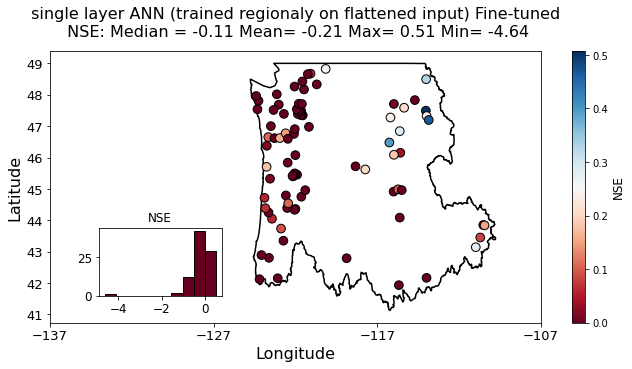

In [ ]:
plot_nses_spatially('ANN',' single layer ANN (trained regionaly on flattened input) Fine-tuned', NSE_fine,1,'Fine')

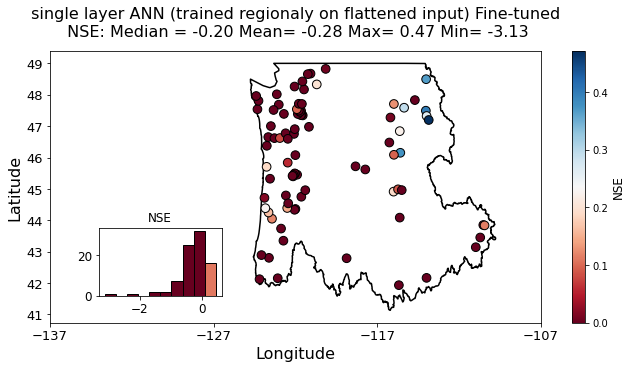

In [ ]:
plot_nses_spatially('ANN',' single layer ANN (trained regionaly on flattened input) Fine-tuned', NSE_bulk,1,'Bulk')

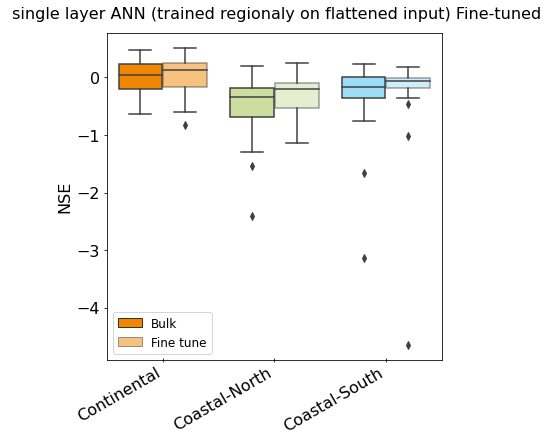

In [ ]:
plot_NSEs_box('ANN',' single layer ANN (trained regionaly on flattened input) Fine-tuned', NSE_bulk,NSE_fine,1)

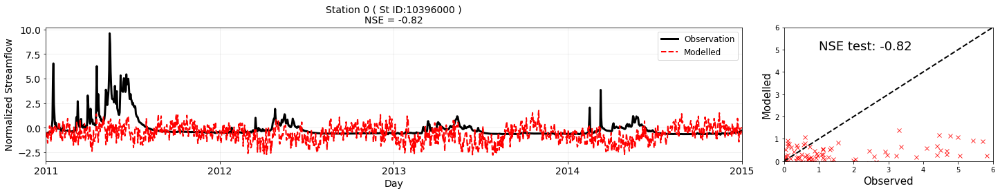

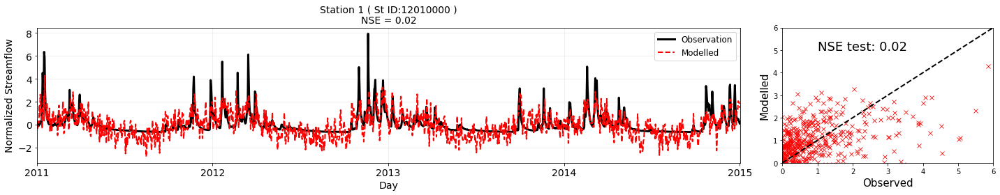

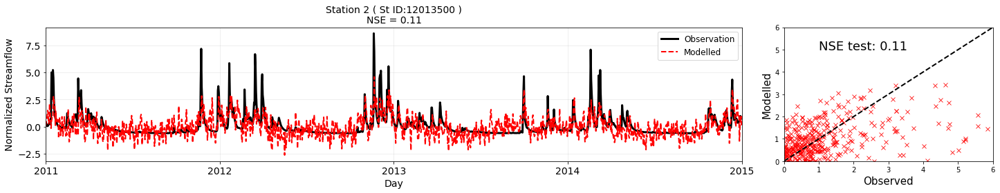

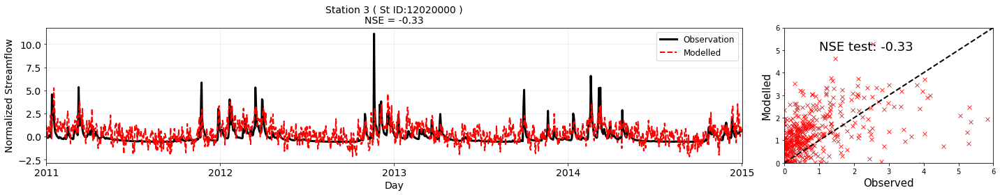

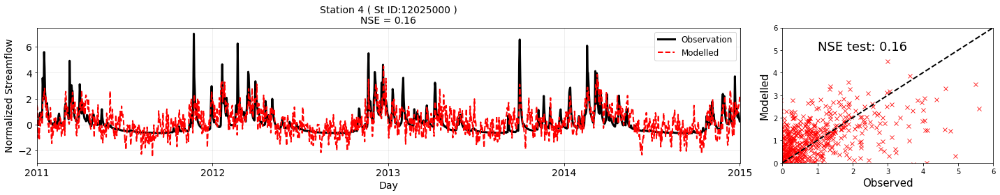

...

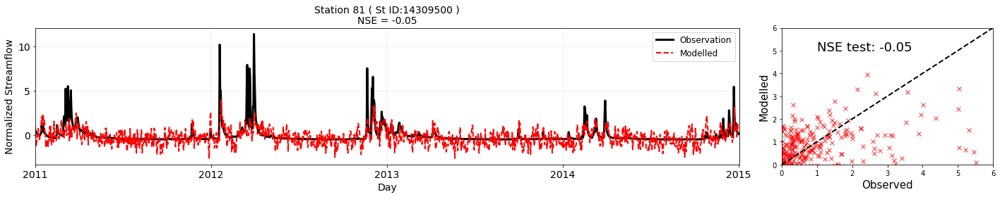

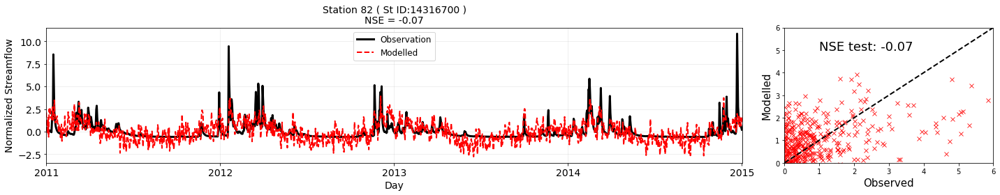

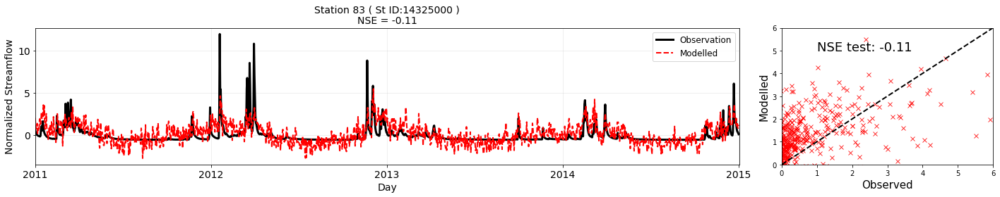

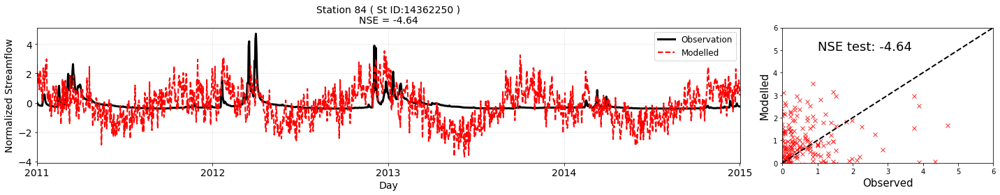

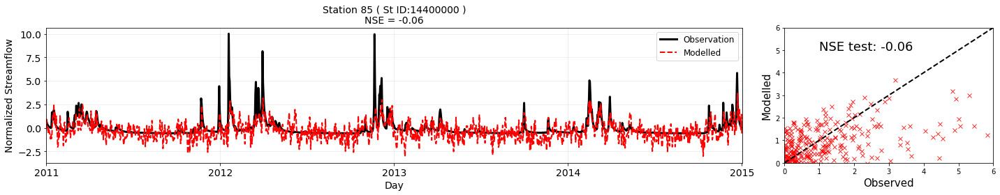

In [ ]:
y_predict_fin=np.array(pd.read_csv(dir_output+'/'+'ANN/y_test_fine_predict_0.csv',header=None))
for inds in range(86):
  plot_st_streamFlow('ANN',y_test,y_predict_fin,NSE_fine, inds,1)

# Benchmark model

In [ ]:
# reading the data
NSE_bech_file= 'basin_nse_daymet.txt'
SMA_NSE= pd.read_csv(dir_data+'/'+NSE_bech_file,sep=r'\t')
SMA_NSE.set_index('Basin_ID', inplace=True)


# extracting the 86 stations

SMA_NSE_test = np.array(SMA_NSE['Val'].loc[stationIDs])
SMA_NSE_train = np.array(SMA_NSE['Cal'].loc[stationIDs])

# file_nse_test = 'SAC-SMA+Snow17/NSE_test.csv' #ii is the model number
# file_nse_train = 'SAC-SMA+Snow17/NSE_train.csv' #ii is the model number

# np.savetxt(dir_output + '/' + file_nse_test, SMA_NSE_test, delimiter = ',')
# np.savetxt(dir_output + '/' + file_nse_train, SMA_NSE_train, delimiter = ',')

/usr/local/lib/python3.8/dist-packages/pandas/util/_decorators.py:311: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  return func(*args, **kwargs)


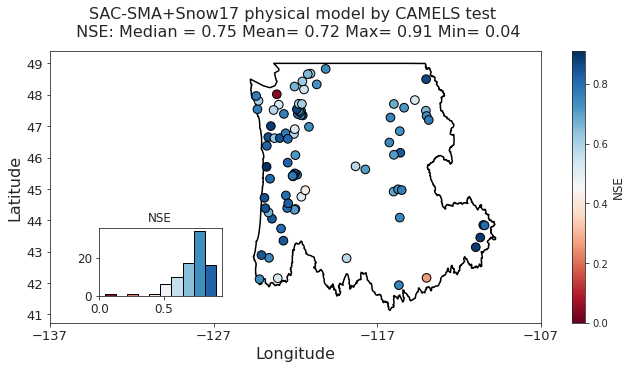

In [ ]:
plot_nses_spatially('SAC-SMA+Snow17','SAC-SMA+Snow17 physical model by CAMELS test', SMA_NSE_test,1,'test')

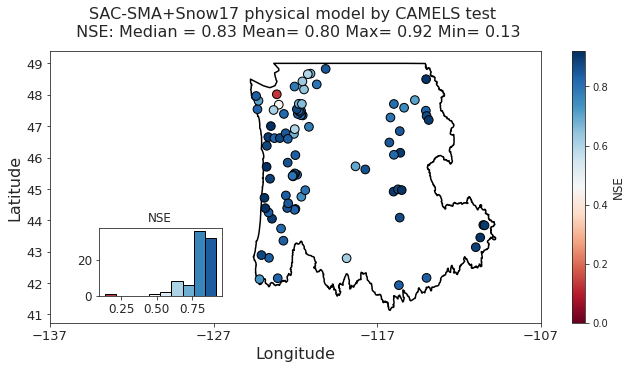

In [ ]:
plot_nses_spatially('SAC-SMA+Snow17','SAC-SMA+Snow17 physical model by CAMELS test', SMA_NSE_train,1,'train')

# Prediction in ungagued setup

In [ ]:
np.shape(y_test)

TensorShape([1461, 86])

TensorShape([1461, 43])

# Plotting all the resutls (CDF of NSE for training and testing)

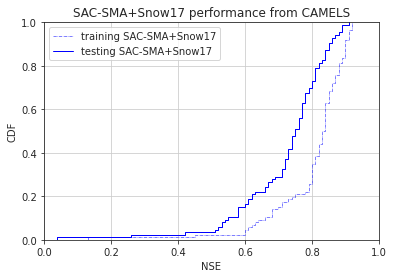

In [ ]:
plot_CDF_train_test('SAC-SMA+Snow17','SAC-SMA+Snow17 performance from CAMELS',0)

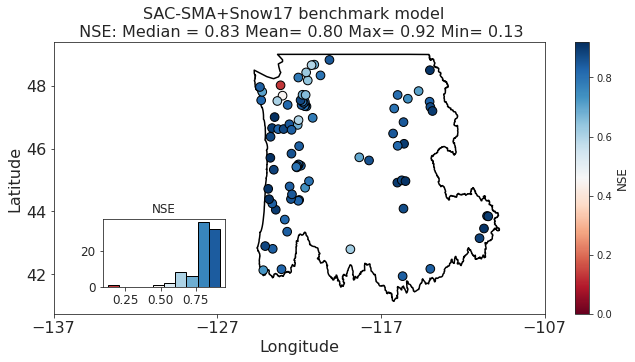

In [ ]:
plot_nses_spatially(SMA_NSE_train,'SAC-SMA+Snow17 benchmark model ')

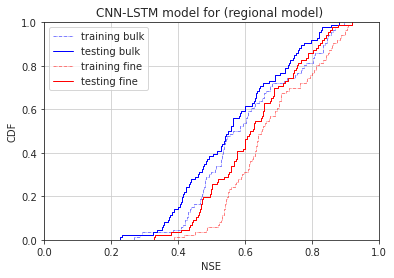

In [ ]:
plot_CDF('CNN_LSTM','CNN-LSTM model for (regional model) ',savefig=1)

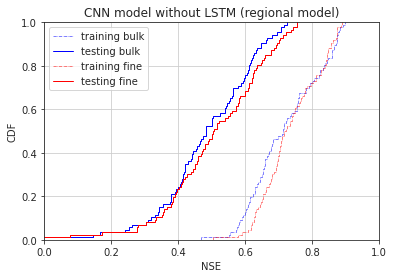

In [ ]:
plot_CDF('CNN_only','CNN model without LSTM (regional model)',savefig=1)

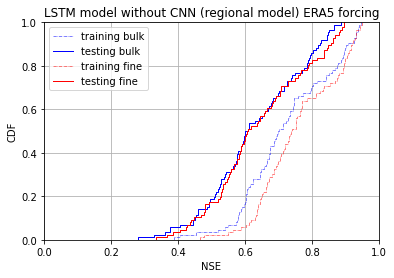

In [ ]:
plot_CDF('LSTM_only_era','LSTM model without CNN (regional model) ERA5 forcing',savefig=0)

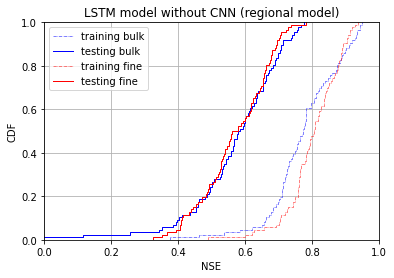

In [ ]:
plot_CDF('LSTM_only','LSTM model without CNN (regional model)',savefig=1)

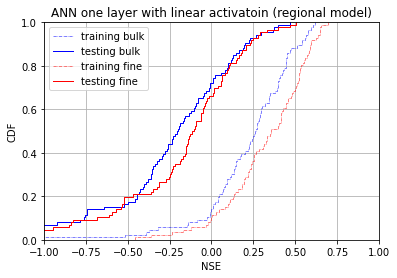

In [ ]:
plot_CDF('ANN','ANN one layer with linear activatoin (regional model)',savefig=1,start=-1)

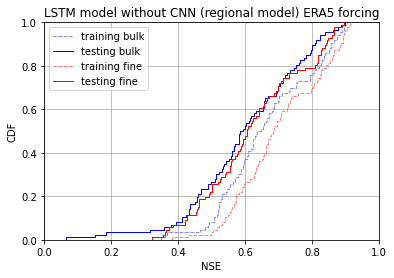

In [ ]:
plot_CDF('LSTM_only_era','LSTM model without CNN (regional model) ERA5 forcing',savefig=1,start=0)

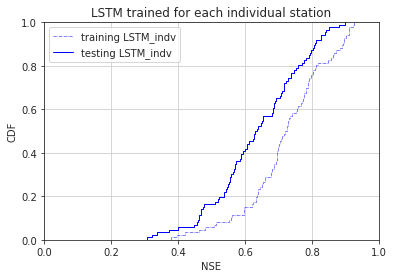

In [ ]:
model_name= 'LSTM_indv'
title='LSTM trained for each individual station'

plot_CDF_train_test(model_name,title,savefig=1)

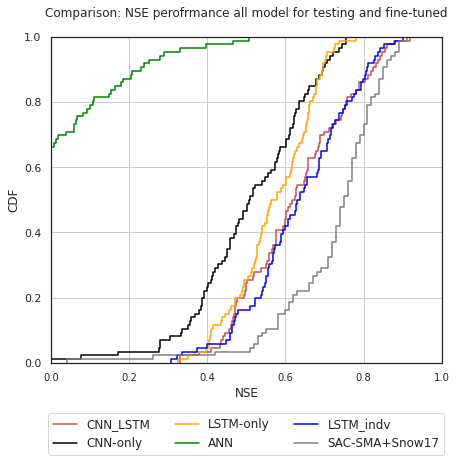

In [ ]:
#def plot_CDF(model_name,title,savefig=0,start=0):
title = 'Comparison: NSE perofrmance all model for testing and fine-tuned'
start=-0.5
saveIt=1
fig ,ax=plt.subplots(figsize=(7, 6))
model_names= ['CNN_LSTM','CNN_only','LSTM_only','ANN','LSTM_indv', 'SAC-SMA+Snow17']
model_labels= ['CNN_LSTM','CNN-only','LSTM-only','ANN','LSTM_indv', 'SAC-SMA+Snow17']
colors =['r','black','orange','green','blue','gray']
ex= '_fine'

ls='-'
lw=2
sns.set(style="white")
for i,m in enumerate(model_names):
  if m== 'LSTM_indv' or m=='SAC-SMA+Snow17':
      ex=''
      ls='-.'
      lw=1
  file_nse=  str(m)+'/NSE_test{}.csv'.format(ex)
  nses_test= np.loadtxt(dir_output + '/' +  file_nse)

  if m=='LSTM_only':
   nses_test=nses_test

  if m=='LSTM_only_era':
       continue
  if m=='CNN_LSTM':
    nses_test=nses_test
  #get the nse files fine tuned and for the test period for all the models




  # Plot the CDF using the ecdfplot function from seaborn
  #sns.ecdfplot(nses_test, label='{}'.format(model_labels[i]),color=colors[i],ls=ls,linewidth=lw)
  a = sns.ecdfplot(nses_test,legend=True,color=colors[i])
plt.xticks(fontsize=10)
plt.title(title,pad=20)
plt.xlim(start,1)
plt.xlim(0,1)
plt.xlabel('NSE')
plt.ylabel('CDF')
plt.legend()
plt.grid()

plt.legend(model_labels, loc='lower center', ncol=3, bbox_to_anchor=(0.5, -0.3),fontsize=12)

if saveIt:
  plt.savefig(dir_output + '/comparisons/NSES_CDF_all_progress.png', dpi=300)

plt.show()

# summary of the Architectuer of all the model built

In [ ]:
m= build_bulk_model_CNN_LSTM(10e-4)
m.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_8 (TimeDis  (None, 365, 11, 20, 32)  128       
 tributed)                                                       
                                                                 
 time_distributed_9 (TimeDis  (None, 365, 11, 20, 16)  4624      
 tributed)                                                       
                                                                 
 time_distributed_10 (TimeDi  (None, 365, 11, 20, 32)  4640      
 stributed)                                                      
                                                                 
 time_distributed_11 (TimeDi  (None, 365, 11, 20, 3)   867       
 stributed)                                                      
                                                                 
 reshape_2 (Reshape)         (None, 365, 660)         

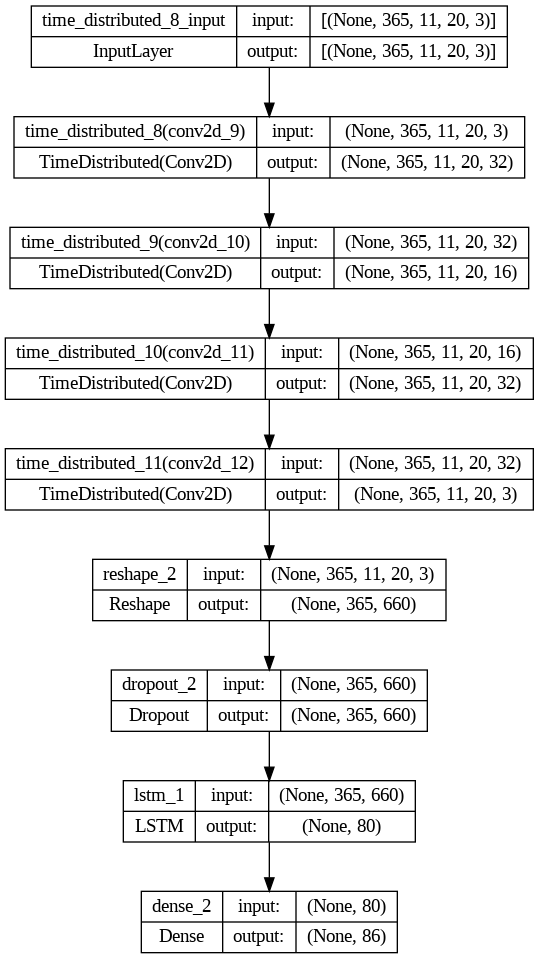

In [ ]:
from keras.utils import plot_model
plot_model(m, show_shapes=True)

In [ ]:
m= build_bulk_model_CNN(10e-4)
m.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_12 (TimeDi  (None, 365, 11, 20, 32)  128       
 stributed)                                                      
                                                                 
 time_distributed_13 (TimeDi  (None, 365, 11, 20, 16)  4624      
 stributed)                                                      
                                                                 
 time_distributed_14 (TimeDi  (None, 365, 11, 20, 32)  4640      
 stributed)                                                      
                                                                 
 time_distributed_15 (TimeDi  (None, 365, 11, 20, 3)   867       
 stributed)                                                      
                                                                 
 reshape_3 (Reshape)         (None, 365, 660)         

In [ ]:
m= build_LSTM_Model_era(10e-4)
#m.build((None, 365,258))
m.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 reshape (Reshape)           (None, 365, 660)          0         
                                                                 
 dropout_1 (Dropout)         (None, 365, 660)          0         
                                                                 
 lstm_1 (LSTM)               (None, 80)                237120    
                                                                 
 dense_1 (Dense)             (None, 86)                6966      
                                                                 
Total params: 244,086
Trainable params: 244,086
Non-trainable params: 0
_________________________________________________________________


In [ ]:
m= build_ANN_Model(10e-4)
m.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_4 (Flatten)         (None, 94170)             0         
                                                                 
 dropout_3 (Dropout)         (None, 94170)             0         
                                                                 
 dense_4 (Dense)             (None, 86)                8098706   
                                                                 
Total params: 8,098,706
Trainable params: 8,098,706
Non-trainable params: 0
_________________________________________________________________


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
m= build_LSTM_Model_INDV(10e-4)
m.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 80)                26880     
                                                                 
 dense_5 (Dense)             (None, 1)                 81        
                                                                 
Total params: 26,961
Trainable params: 26,961
Non-trainable params: 0
_________________________________________________________________


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


# visualize the learning for CNN LSTM

In [ ]:
# build a model with the new architectuer
import numpy as np
from keras.callbacks import Callback



# Create the PredictionSaver callback





seeds = [00]

#parameters for training
learning_rate = 1e-4

#for each random seed (one seed = one bulk / set of fine-tuned models; 10 seeds --> 10 model ensemble)
for ii, s in enumerate(seeds):
  ##### BULK

  print('Training bulk model ' + str(ii+1) + ' / ' + str(len(seeds)))

  #set random seeds
  seed(s)
  np.random.seed(s)
  tf.random.set_seed(s)

  #define early stopping callback to use in all models
  callbacks = EarlyStopping(monitor='val_loss',
                          mode='min',
                          verbose=1,
                          patience = 3,
                          restore_best_weights = True)

  #create train/val/test datasets for bulk model
  batch_size = 64
  train_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(Ntrain).batch(batch_size)
  val_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_val, y_val)).shuffle(Nval).batch(batch_size)
  test_dataset_bulk = tf.data.Dataset.from_tensor_slices((x_test, y_test)).shuffle(Ntest).batch(batch_size)



  #generate/train bulk model
  model_bulk = build_bulk_model_CNN_LSTM(learning_rate = learning_rate)
  history= model_bulk.fit(
  train_dataset_bulk,
  validation_data = val_dataset_bulk,
  epochs = 50,
  verbose = 1,
  callbacks = [callbacks ]
  )



  #save the history in pickle

  with open(dir_output+'/CNN_LSTM/training_progress/prediction_{}.pickle', 'wb') as f:
         pickle.dump(history, f)


Training bulk model 1 / 1
Epoch 1/50
120/120 [==============================] - 224s 2s/step - loss: 0.8796 - val_loss: 0.6821
Epoch 2/50
120/120 [==============================] - 218s 2s/step - loss: 0.6259 - val_loss: 0.5427
Epoch 3/50
120/120 [==============================] - 217s 2s/step - loss: 0.5329 - val_loss: 0.4960
Epoch 4/50
120/120 [==============================] - 216s 2s/step - loss: 0.4902 - val_loss: 0.4811
Epoch 5/50
120/120 [==============================] - 216s 2s/step - loss: 0.4655 - val_loss: 0.4662
Epoch 6/50
120/120 [==============================] - 217s 2s/step - loss: 0.4479 - val_loss: 0.4420
Epoch 7/50
120/120 [==============================] - 216s 2s/step - loss: 0.4304 - val_loss: 0.4430
Epoch 8/50
120/120 [==============================] - 216s 2s/step - loss: 0.4181 - val_loss: 0.4352
Epoch 9/50
120/120 [==============================] - 216s 2s/step - loss: 0.4078 - val_loss: 0.4253
Epoch 10/50
120/120 [==============================] - 215s 2s/st

In [ ]:
 save_model(model_bulk,'/CNN_LSTM/XAI')

Saved model to disk


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow import keras

model= keras.models.load_model(dir_models+'/CNN_LSTM/XAI.h5')

In [ ]:
from keras.utils import plot_model
plot_model(model, show_shapes=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDist  (None, 365, 11, 20, 32)   128       
 ributed)                                                        
                                                                 
 time_distributed_1 (TimeDi  (None, 365, 11, 20, 16)   4624      
 stributed)                                                      
                                                                 
 time_distributed_2 (TimeDi  (None, 365, 11, 20, 32)   4640      
 stributed)                                                      
                                                                 
 time_distributed_3 (TimeDi  (None, 365, 11, 20, 3)    867       
 stributed)                                                      
                                                                 
 reshape (Reshape)           (None, 365, 660)          0

In [ ]:
np.shape(x_train[160])

TensorShape([365, 11, 20, 3])

In [ ]:
import numpy as np
import keras
from keras.datasets import mnist
from keras.models import Model
from keras.layers import Dense, Input
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten
from keras import backend as k
import matplotlib.pyplot as plt

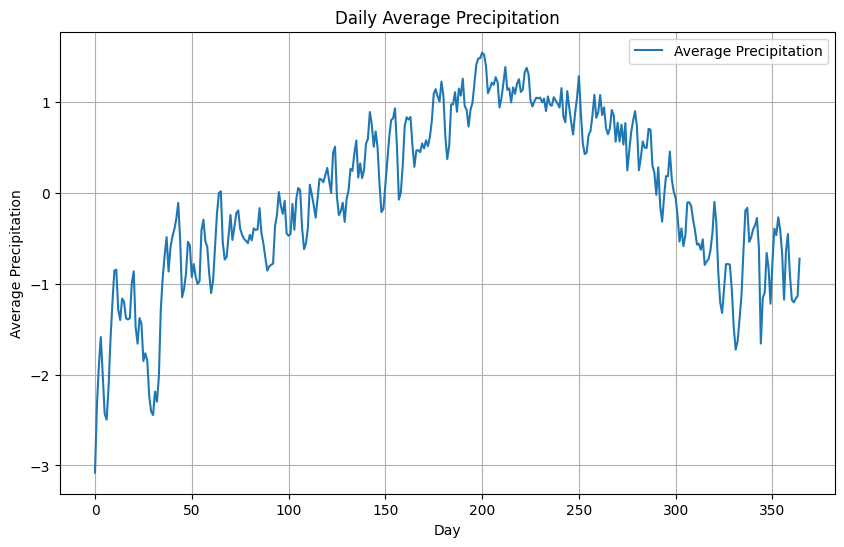

In [ ]:
# Assuming x_train[0] is a NumPy array or similar
data = x_train[0]  # Shape: (365, 11, 20, 3)

# Extract the precipitation channel (channel 1, index 1)
precipitation = data[..., 1]  # Shape: (365, 11, 20)

# Compute the daily average precipitation (mean over the 11x20 grid)
daily_avg_precipitation = np.mean(precipitation, axis=(1, 2))  # Shape: (365,)

# Plot the daily average precipitation
plt.figure(figsize=(10, 6))
plt.plot(daily_avg_precipitation, label='Average Precipitation')
plt.title('Daily Average Precipitation')
plt.xlabel('Day')
plt.ylabel('Average Precipitation')
plt.legend()
plt.grid(True)
plt.show()

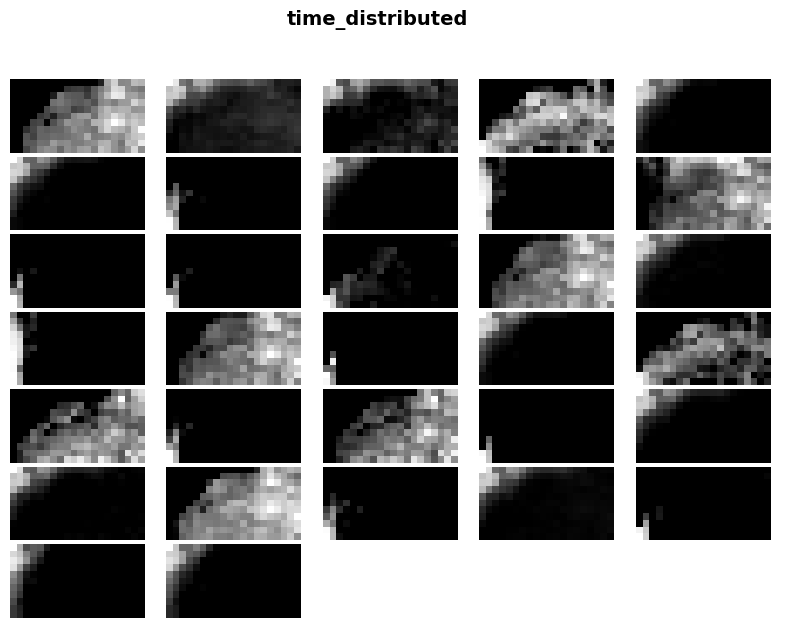

<Figure size 640x480 with 0 Axes>

In [ ]:

layer_index=0  # from 0 (input) to 2
x= x_train[0]
x = np.reshape(x, (1, 365, 11, 20, 3))
layer_outputs = [layer.output for layer in model.layers[:layer_index+1]]


activation_model = Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(x,verbose=0)
num_features = activations[-1].shape[-1]


layer_config = model.layers[layer_index].get_config()
layer_name = layer_config.get("name")

if 'flatten'   in layer_name.lower() or 'dense'  in layer_name.lower():
    x= activations[-1].T
    flattened_image = np.reshape(x,(-1))

    pixel_colors = np.zeros((flattened_image.shape[0], 3))
    for i in range(flattened_image.shape[0]):
        pixel_colors[i] =  pixel_colors[i] = [ flattened_image[i],  flattened_image[i], flattened_image[i]]

    # Display the row of pixels
    fig, ax = plt.subplots(figsize=(10, 1))
    fig.suptitle(layer_name, fontsize=14, fontweight='bold')
    ax.imshow([pixel_colors],aspect='auto')
    ax.set_xlim(0, flattened_image.shape[0])
    ax.set_ylim(0, 1)
    ax.set_axis_off()

    plt.show()
else:

    #activation = np.reshape(activation[-1], (1, 365, 11, 20, -1))
    num_cols = 5
    num_rows =  num_features // num_cols + 1
    fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(10, 7))
    fig.subplots_adjust(wspace=0.05, hspace=0.05)
    fig.suptitle(layer_name, fontsize=14, fontweight='bold')
    for i in range(num_rows):
      for j in range(num_cols):
          if i * num_cols + j < num_features:

              activation =np.reshape(activations[-1],(1,365,11,20,-1))[ 0, 350,:,:, i*num_cols+j]
              ax[i, j].imshow(activation, cmap='gray')
              ax[i, j].axis('off') # Add this line
              #ax[i, j].set_title('Feature {}'.format(i*num_cols+j))
          else:
              ax[i, j].axis('off')
    plt.show()
    plt.tight_layout()


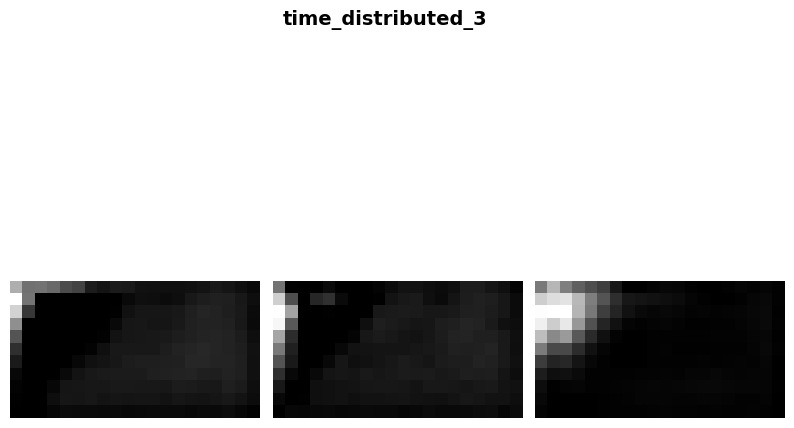

<Figure size 640x480 with 0 Axes>

In [ ]:
# for the last layer
layer_index=3
x= x_train[0]
x = np.reshape(x, (1, 365, 11, 20, 3))


layer_outputs = [layer.output for layer in model.layers[:layer_index+1]]


activation_model = Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(x,verbose=0)
num_features = activations[-1].shape[-1]


layer_config = model.layers[layer_index].get_config()
layer_name = layer_config.get("name")
num_cols = 3
num_rows = 1
fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(10, 7))
fig.subplots_adjust(wspace=0.05, hspace=0.05)
fig.suptitle(layer_name, fontsize=14, fontweight='bold')
for i in range(num_rows):
  for j in range(num_cols):
      if i * num_cols + j < num_features:

          activation =np.reshape(activations[-1],(1,365,11,20,-1))[ 0, 350,:,:,j]
          ax[j].imshow(activation, cmap='gray')
          ax[j].axis('off') # Add this line
          #ax[i, j].set_title('Feature {}'.format(i*num_cols+j))
      else:
          ax[j].axis('off')
plt.show()
plt.tight_layout()

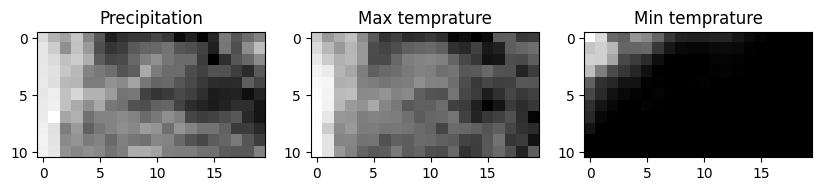

In [ ]:
# visualizing the input frame
x= x_train[0][350]
np.shape(x)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5))

# plot each channel in a different axis with cmap = 'viridis'
ax1.imshow(x[:, :, 0], cmap='gray')
ax2.imshow(x[:, :, 1], cmap='gray')
ax3.imshow(x[:, :, 2], cmap='gray')

# set titles for each axis
ax1.set_title('Precipitation')
ax2.set_title('Max temprature')
ax3.set_title('Min temprature')

# show the plot
plt.show()

# Summary of the performances

In [ ]:
# Read the CSV files into data frames
NSE_CNN_LSTM = pd.read_csv(dir_output + '/' + 'CNN_LSTM/NSE_test_fine.csv', header=None, index_col=False)
NSE_CNN = pd.read_csv(dir_output + '/' + 'CNN_only/NSE_test_fine.csv', header=None)
NSE_LSTM = pd.read_csv(dir_output + '/' + 'LSTM_only_era/NSE_test_fine.csv', header=None)
NSE_ANN = pd.read_csv(dir_output + '/' + 'ANN/NSE_test_fine.csv', header=None)
NSE_LSTM_indv = pd.read_csv(dir_output + '/' + 'LSTM_indv/NSE_test.csv', header=None)

#clustering_lables= load_pickle('clustering_labels.pickle')
cluster = clustering_lables # replace with your actual list
ids = stationIds # replace with your actual list
# Create a list of data frames and column names
dfs = [NSE_CNN_LSTM, NSE_CNN, NSE_LSTM, NSE_ANN, NSE_LSTM_indv]
columns = ['CNN-LSTM', 'CNN-only', 'LSTM-only', 'ANN', 'LSTM_indv']

# Concatenate the data frames into a single data frame
df = pd.concat(dfs, axis=1, keys=columns, ignore_index=False)

# Add the label and id columns
df['label'] = cluster
df['id'] = ids

# titles= ['id','CNN-LSTM', 'CNN-only', 'LSTM-only', 'ANN', 'LSTM_indv', 'label']
# df.columns = titles
# Remove the original numeric index for the columns and set the index of the data frame to the 'id' column
df.columns = df.columns.remove_unused_levels()  # remove the original numeric index
df = df.set_index('id')







In [ ]:
df  # table with the NSE performance for all the stations considered

,CNN-LSTM,CNN-only,LSTM-only,ANN,LSTM_indv,label
,0,0,0,0,0,
id,,,,,,
10396000,0.497303,0.548468,0.588270,-0.824793,0.686034,Continental
12010000,0.652783,0.573470,0.624276,0.017585,0.837904,Coastal-North
12013500,0.656500,0.581563,0.640530,0.107373,0.793209,Coastal-North
12020000,0.558667,0.458586,0.501151,-0.328405,0.707192,Coastal-North
12025000,0.674415,0.612282,0.671425,0.164570,0.751484,Coastal-North
...,...,...,...,...,...,...
14309500,0.601561,0.408179,0.593717,-0.050631,0.626403,Coastal-South
14316700,0.658310,0.492584,0.620945,-0.065404,0.637097,Coastal-South


<ipython-input-52-be4df05da56a>:25: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  mean_values = cluster_df.mean().values
<ipython-input-52-be4df05da56a>:26: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  median_values = cluster_df.median().values
<ipython-input-52-be4df05da56a>:32: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(1, 3, i+1)
<ipython-input-52-be4df05da56a>:25: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will 

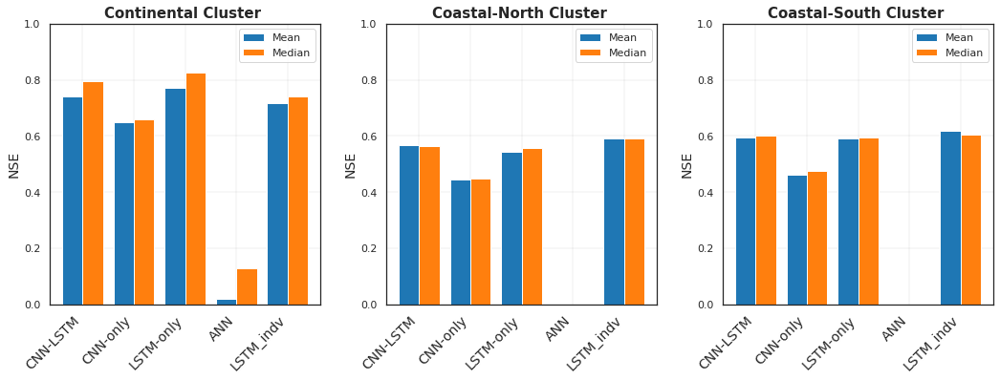

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

saveIt=0
# Define the width of each bar
bar_width = 0.4

# Define the colors for mean and median bars
mean_color = '#1f77b4'  # blue
median_color = '#ff7f0e'  # orange

# Create a list of unique cluster values
clusters = df['label'].unique()

# Set figure size and grid style
plt.figure(figsize=(15, 6))
plt.grid(color='gray', linestyle='-', linewidth=0.25, alpha=0.5)

# Loop through each cluster and create the bar charts
for i, cluster in enumerate(clusters):
    # Filter the dataframe by the current cluster
    cluster_df = df[df['label'] == cluster]

    # Calculate mean and median values for each model
    mean_values = cluster_df.mean().values
    median_values = cluster_df.median().values

    # Create the x-axis positions for the bars
    x_positions = np.arange(len(columns))

    # Create bar chart for both mean and median values
    ax = plt.subplot(1, 3, i+1)
    ax.bar(x_positions - bar_width/2, mean_values, width=bar_width, label='Mean', color=mean_color)
    ax.bar(x_positions + bar_width/2, median_values, width=bar_width, label='Median', color=median_color)
   # ax.set_xlabel('Model',fontsize= 12)
    ax.set_ylabel('NSE',fontsize= 14)
    ax.set_title(f'{cluster} Cluster ', fontweight='bold',fontsize= 15)
    ax.set_xticks(x_positions)
    ax.set_xticklabels(columns, rotation=45, ha='right', fontsize= 14)
    ax.set_ylim(0,1)
    ax.legend()
    ax.grid(color='gray', linestyle='-', linewidth=0.25, alpha=0.5)

# Adjust the spacing between subplots and save the figure
plt.tight_layout(pad=2)
if saveIt:
    plt.savefig(dir_output + '/comparisons/NSE_plot_summary.png', dpi=300)
plt.show()


In [ ]:
# Compute the mean and median NSE values for each model for each cluster
mean_NSE = grouped.mean()[['CNN-LSTM', 'CNN-only', 'LSTM-only', 'ANN', 'LSTM_indv']]
median_NSE = grouped.median()[['CNN-LSTM', 'CNN-only', 'LSTM-only', 'ANN', 'LSTM_indv']]

# Plot the bar chart for the mean and median NSE values
fig, axs = plt.subplots(2, 1, figsize=(10, 8))
mean_NSE.plot.bar(ax=axs[0], rot=0)
axs[0].set_title('Mean NSE values')
axs[0].set_ylabel('NSE')
median_NSE.plot.bar(ax=axs[1], rot=0)
axs[1].set_title('Median NSE values')
axs[1].set_ylabel('NSE')
plt.tight_layout()
plt.show()


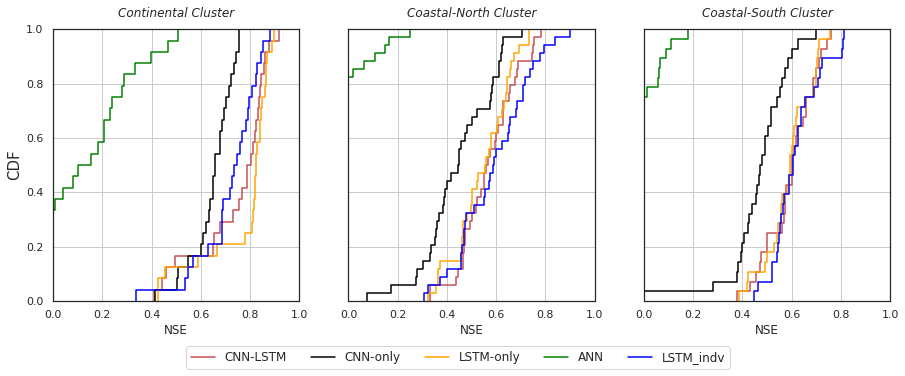

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

saveIt= 0
# Step 1: Subset the original DataFrame into three separate DataFrames, one for each cluster
df_cluster1 = df[df['label'] == 'Continental']
df_cluster2 = df[df['label'] == 'Coastal-North']
df_cluster3 = df[df['label'] == 'Coastal-South']
sns.set(style="white")

# Step 2: Create a list of the five model columns
model_cols = ['CNN-LSTM', 'CNN-only', 'LSTM-only', 'ANN', 'LSTM_indv']
colors=['r','black','orange','green','blue']

# Step 3: Create a figure with three subplots, one for each cluster
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15,5), sharey=True)
#sns_a=[]
# Step 4: Loop through the clusters and plot the CDF for NSE for all models in each subplot
for i, df_cluster in enumerate([df_cluster1, df_cluster2, df_cluster3]):
    plt.sca(axs[i]) # set the current subplot to the i-th subplot
    plt.title(f'{df_cluster.label.unique()[0]} Cluster',pad=12,fontsize=12,fontstyle='oblique')
    plt.xlabel('NSE')
    if i==0:
        plt.ylabel('CDF', fontsize=15)
    for j, col in enumerate(model_cols):
        a = sns.ecdfplot(df_cluster[col], label=col,legend=False)
        #sns_a.append(a)

    for j, col in enumerate(model_cols):# set the colors

        a.lines[j].set_color(colors[j])
    axs[i].set_xlim(0,1)
    axs[i].grid(True)
#axs[i].legend(loc='center left')


# Step 5: Add a global legend to the figure
fig.legend(model_cols, loc='lower center', ncol=len(model_cols), bbox_to_anchor=(0.5, -0.08),fontsize=12)

# Step 6: Set the scientific style for the y-axis
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))

# Step 7: Show the plot
if saveIt:
    plt.savefig(dir_output + '/comparisons/NSE_plot_cdf_percluster.png', dpi=300)
plt.show()


## visualizations for the appendex


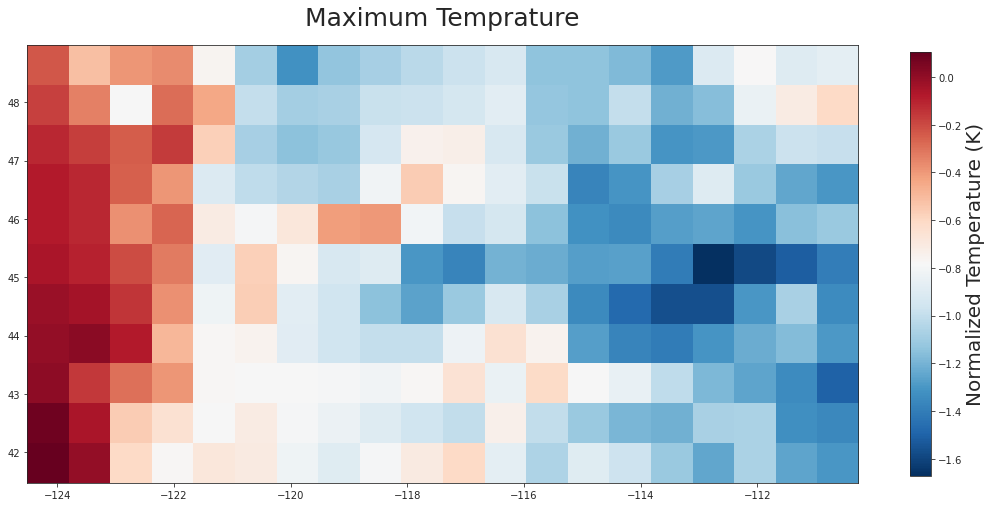

In [ ]:
saveIt=0
fig, ax = plt.subplots(1,1,figsize = (15,15))

#fig.suptitle('Gridded maximum tempratuer data over the study area on 1/1/1980',y=0.1, fontsize=13)

# #plot_prov_ax('17', ax = ax[0])
# im= ax[0].imshow(Tmax[365],  cmap = 'RdBu_r', extent = extentERA)
# cb0 = plt.colorbar(im, ax = ax[0], shrink=0.2)

im= ax.imshow(Tmaxnorm[365],  cmap = 'RdBu_r', extent = extentERA)
cb1 = plt.colorbar(im, ax = ax, shrink=0.4)

plt.tight_layout()

ax.set_title('Maximum Temprature', fontsize=25, pad=20)
cb1.set_label('Normalized Temperature (K)', fontsize = 20)
if saveIt:
 plt.savefig(dir_output+'/comparisons/maxTemp_data_normalization.png',dpi=300)

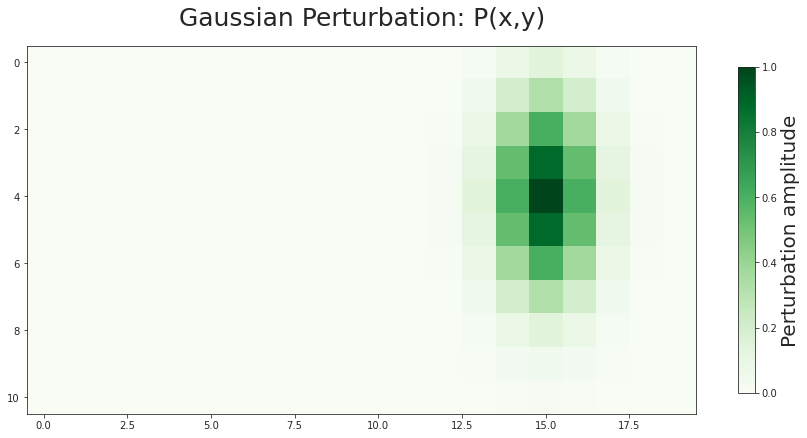

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# define parameters for the Gaussian function
beta = 1.0
x_p, y_p = 15, 4
sigma_x, sigma_y = 1, 2

# create a grid of coordinates
x = np.arange(20)
y = np.arange(11)
X, Y = np.meshgrid(x, y)

# calculate the Gaussian function at each point
Z = beta * np.exp(-0.5 * ((X - x_p)**2 / sigma_x**2 + (Y - y_p)**2 / sigma_y**2))

# plot the result
fig, ax = plt.subplots(1,1,figsize = (15,15))
im = ax.imshow(Z, cmap='Greens')
cb = plt.colorbar(im, ax = ax, shrink=0.4)
cb.set_label('Perturbation amplitude', fontsize = 20)
ax.set_title('Gaussian Perturbation: P(x,y)', fontsize=25, pad=20)
plt.show()

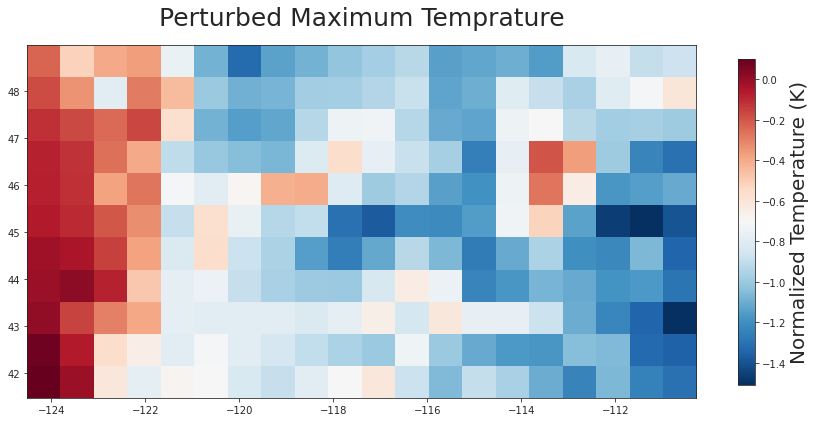

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# Define parameters for the Gaussian function
beta = 1.0
x_p, y_p =15, 4
sigma_x, sigma_y = 1, 2

# Create a grid of coordinates
x = np.arange(20)
y = np.arange(11)
X, Y = np.meshgrid(x, y)

# Calculate the Gaussian function at each point
Z = beta * np.exp(-0.5 * ((X - x_p)**2 / sigma_x**2 + (Y - y_p)**2 / sigma_y**2))

# Add the original temperature data to the perturbation
Z = Z + Tmaxnorm[365]

# Plot the result
fig, ax = plt.subplots(1,1,figsize = (15,15))
im = ax.imshow(Z, cmap='RdBu_r', extent = extentERA)
cb = plt.colorbar(im, ax = ax, shrink=0.4)
cb.set_label('Normalized Temperature (K)', fontsize = 20)
ax.set_title('Perturbed Maximum Temprature', fontsize=25, pad=20)

plt.show()

## visualizing predictions for different models

In [ ]:
predict_CNN_LSTM = np.array(pd.read_csv(dir_output + '/' + 'CNN_LSTM/y_test_fine_predict_0.csv', header=None))
predict_CNN = np.array(pd.read_csv(dir_output + '/' + 'CNN_only/y_test_fine_predict_0.csv', header=None))
predict_LSTM = np.array(pd.read_csv(dir_output + '/' + 'LSTM_only/y_test_fine_predict_0.csv', header=None))
predict_LSTM_indv = np.array(pd.read_csv(dir_output + '/' + 'LSTM_indv/y_test_bulk_predict_48.csv', header=None))

In [ ]:
np.shape(predict_LSTM_indv[:])

(1461, 1)

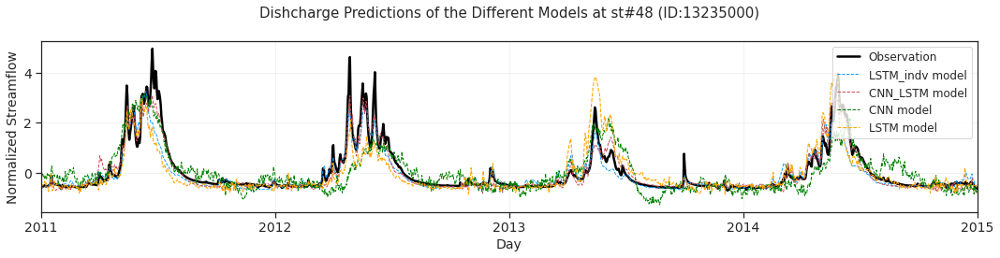

In [ ]:
saveIt=0
inds= 48
fs=15
fig, ax = plt.subplots(figsize = (15,4))
#days = range(365, 365*2)
days = range(Ntest)
#days = range(365,365*2)

c=['#0096FF','r','green','orange','r']
ax.plot(days, y_test[:,inds], label = 'Observation', color = 'black', linewidth = 2.5)

ax.legend(fontsize = fs-4)

first_days_of_year= np.array([i*365 for i in range(0,5)])
first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336])+365 #day-of-year of the first day of each month
year_str= [2011,2012,2013,2014,2015]

months_str = ['Jan 2012', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec 2013']

to_plot= [ predict_LSTM_indv, predict_CNN_LSTM,  predict_CNN, predict_LSTM]
to_plot_name = [ "LSTM_indv","CNN_LSTM" ,"CNN", "LSTM"]
for i,y_model in enumerate( to_plot):



      rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

      fs = 16 #fontsize


      if i == 0:
        ax.plot(days,y_model, label = '{} model'.format(to_plot_name[i]), color = c[i], linewidth = 0.9*np.exp(i/18),ls='--')
      else:
          ax.plot(days,y_model[:,inds], label = '{} model'.format(to_plot_name[i]), color = c[i], linewidth = 0.9*np.exp(i/18),ls='--')

      ax.set_ylabel('Normalized Streamflow', fontsize = fs-2)
      ax.set_xlabel('Day', fontsize = fs-2)

      ax.set_title('Dishcharge Predictions of the Different Models at st#48 (ID:{})'.format(stationIds[inds]), fontsize=15,pad=25)

      ax.set_xticks(first_days_of_year)
      ax.set_xlim((0,365*4))
      ax.set_xticklabels(year_str, rotation = 0)#, ha = 'right')
      ax.tick_params(labelsize = fs-2)
      ax.legend(fontsize = fs-4, loc=1)
      #ax.text(x = -0.05, y = 1.1, s = '(a)', transform = ax.transAxes, fontsize = fs-2)
      ax.grid(True, alpha = 0.25)



      fig.tight_layout()
if saveIt:
   plt.savefig(dir_output+'/comparisons/models_predictions_testing.png',dpi=300)

#plt.plot(y_test[])

In [ ]:
np.shape(y_test)

TensorShape([1461, 86])

In [ ]:
nse(predict_CNN_LSTM[:,48], y_test[:,48])

0.902714233587498

In [ ]:
saveIt=0
inds= 48
fs=15
fig, ax = plt.subplots(figsize = (9,4))
#days = range(365, 365*2)
days = range(365,365*2)
#days = range(365,365*2)

c=['#0096FF','r','green','orange','r']
ax.plot(days, y_test[365:365*2,inds], label = 'Observation', color = 'black', linewidth = 2.5)

first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336])+365 #day-of-year of the first day of each month

ax.legend(fontsize = fs-4)

#first_days_of_year= np.array([i*365 for i in range(0,5)])
#first_days_of_month = np.array([1,32,61,92,122,153,183,214,245,275,306,336])+365 #day-of-year of the first day of each month
#year_str= [2011,2012,2013,2014,2015]

months_str = ['Jan 2012', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec 2013']

to_plot= [ predict_LSTM_indv, predict_CNN_LSTM,  predict_CNN, predict_LSTM]
to_plot_name = [ "LSTM_indv","CNN_LSTM" ,"CNN", "LSTM"]
for i,y_model in enumerate( to_plot):



      rgb = '#1f77b4' #colour for shading that I like (picked from coolors.co)

      fs = 16 #fontsize


      if i == 0:
        ax.plot(days,y_model[365:365*2], label = '{} model'.format(to_plot_name[i]), color = c[i], linewidth = 0.9*np.exp(i/18),ls='--')
      else:
          ax.plot(days,y_model[365:365*2,inds], label = '{} model'.format(to_plot_name[i]), color = c[i], linewidth = 0.9*np.exp(i/18),ls='--')

      ax.set_ylabel('Normalized Streamflow', fontsize = fs-5)
      ax.set_xlabel('Day', fontsize = fs-2)

      #ax.set_title('Station {} (St ID:'.format(inds)+str(stationIDs[inds])+')' +'\nNSE = ' + str(np.round(NSE_bulk[inds], decimals = 2)), fontsize = fs-2)
      ax.set_xticks(first_days_of_month)
      ax.set_xlim((365,365*2))
      ax.set_xticklabels(months_str, rotation = 45)#, ha = 'right')
      ax.tick_params(labelsize = fs-2)
      ax.legend(fontsize = fs-4)
      #ax.text(x = -0.05, y = 1.1, s = '(a)', transform = ax.transAxes, fontsize = fs-2)
      ax.grid(True, alpha = 0.25)
      ax.set_title('Dishcharge Predictions of the Different Models at st#{} (ID:{})'.format(inds,stationIds[inds]), fontsize=15,pad=25)


      fig.tight_layout()
if saveIt:
  plt.savefig(dir_output+'/comparisons/models_predictions_2013.png',dpi=300)

#plt.plot(y_test[])

In [ ]:
filename_indv = 'LSTM_indv/NSE_test' + '.csv'


NSE_bench = np.asarray(pd.read_csv(dir_output + '/' + filename_indv, header = None))


In [ ]:
np.reshape(NSE_bench,(1,-1))[:,unseen_stations]

array([[0.75148435, 0.76921032, 0.5698398 , 0.79786237, 0.55886723,
        0.65011184, 0.6870069 , 0.59282297, 0.47005112, 0.72742149]])

In [ ]:
np.array(stationIds)[unseen_stations]

array([12025000, 12390700, 12411000, 12414500, 14182500, 14236200,
       13331500, 12144000, 12147500, 12358500])